# **<span style="color:purple;"> Lending Club Case Study </span>**
####  **<span style="color:SteelBlue;">Student/Group Facilitator Name: </span>** Deepesh Ramachandran Vijayalekshmi



## Problem Statement

#### Business Understanding
You work for a consumer finance company which specialises in lending various types of loans to urban customers. When the company receives a loan application, the company has to make a decision for loan approval based on the applicant’s profile. Two types of risks are associated with the bank’s decision:

If the applicant is likely to repay the loan, then not approving the loan results in a loss of business to the company

If the applicant is not likely to repay the loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss for the company

 

The data given below contains information about past loan applicants and whether they ‘defaulted’ or not. The aim is to identify patterns which indicate if a person is likely to default, which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc.

#### Business Objectives

This company is the largest online loan marketplace, facilitating personal loans, business loans, and financing of medical procedures. Borrowers can easily access lower interest rate loans through a fast online interface. 

Like most other lending companies, lending loans to ‘risky’ applicants is the largest source of financial loss (called credit loss). Credit loss is the amount of money lost by the lender when the borrower refuses to pay or runs away with the money owed. In other words, borrowers who default cause the largest amount of loss to the lenders. In this case, the customers labelled as 'charged-off' are the 'defaulters'. 

If one is able to identify these risky loan applicants, then such loans can be reduced thereby cutting down the amount of credit loss. Identification of such applicants using EDA is the aim of this case study.

In other words, the company wants to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default.  The company can utilise this knowledge for its portfolio and risk assessment. 

To develop your understanding of the domain, you are advised to independently research a little about risk analytics (understanding the types of variables and their significance should be enough).



## Import libraries and initialize settings

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
import seaborn as sns
import plotly.express as px
import itertools

# Ignore Warnings
import warnings #warning
warnings.filterwarnings('ignore')

# Set options in pandas
pd.set_option('display.max_columns', None)  # Set option to see all columns
pd.set_option('display.max_rows', None)

# Set display limits of dataframe to see all columns
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
# pd.set_option('display.max_colwidth', None)

# Seaborn style settings
# Set the global palette
sns.set_palette("pastel")
sns.set_theme(style="darkgrid", palette="pastel")
sns.set_style("darkgrid", {'axes.grid' : False})


## Load and understand the dataset 

In [2]:
# Load the dataset
loan_df = pd.read_csv("loan.csv")
loan_df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [3]:
# Load the data dictionary for reference
loan_dd = pd.read_excel('Data_Dictionary.xlsx')

In [4]:
loan_dd.head()

,LoanStatNew,Description
0,acc_now_delinq,The number of accounts on which the borrower i...
1,acc_open_past_24mths,Number of trades opened in past 24 months.
2,addr_state,The state provided by the borrower in the loan...
3,all_util,Balance to credit limit on all trades
4,annual_inc,The self-reported annual income provided by th...


#### Utility function to get the data description

In [5]:
# Function specific to the data dictionary given, to return the description of a column name
def get_data_dictionary_description(col_name):
    return loan_dd.loc[loan_dd['LoanStatNew'] == col_name, 'Description'].values[0]

In [6]:
# Check if headers are correctly identified by pandas in the dataframe
# Have a quick overall view of the dataset

In [7]:
loan_df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [8]:
loan_df.tail()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
39712,92187,92174,2500,2500,1075.0,36 months,8.07%,78.42,A,A4,FiSite Research,4 years,MORTGAGE,110000.0,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Our current gutter system on our home is old a...,home_improvement,Home Improvement,802xx,CO,11.33,0,Nov-90,0,0.0,0.0,13,0,7274,13.10%,40,f,0.0,0.0,2822.969293,1213.88,2500.0,322.97,0.0,0.0,0.0,Jul-10,80.90,NaN,Jun-10,NaN,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39713,90665,90607,8500,8500,875.0,36 months,10.28%,275.38,C,C1,"Squarewave Solutions, Ltd.",3 years,RENT,18000.0,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,The rate of interest and fees incurred by carr...,credit_card,Retiring credit card debt,274xx,NC,6.40,1,Dec-86,1,5.0,0.0,6,0,8847,26.90%,9,f,0.0,0.0,9913.491822,1020.51,8500.0,1413.49,0.0,0.0,0.0,Jul-10,281.94,NaN,Jul-10,NaN,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39714,90395,90390,5000,5000,1325.0,36 months,8.07%,156.84,A,A4,NaN,< 1 year,MORTGAGE,100000.0,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,debt_consolidation,MBA Loan Consolidation,017xx,MA,2.30,0,Oct-98,0,0.0,0.0,11,0,9698,19.40%,20,f,0.0,0.0,5272.161128,1397.12,5000.0,272.16,0.0,0.0,0.0,Apr-08,0.00,NaN,Jun-07,NaN,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39715,90376,89243,5000,5000,650.0,36 months,7.43%,155.38,A,A2,NaN,< 1 year,MORTGAGE,200000.0,Not Verified,Jul-07,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,other,JAL Loan,208xx,MD,3.72,0,Nov-88,0,0.0,0.0,17,0,85607,0.70%,26,f,0.0,0.0,5174.198551,672.66,5000.0,174.20,0.0,0.0,0.0,Jan-08,0.00,NaN,Jun-07,NaN,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [9]:
# Dataset has headers and are correctly identified in the dataframe

In [10]:
# Know the size and shape of the dataset
loan_df.shape

(39717, 111)

In [11]:
# Show info to see the types and range
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


In [12]:
loan_df['loan_status'].value_counts()

loan_status
Fully Paid     32950
Charged Off     5627
Current         1140
Name: count, dtype: int64

In [13]:
# See the column names
loan_df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade',
       ...
       'num_tl_90g_dpd_24m', 'num_tl_op_past_12m', 'pct_tl_nvr_dlq',
       'percent_bc_gt_75', 'pub_rec_bankruptcies', 'tax_liens',
       'tot_hi_cred_lim', 'total_bal_ex_mort', 'total_bc_limit',
       'total_il_high_credit_limit'],
      dtype='object', length=111)

In [14]:
# Print all the column names
for col in loan_df.columns:
    print(col)

id
member_id
loan_amnt
funded_amnt
funded_amnt_inv
term
int_rate
installment
grade
sub_grade
emp_title
emp_length
home_ownership
annual_inc
verification_status
issue_d
loan_status
pymnt_plan
url
desc
purpose
title
zip_code
addr_state
dti
delinq_2yrs
earliest_cr_line
inq_last_6mths
mths_since_last_delinq
mths_since_last_record
open_acc
pub_rec
revol_bal
revol_util
total_acc
initial_list_status
out_prncp
out_prncp_inv
total_pymnt
total_pymnt_inv
total_rec_prncp
total_rec_int
total_rec_late_fee
recoveries
collection_recovery_fee
last_pymnt_d
last_pymnt_amnt
next_pymnt_d
last_credit_pull_d
collections_12_mths_ex_med
mths_since_last_major_derog
policy_code
application_type
annual_inc_joint
dti_joint
verification_status_joint
acc_now_delinq
tot_coll_amt
tot_cur_bal
open_acc_6m
open_il_6m
open_il_12m
open_il_24m
mths_since_rcnt_il
total_bal_il
il_util
open_rv_12m
open_rv_24m
max_bal_bc
all_util
total_rev_hi_lim
inq_fi
total_cu_tl
inq_last_12m
acc_open_past_24mths
avg_cur_bal
bc_open_to_buy
bc

In [15]:
# There are 111 columns, and many of them are object types. The data could be numeric types or date types and are wrongly treated as objects. 
# Type conversion may be needed to cleanup


In [16]:
# Summary statistics

loan_df.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
count,3.971700e+04,3.971700e+04,39717.000000,39717.000000,39717.000000,39717.000000,3.971700e+04,39717.000000,39717.000000,39717.000000,14035.000000,2786.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39661.0,0.0,39717.0,0.0,0.0,0.0,39717.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39661.0,39717.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39020.000000,39678.0,0.0,0.0,0.0,0.0
mean,6.831319e+05,8.504636e+05,11219.443815,10947.713196,10397.448868,324.561922,6.896893e+04,13.315130,0.146512,0.869200,35.900962,69.698134,9.294408,0.055065,13382.528086,22.088828,51.227887,50.989768,12153.596544,11567.149118,9793.348813,2263.663172,1.363015,95.221624,12.406112,2678.826162,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043260,0.0,NaN,NaN,NaN,NaN
std,2.106941e+05,2.656783e+05,7456.670694,7187.238670,7128.450439,208.874874,6.379377e+04,6.678594,0.491812,1.070219,22.020060,43.822529,4.400282,0.237200,15885.016641,11.401709,375.172839,373.824457,9042.040766,8942.672613,7065.522127,2608.111964,7.289979,688.744771,148.671593,4447.136012,0.0,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.204324,0.0,NaN,NaN,NaN,NaN
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.0,NaN,NaN,NaN,NaN
25%,5.162210e+05,6.667800e+05,5500.000000,5400.000000,5000.000000,167.020000,4.040400e+04,8.170000,0.000000,0.000000,18.000000,22.000000,6.000000,0.000000,3703.000000,13.000000,0.000000,0.000000,5576.930000,5112.310000,4600.000000,662.180000,0.000000,0.000000,0.000000,218.680000,0.0,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [17]:
# There are a lot of NaN values in many columns (Scroll to the right to see all columns). Check for missing values during cleanup


---

## Data Preparation - Cleansing/Transformation

#### Check duplicate rows

In [18]:
# Count the number of duplicated rows in the DataFrame
duplicated_count = loan_df.duplicated().sum()
print(f"Number of duplicated rows: {duplicated_count}")

Number of duplicated rows: 0


In [19]:
# There are no duplicated rows


####  Identify columns with missing values

In [20]:
missing_values_in_columns = loan_df.isnull().sum()
print(missing_values_in_columns)

id                                0
member_id                         0
loan_amnt                         0
funded_amnt                       0
funded_amnt_inv                   0
                              ...  
tax_liens                        39
tot_hi_cred_lim               39717
total_bal_ex_mort             39717
total_bc_limit                39717
total_il_high_credit_limit    39717
Length: 111, dtype: int64


In [21]:
# Filter the columns with missing values

columns_with_missing_values = missing_values_in_columns[missing_values_in_columns>0]
print("Columns with missing Values:")
print(columns_with_missing_values)

Columns with missing Values:
emp_title                          2459
emp_length                         1075
desc                              12942
title                                11
mths_since_last_delinq            25682
mths_since_last_record            36931
revol_util                           50
last_pymnt_d                         71
next_pymnt_d                      38577
last_credit_pull_d                    2
collections_12_mths_ex_med           56
mths_since_last_major_derog       39717
annual_inc_joint                  39717
dti_joint                         39717
verification_status_joint         39717
tot_coll_amt                      39717
tot_cur_bal                       39717
open_acc_6m                       39717
open_il_6m                        39717
open_il_12m                       39717
open_il_24m                       39717
mths_since_rcnt_il                39717
total_bal_il                      39717
il_util                           39717
open_rv_12m

In [22]:
missing_values_percentage_in_columns = (columns_with_missing_values / len(loan_df)) * 100
print("Percentage of Missing Values:")
print(missing_values_percentage_in_columns)

Percentage of Missing Values:
emp_title                           6.191303
emp_length                          2.706650
desc                               32.585543
title                               0.027696
mths_since_last_delinq             64.662487
mths_since_last_record             92.985372
revol_util                          0.125891
last_pymnt_d                        0.178765
next_pymnt_d                       97.129693
last_credit_pull_d                  0.005036
collections_12_mths_ex_med          0.140998
mths_since_last_major_derog       100.000000
annual_inc_joint                  100.000000
dti_joint                         100.000000
verification_status_joint         100.000000
tot_coll_amt                      100.000000
tot_cur_bal                       100.000000
open_acc_6m                       100.000000
open_il_6m                        100.000000
open_il_12m                       100.000000
open_il_24m                       100.000000
mths_since_rcnt_il       

In [23]:
# There are columns with 100% missing values. These columns would be having all null or NaN values. 
# The columns with 100% missing values can be removed. 
# For other columns, a good strategy is to remove columns with more than 50% missing values.


In [24]:
# See the columns with 100% missing values
columns_with_all_values_missing = columns_with_missing_values[round(missing_values_percentage_in_columns) == 100]
columns_with_all_values_missing

mths_since_last_major_derog       39717
annual_inc_joint                  39717
dti_joint                         39717
verification_status_joint         39717
tot_coll_amt                      39717
tot_cur_bal                       39717
open_acc_6m                       39717
open_il_6m                        39717
open_il_12m                       39717
open_il_24m                       39717
mths_since_rcnt_il                39717
total_bal_il                      39717
il_util                           39717
open_rv_12m                       39717
open_rv_24m                       39717
max_bal_bc                        39717
all_util                          39717
total_rev_hi_lim                  39717
inq_fi                            39717
total_cu_tl                       39717
inq_last_12m                      39717
acc_open_past_24mths              39717
avg_cur_bal                       39717
bc_open_to_buy                    39717
bc_util                           39717


In [25]:
# Count of 100% missing columns
columns_with_all_values_missing.count()

54

In [26]:
# See the columns with more than 50% missing values

columns_above_50_percent_values_missing = columns_with_missing_values[(round(missing_values_percentage_in_columns) > 50) & (round(missing_values_percentage_in_columns) < 100)]
columns_above_50_percent_values_missing

mths_since_last_delinq    25682
mths_since_last_record    36931
next_pymnt_d              38577
dtype: int64

In [27]:
# Count of columns with more than 50% missing values and less than 100%
columns_above_50_percent_values_missing.count()


3

### Drop the columns with missing values

##### Helper functions

In [28]:
# We might need to check the number of missing value columns repeatedly, hence create required helper functions

# Function to get the number of columns in a DataFrame with missing values 
# that exceed a given threshold percentage
def get_missing_column_number(df, threshold):
    # Identify columns with missing values
    columns_with_missing_values = df.isnull().sum()
    
    # Filter only columns with missing values greater than 0
    columns_with_missing_values = columns_with_missing_values[columns_with_missing_values > 0]
    
    # Calculate the percentage of missing values for each column
    missing_values_percentage_in_columns = (columns_with_missing_values / len(df)) * 100
    
    # Count and return the number of columns whose missing percentage matches the given threshold
    return len(columns_with_missing_values[round(missing_values_percentage_in_columns) >= threshold])

    
# Function to get the percentage of missing values in a column
def percentage_missing(column_name):
    return round((missing_values_in_columns.sort_values(ascending=False)[column_name]/len(loan_df)*100),2)

# Function to the count of missing values in a column
def count_missing(column_name):
    return missing_values_in_columns.sort_values(ascending=False)[column_name]

# Function to show the list of columns with missing values in sorted order
def show_sorted_missing_value_columns(df):
    missing_values_in_columns = df.isnull().sum()
    return missing_values_in_columns.sort_values(ascending=False)

In [29]:
# Drop columns with 100% missing values, or having all NaN/Null values
loan_df = loan_df.dropna(axis=1, how='all')

In [30]:
loan_df.shape

(39717, 57)

In [31]:
# Check if all columns with 100% missing values were removed
get_missing_column_number(loan_df,100)

0

In [32]:
# All columns with 100% missing values have been removed.  
# 54 columns have been removed from 111 columns resulting in 57 columns now


In [33]:
# Drop columns with more than 50% missing values

# Get the value of 50% from the number of rows
threshold = 0.5 * len(loan_df)

# Remove the columns
loan_df = loan_df.dropna(thresh=threshold, axis=1)


In [34]:
# Check the shape again to see if columns have been removed
loan_df.shape

(39717, 54)

In [35]:
# Three more columns have been removed resulting in 54 columns


In [36]:
# Check if all columns with more than 50%  were removed
get_missing_column_number(loan_df,50)

0

### Remove irrelevant columns

In [37]:
# Read the data dictionary to understand other columns that can be removed. (Reading the data dictionary file in excel or google sheets would be easier)
loan_dd.head()


,LoanStatNew,Description
0,acc_now_delinq,The number of accounts on which the borrower i...
1,acc_open_past_24mths,Number of trades opened in past 24 months.
2,addr_state,The state provided by the borrower in the loan...
3,all_util,Balance to credit limit on all trades
4,annual_inc,The self-reported annual income provided by th...


##### Below columns are post loan data, that will not be available for new applications to assess the risk. Hence these can be removed.

| Column Name              | Justification                                                                 |
|--------------------------|-------------------------------------------------------------------------------|
| delinq_2yrs              | Customer behavior post-loan approval (not available during application).      |
| earliest_cr_line         | Customer behavior post-loan approval (not available during application).      |
| inq_last_6mths           | Customer behavior post-loan approval (not available during application).      |
| open_acc                 | Customer behavior post-loan approval (not available during application).      |
| pub_rec                  | Customer behavior post-loan approval (not available during application).      |
| revol_bal                | Customer behavior post-loan approval (not available during application).      |
| revol_util               | Customer behavior post-loan approval (not available during application).      |
| total_acc                | Customer behavior post-loan approval (not available during application).      |
| out_prncp                | Calculated after loan approval, does not reflect loan application data.      |
| out_prncp_inv            | Calculated after loan approval, does not reflect loan application data.      |
| total_pymnt              | Customer behavior post-loan approval (not available during application).      |
| total_pymnt_inv          | Customer behavior post-loan approval (not available during application).      |
| total_rec_prncp          | Customer behavior post-loan approval (not available during application).      |
| total_rec_int            | Customer behavior post-loan approval (not available during application).      |
| total_rec_late_fee       | Customer behavior post-loan approval (not available during application).      |
| recoveries               | Customer behavior post-loan approval (not available during application).      |
| collection_recovery_fee  | Customer behavior post-loan approval (not available during application).      |
| last_pymnt_d             | Customer behavior post-loan approval (not available during application).      |
| last_pymnt_amnt          | Customer behavior post-loan approval (not available during application).      |
| last_credit_pull_d       | Customer behavior post-loan approval (not available during application).      |
| title                    | Non-significant for analysis, random variable with no direct impact.          |
| emp_title                | Non-significant for analysis, random variable with no direct impact.          |
| desc                     | Non-significant for analysis, random variable with no direct impact.          |
| url                      | Non-significant for analysis, random variable with no direct impact.          |
| zip_code                 | Masked data, cannot be used for analysis or model training.                   |
| member_id                | Duplicate index column, not necessary for analysis.                           |
| funded_amnt_inv          | Internal data available post-loan approval, not available during application. |
| id                       |Unique identifier, unnecessary for analysis                                    |


In [38]:
# Removing columns based on the justifications provided earlier
loan_df = loan_df.drop([
    'id', 'delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 'open_acc', 
    'pub_rec', 'revol_bal', 'revol_util', 'total_acc', 'out_prncp', 'out_prncp_inv', 
    'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int', 'total_rec_late_fee', 
    'recoveries', 'collection_recovery_fee', 'last_pymnt_d', 'last_pymnt_amnt', 'last_credit_pull_d', 
    'title', 'emp_title', 'desc', 'url', 'zip_code', 'member_id', 'funded_amnt_inv'], axis=1)


In [39]:
# Check the shape of the dataframe after removing the columns
loan_df.shape

(39717, 26)

#### Go through each column with further missing values and take action

In [40]:
# Check again for remaining missing values
show_sorted_missing_value_columns(loan_df)

emp_length                    1075
pub_rec_bankruptcies           697
chargeoff_within_12_mths        56
collections_12_mths_ex_med      56
tax_liens                       39
purpose                          0
delinq_amnt                      0
acc_now_delinq                   0
application_type                 0
policy_code                      0
initial_list_status              0
dti                              0
addr_state                       0
loan_amnt                        0
funded_amnt                      0
loan_status                      0
issue_d                          0
verification_status              0
annual_inc                       0
home_ownership                   0
sub_grade                        0
grade                            0
installment                      0
int_rate                         0
term                             0
pymnt_plan                       0
dtype: int64

---

#### Analyze emp_length column

In [41]:
percentage_missing('emp_length')

2.71

In [42]:
count_missing('emp_length')

1075

In [43]:
get_data_dictionary_description('emp_length')

'Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years. '

> ***emp_length*** is the employment length in years. Could be good indicator of job stability and is a good factor in assessing loan repayment ability.
2.71 is a low percentage of data missing, so this could be imputed with median as it is less sensitive to outliers.

In [44]:
# Before imputing, check the data type and convert if needed

In [45]:
loan_df['emp_length'].dtype

dtype('O')

In [46]:
# It is an object type, check what types of values are in there.

In [47]:
loan_df['emp_length'].value_counts(dropna=False)

emp_length
10+ years    8879
< 1 year     4583
2 years      4388
3 years      4095
4 years      3436
5 years      3282
1 year       3240
6 years      2229
7 years      1773
8 years      1479
9 years      1258
NaN          1075
Name: count, dtype: int64

In [48]:
# The values are numeric, so update the datatype as numeric

In [49]:
# Define a mapping for specific cases
# Need to handle 10+ and <1 separately here, let 10+ be set as 10 and <1 be set as 0

# Set 10 and 0 as string here,  dtype to numeric conversion is done later together
mapping = {
    "10+ years": '10', 
    "< 1 year": '0',
}

# Replace mapped values
loan_df['emp_length'] = loan_df['emp_length'].replace(mapping)

# Extract numeric values for the rest
loan_df['emp_length'] = loan_df['emp_length'].str.extract(r'(\d+)').astype(float)


In [50]:
# Impute missing values with the median
loan_df['emp_length'] = loan_df['emp_length'].fillna(loan_df['emp_length'].median())


In [51]:
# Check the values again
loan_df['emp_length'].value_counts(dropna=False)

emp_length
10.0    8879
0.0     4583
4.0     4511
2.0     4388
3.0     4095
5.0     3282
1.0     3240
6.0     2229
7.0     1773
8.0     1479
9.0     1258
Name: count, dtype: int64

---

In [52]:
# Check the remaining missing values
show_sorted_missing_value_columns(loan_df)

pub_rec_bankruptcies          697
chargeoff_within_12_mths       56
collections_12_mths_ex_med     56
tax_liens                      39
funded_amnt                     0
delinq_amnt                     0
acc_now_delinq                  0
application_type                0
policy_code                     0
initial_list_status             0
dti                             0
addr_state                      0
purpose                         0
loan_amnt                       0
loan_status                     0
issue_d                         0
verification_status             0
annual_inc                      0
home_ownership                  0
emp_length                      0
sub_grade                       0
grade                           0
installment                     0
int_rate                        0
term                            0
pymnt_plan                      0
dtype: int64

***

#### Analyze pub_rec_bankruptcies

In [53]:
percentage_missing('pub_rec_bankruptcies')

1.75

In [54]:
loan_df['pub_rec_bankruptcies'].value_counts(dropna=False)

pub_rec_bankruptcies
0.0    37339
1.0     1674
NaN      697
2.0        7
Name: count, dtype: int64

In [55]:
get_data_dictionary_description('pub_rec_bankruptcies')

'Number of public record bankruptcies'

> ***pub_rec_bankruptcies*** column has the number of public bankruptcies a borrower has filed. Imputing with mode blindly may not be correct here. But in this case the mode is 0 which means no bankruptsy was filed. We can assume that missing values may most probably be cases where bankruptsy was not filed and impute the missing values with 0.

In [56]:
# Impute missing values with the mode (most frequent value)
loan_df['pub_rec_bankruptcies'] = loan_df['pub_rec_bankruptcies'].fillna(loan_df['pub_rec_bankruptcies'].mode()[0])

---

In [57]:
# Check the remaining missing values
show_sorted_missing_value_columns(loan_df)

chargeoff_within_12_mths      56
collections_12_mths_ex_med    56
tax_liens                     39
funded_amnt                    0
pub_rec_bankruptcies           0
delinq_amnt                    0
acc_now_delinq                 0
application_type               0
policy_code                    0
initial_list_status            0
dti                            0
addr_state                     0
purpose                        0
loan_amnt                      0
loan_status                    0
issue_d                        0
verification_status            0
annual_inc                     0
home_ownership                 0
emp_length                     0
sub_grade                      0
grade                          0
installment                    0
int_rate                       0
term                           0
pymnt_plan                     0
dtype: int64

---

#### Analyze chargeoff_within_12_mths

In [58]:
loan_df['chargeoff_within_12_mths'].value_counts()

chargeoff_within_12_mths
0.0    39661
Name: count, dtype: int64

In [59]:
loan_df['chargeoff_within_12_mths'].isna().sum()

56

In [60]:
percentage_missing('chargeoff_within_12_mths')

0.14

In [61]:
get_data_dictionary_description('chargeoff_within_12_mths')

'Number of charge-offs within 12 months'

> ***chargeoff_within_12_mths*** is the number of charge-offs within the last 12 months. All of the data is zero with 0.14% missing values. Assuming the missed values would be zero, impute missing values with zero.

In [62]:
loan_df['chargeoff_within_12_mths'].fillna(0, inplace=True)

In [63]:
loan_df['chargeoff_within_12_mths'].value_counts(dropna=False)

chargeoff_within_12_mths
0.0    39717
Name: count, dtype: int64

In [64]:
loan_df['chargeoff_within_12_mths'].isna().sum()

0

---

In [65]:
# Check the remaining missing values
show_sorted_missing_value_columns(loan_df)

collections_12_mths_ex_med    56
tax_liens                     39
funded_amnt                    0
pub_rec_bankruptcies           0
delinq_amnt                    0
chargeoff_within_12_mths       0
acc_now_delinq                 0
application_type               0
policy_code                    0
initial_list_status            0
dti                            0
addr_state                     0
purpose                        0
loan_amnt                      0
loan_status                    0
issue_d                        0
verification_status            0
annual_inc                     0
home_ownership                 0
emp_length                     0
sub_grade                      0
grade                          0
installment                    0
int_rate                       0
term                           0
pymnt_plan                     0
dtype: int64

---

#### Analyze collections_12_mths_ex_med

In [66]:
loan_df['collections_12_mths_ex_med'].value_counts(dropna=False)

collections_12_mths_ex_med
0.0    39661
NaN       56
Name: count, dtype: int64

In [67]:
get_data_dictionary_description('collections_12_mths_ex_med')

'Number of collections in 12 months excluding medical collections'

> ***collections_12_mths_ex_med*** is the number of collections within 12 months excluding medical collections. 
This is also similar to the previous one. All of the values are same, zero. Missing values can be imputed with 0.

In [68]:
loan_df['collections_12_mths_ex_med'].fillna(0, inplace=True)

In [69]:
loan_df['collections_12_mths_ex_med'].value_counts(dropna=False)

collections_12_mths_ex_med
0.0    39717
Name: count, dtype: int64

In [70]:
# Check the remaining missing values
show_sorted_missing_value_columns(loan_df)

tax_liens                     39
funded_amnt                    0
pub_rec_bankruptcies           0
delinq_amnt                    0
chargeoff_within_12_mths       0
acc_now_delinq                 0
application_type               0
policy_code                    0
collections_12_mths_ex_med     0
initial_list_status            0
dti                            0
addr_state                     0
purpose                        0
loan_amnt                      0
loan_status                    0
issue_d                        0
verification_status            0
annual_inc                     0
home_ownership                 0
emp_length                     0
sub_grade                      0
grade                          0
installment                    0
int_rate                       0
term                           0
pymnt_plan                     0
dtype: int64

---

#### Analyze tax_liens

In [71]:
# Handle next column with missing values - tax_liens

In [72]:
loan_df['tax_liens'].value_counts(dropna=False)

tax_liens
0.0    39678
NaN       39
Name: count, dtype: int64

In [73]:
get_data_dictionary_description('tax_liens')

'Number of tax liens'

> ***tax_liens*** - number of tax liens.
All of the available values are zero. So, impute the missing values with zero

In [74]:
loan_df['tax_liens'].fillna(0, inplace=True)


In [75]:
loan_df['tax_liens'].value_counts(dropna=False)

tax_liens
0.0    39717
Name: count, dtype: int64

In [76]:
# Check the remaining missing values
show_sorted_missing_value_columns(loan_df)

loan_amnt                     0
funded_amnt                   0
pub_rec_bankruptcies          0
delinq_amnt                   0
chargeoff_within_12_mths      0
acc_now_delinq                0
application_type              0
policy_code                   0
collections_12_mths_ex_med    0
initial_list_status           0
dti                           0
addr_state                    0
purpose                       0
pymnt_plan                    0
loan_status                   0
issue_d                       0
verification_status           0
annual_inc                    0
home_ownership                0
emp_length                    0
sub_grade                     0
grade                         0
installment                   0
int_rate                      0
term                          0
tax_liens                     0
dtype: int64

***There are no columns with missing values now, going ahead with datatype cleanup***


---

### Check data types and change as needed

In [77]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   39717 non-null  int64  
 1   funded_amnt                 39717 non-null  int64  
 2   term                        39717 non-null  object 
 3   int_rate                    39717 non-null  object 
 4   installment                 39717 non-null  float64
 5   grade                       39717 non-null  object 
 6   sub_grade                   39717 non-null  object 
 7   emp_length                  39717 non-null  float64
 8   home_ownership              39717 non-null  object 
 9   annual_inc                  39717 non-null  float64
 10  verification_status         39717 non-null  object 
 11  issue_d                     39717 non-null  object 
 12  loan_status                 39717 non-null  object 
 13  pymnt_plan                  397

In [78]:
loan_df.describe()

,loan_amnt,funded_amnt,installment,emp_length,annual_inc,dti,collections_12_mths_ex_med,policy_code,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
count,39717.000000,39717.000000,39717.000000,39717.000000,3.971700e+04,39717.000000,39717.0,39717.0,39717.0,39717.0,39717.0,39717.000000,39717.0
mean,11219.443815,10947.713196,324.561922,4.947101,6.896893e+04,13.315130,0.0,1.0,0.0,0.0,0.0,0.042501,0.0
std,7456.670694,7187.238670,208.874874,3.517584,6.379377e+04,6.678594,0.0,0.0,0.0,0.0,0.0,0.202603,0.0
min,500.000000,500.000000,15.690000,0.000000,4.000000e+03,0.000000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
25%,5500.000000,5400.000000,167.020000,2.000000,4.040400e+04,8.170000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
50%,10000.000000,9600.000000,280.220000,4.000000,5.900000e+04,13.400000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
75%,15000.000000,15000.000000,430.780000,9.000000,8.230000e+04,18.600000,0.0,1.0,0.0,0.0,0.0,0.000000,0.0
max,35000.000000,35000.000000,1305.190000,10.000000,6.000000e+06,29.990000,0.0,1.0,0.0,0.0,0.0,2.000000,0.0


In [79]:
# term column is set as Object data type. Check the values in the column

In [80]:
loan_df['term'].head()

0     36 months
1     60 months
2     36 months
3     36 months
4     60 months
Name: term, dtype: object

In [81]:
# This column should be in numeric form for analysis. Rename the column and change to numeric

In [82]:
loan_df['term_in_months'] = loan_df['term'].str.rstrip(" months").astype(int)

In [83]:
loan_df['term_in_months'].head()

0    36
1    60
2    36
3    36
4    60
Name: term_in_months, dtype: int64

In [84]:
# Drop the term column as it is redundant 
loan_df.drop('term', axis=1, inplace=True)

In [85]:
# See the types using info()
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   loan_amnt                   39717 non-null  int64  
 1   funded_amnt                 39717 non-null  int64  
 2   int_rate                    39717 non-null  object 
 3   installment                 39717 non-null  float64
 4   grade                       39717 non-null  object 
 5   sub_grade                   39717 non-null  object 
 6   emp_length                  39717 non-null  float64
 7   home_ownership              39717 non-null  object 
 8   annual_inc                  39717 non-null  float64
 9   verification_status         39717 non-null  object 
 10  issue_d                     39717 non-null  object 
 11  loan_status                 39717 non-null  object 
 12  pymnt_plan                  39717 non-null  object 
 13  purpose                     397

In [86]:
# int_rate column has type Object. Check the values.

In [87]:
loan_df['int_rate'].head()

0    10.65%
1    15.27%
2    15.96%
3    13.49%
4    12.69%
Name: int_rate, dtype: object

In [88]:
# Remove the percentage symbol and change type to float
loan_df['int_rate'] = loan_df['int_rate'].str.rstrip("%").astype(float)

In [89]:
loan_df['int_rate'].head()

0    10.65
1    15.27
2    15.96
3    13.49
4    12.69
Name: int_rate, dtype: float64

In [90]:
# Check the values in issue_d (Loan issue date) column

In [91]:
loan_df['issue_d'].value_counts(dropna=False).head()

issue_d
Dec-11    2260
Nov-11    2223
Oct-11    2114
Sep-11    2063
Aug-11    1928
Name: count, dtype: int64

In [92]:
# Change to datetime dtype
loan_df['issue_d'] = pd.to_datetime(loan_df['issue_d'],format='%b-%y', errors='coerce')

In [93]:
loan_df['issue_d'].value_counts(dropna=False).head()

issue_d
2011-12-01    2260
2011-11-01    2223
2011-10-01    2114
2011-09-01    2063
2011-08-01    1928
Name: count, dtype: int64

In [94]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 26 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   loan_amnt                   39717 non-null  int64         
 1   funded_amnt                 39717 non-null  int64         
 2   int_rate                    39717 non-null  float64       
 3   installment                 39717 non-null  float64       
 4   grade                       39717 non-null  object        
 5   sub_grade                   39717 non-null  object        
 6   emp_length                  39717 non-null  float64       
 7   home_ownership              39717 non-null  object        
 8   annual_inc                  39717 non-null  float64       
 9   verification_status         39717 non-null  object        
 10  issue_d                     39717 non-null  datetime64[ns]
 11  loan_status                 39717 non-null  object    

#### Type corrections complete

---

### Remove columns with same values in all rows
Columns with same values in all rows do not provide any useful information for analysis or modeling

In [95]:
# Identify columns where all values are the same
constant_columns = loan_df.columns[loan_df.nunique() == 1]
constant_columns

Index(['pymnt_plan', 'initial_list_status', 'collections_12_mths_ex_med',
       'policy_code', 'application_type', 'acc_now_delinq',
       'chargeoff_within_12_mths', 'delinq_amnt', 'tax_liens'],
      dtype='object')

In [96]:
# Check each column and understand details from the data dictionary and other sources

In [97]:
loan_df['pymnt_plan'].value_counts(dropna=False)

pymnt_plan
n    39717
Name: count, dtype: int64

In [98]:
get_data_dictionary_description('pymnt_plan')

'Indicates if a payment plan has been put in place for the loan'

***pymnt_plan***
Indicates if a payment plan has been put in place for the loan (typically "n" for no). Since all values are same ,'n', this could be removed.  

Add each column to a list of columns to be removed


In [99]:
cols_to_be_removed = {'pymnt_plan'}

In [100]:
loan_df['initial_list_status'].value_counts(dropna=False)

initial_list_status
f    39717
Name: count, dtype: int64

In [101]:
get_data_dictionary_description('initial_list_status')

'The initial listing status of the loan. Possible values are – W, F'

***initial_list_status*** - Denotes the initial listing status of the loan ("w" for whole, "f" for fractional).  
Could be removed as all values are f

In [102]:
cols_to_be_removed.add('initial_list_status')

In [103]:
loan_df['collections_12_mths_ex_med'].value_counts(dropna=False)

collections_12_mths_ex_med
0.0    39717
Name: count, dtype: int64

In [104]:
get_data_dictionary_description('collections_12_mths_ex_med')

'Number of collections in 12 months excluding medical collections'

***collections_12_mths_ex_med*** - Number of collections in the past 12 months excluding medical collections.   
Value is 0 for all rows, can be removed

In [105]:
cols_to_be_removed.add('collections_12_mths_ex_med')

In [106]:
loan_df['policy_code'].value_counts(dropna=False)

policy_code
1    39717
Name: count, dtype: int64

In [107]:
get_data_dictionary_description('policy_code')

'publicly available policy_code=1\nnew products not publicly available policy_code=2'

***policy_code***
publicly available policy_code=1  
new products not publicly available policy_code=2  
All values are 1, can be removed


In [108]:
cols_to_be_removed.add('policy_code')

In [109]:
loan_df['application_type'].value_counts(dropna=False)

application_type
INDIVIDUAL    39717
Name: count, dtype: int64

In [110]:
get_data_dictionary_description('application_type')

'Indicates whether the loan is an individual application or a joint application with two co-borrowers'

***application_type*** - Indicates whether the loan is an individual application or a joint application with two co-borrowers. In this dataset, all values are same, and can be removed

In [111]:
cols_to_be_removed.add('application_type')

In [112]:
loan_df['acc_now_delinq'].value_counts(dropna=False)

acc_now_delinq
0    39717
Name: count, dtype: int64

In [113]:
get_data_dictionary_description('acc_now_delinq')

'The number of accounts on which the borrower is now delinquent.'

***acc_now_delinq*** - The number of accounts on which the borrower is now delinquent.   
All values are 0, doesn't add value.  
Can be removed

In [114]:
cols_to_be_removed.add('acc_now_delinq')

In [115]:
loan_df['chargeoff_within_12_mths'].value_counts(dropna=False)

chargeoff_within_12_mths
0.0    39717
Name: count, dtype: int64

In [116]:
get_data_dictionary_description('chargeoff_within_12_mths')

'Number of charge-offs within 12 months'

***chargeoff_within_12_mths*** - Number of charge-offs within 12 months.  
All values are 0. Can be removed

In [117]:
cols_to_be_removed.add('chargeoff_within_12_mths')

In [118]:
loan_df['delinq_amnt'].value_counts(dropna=False)

delinq_amnt
0    39717
Name: count, dtype: int64

In [119]:
get_data_dictionary_description('delinq_amnt')

'The past-due amount owed for the accounts on which the borrower is now delinquent.'

***delinq_amnt*** - The past-due amount owed for the accounts on which the borrower is now delinquent.  
All values are 0, can be removed

In [120]:
cols_to_be_removed.add('delinq_amnt')

In [121]:
loan_df['tax_liens'].value_counts(dropna=False)

tax_liens
0.0    39717
Name: count, dtype: int64

In [122]:
get_data_dictionary_description('tax_liens')

'Number of tax liens'

***tax_liens*** - Number of tax liens. All values are 0, can be removed

In [123]:
cols_to_be_removed.add('tax_liens')

In [124]:
constant_columns = list(cols_to_be_removed)
constant_columns

['application_type',
 'delinq_amnt',
 'initial_list_status',
 'pymnt_plan',
 'acc_now_delinq',
 'collections_12_mths_ex_med',
 'tax_liens',
 'chargeoff_within_12_mths',
 'policy_code']

In [125]:
# Drop the constant columns
loan_df.drop(columns=constant_columns, inplace=True)


In [126]:
loan_df.columns[loan_df.nunique() == 1]

Index([], dtype='object')

***All constant value columns have been removed***

In [127]:
loan_df.shape

(39717, 17)

In [128]:

# Now 17 columns are left after all cleanup

In [129]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   loan_amnt             39717 non-null  int64         
 1   funded_amnt           39717 non-null  int64         
 2   int_rate              39717 non-null  float64       
 3   installment           39717 non-null  float64       
 4   grade                 39717 non-null  object        
 5   sub_grade             39717 non-null  object        
 6   emp_length            39717 non-null  float64       
 7   home_ownership        39717 non-null  object        
 8   annual_inc            39717 non-null  float64       
 9   verification_status   39717 non-null  object        
 10  issue_d               39717 non-null  datetime64[ns]
 11  loan_status           39717 non-null  object        
 12  purpose               39717 non-null  object        
 13  addr_state      

In [130]:
# See the number of unique values in each column
loan_df.nunique().sort_values()

term_in_months              2
pub_rec_bankruptcies        3
verification_status         3
loan_status                 3
home_ownership              5
grade                       7
emp_length                 11
purpose                    14
sub_grade                  35
addr_state                 50
issue_d                    55
int_rate                  371
loan_amnt                 885
funded_amnt              1041
dti                      2868
annual_inc               5318
installment             15383
dtype: int64

## Remove irrelevant rows

In [131]:
# Check loan_status column. Since the focus of the analysis is on patterns of loans that default, current loans data
# may not help and shall be removed 

In [132]:
loan_df['loan_status'].value_counts(dropna=False)

loan_status
Fully Paid     32950
Charged Off     5627
Current         1140
Name: count, dtype: int64

In [133]:
# There are 1126 rows related to current loans that are not related to the EDA in focus, so those can be removed.

In [134]:
loan_df.shape

(39717, 17)

In [135]:
loan_df = loan_df[loan_df['loan_status'] != 'Current']

In [136]:
loan_df.shape

(38577, 17)

In [137]:
loan_df['loan_status'].value_counts(dropna=False)

loan_status
Fully Paid     32950
Charged Off     5627
Name: count, dtype: int64

## Check and handle outliers

In [138]:
# Find the numeric columns and store in a variable
numerical_columns = loan_df.select_dtypes(include=['int64', 'float64']).columns
numerical_columns


Index(['loan_amnt', 'funded_amnt', 'int_rate', 'installment', 'emp_length',
       'annual_inc', 'dti', 'pub_rec_bankruptcies', 'term_in_months'],
      dtype='object')

In [139]:
# Find outliers in the continuous numeric data columns

# using plotly for interactive charts

In [140]:
# function to create box plots in plotly
# Assumption - column names contain underscores separating words
def create_box_plot(df, column_name, col_name_label = None, width=800, height=400):
    # Check if a column name label is provided (col_name)
    if not col_name_label:
         # If no column name label is provided, format the column_name into a more readable title
        # Split by underscores, capitalize each part, and then join them with a space.
        col_label = " ".join(x.title() for x in column_name.split("_"))
    else:
        # If a column name label is provided, use it directly
        col_label = col_name_label

    # title for the plot by appending " Distribution" to the column name
    plot_title = col_label + " Distribution"
        
    px.box(df,x=column_name,width=800,height=400,title=plot_title,labels={column_name:col_label}).show()
    

In [141]:
# loan_amnt
create_box_plot(loan_df,"loan_amnt", "Loan Amount")


In [142]:
# Upper fence is at 29.5k and max value is 35k. This are no significant outliers and could be left as is for analysis


In [143]:
# funded_amnt
create_box_plot(loan_df,"funded_amnt", "Funded Amount")


In [144]:
# Upper fence is at 29.7k and max value is 35k. Very similar to loan_amnt. Since there are no significant outliers, 
# could be left as is for analysis


In [145]:
# int_rate
create_box_plot(loan_df,"int_rate", "Interest Rate")

In [146]:
# Upper fence is at 22.48 and max value is 24.4.
# could be left without any changes for analysis.


In [147]:
# installment
create_box_plot(loan_df,"installment")

In [148]:
# There are many outliers, but since this is an important loan data, will retain this data for now and handle later if it impacts the analysis


In [149]:
# dti
create_box_plot(loan_df,"dti","DTI")

In [150]:
# No outliers in dti

In [151]:
# annual_inc
create_box_plot(loan_df,"annual_inc","Annual Income")

In [152]:
# There are significant outliers in annual income data. Upper fence is at 145.5k but max is at 6M

In [153]:
# Need to find the quantile to remove the outliers.

In [154]:
# See the descriptive statistics
loan_df['annual_inc'].describe(percentiles=[0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

count    3.857700e+04
mean     6.877797e+04
std      6.421868e+04
min      4.000000e+03
25%      4.000000e+04
50%      5.886800e+04
75%      8.200000e+04
90%      1.150000e+05
95%      1.400040e+05
99%      2.341440e+05
max      6.000000e+06
Name: annual_inc, dtype: float64

In [155]:
q95 = loan_df['annual_inc'].quantile(0.95)
q98 = loan_df['annual_inc'].quantile(0.98)
q99 = loan_df['annual_inc'].quantile(0.99)

print(f"95th Percentile: {q95}")
print(f"98th Percentile: {q98}")
print(f"99th Percentile: {q99}")

95th Percentile: 140004.0
98th Percentile: 187000.0
99th Percentile: 234143.99999999878


In [156]:
# From above result, the exponential rise is above the 99th percentile

In [157]:
# Plot a line chart to visualize the exponential rise

In [158]:
# function to create line chart
def create_line_chart(df, column_name, col_name_label, plot_width=750,plot_height=350):
    # Check if a column name label is provided (col_name_label)
    if not col_name_label:
         # If no column name label is provided, format the column_name into a more readable title
        # Split by underscores, capitalize each part, and then join them with a space.
        col_label = " ".join(x.title() for x in column_name.split("_"))
    else:
        # If a column name label is provided, use it directly
        col_label = col_name_label
        
    px.line(sorted(df[column_name]),width=plot_width,height=plot_height,title=f'Trend of {col_label}',labels={'value':'Annual Income','index':'Position in the data'}).show()

    

In [159]:
create_line_chart(loan_df, 'annual_inc', 'Annual Income')                  

In [160]:
# Remove outliers
upper_limit = loan_df['annual_inc'].quantile(0.99)  # 99th percentile
loan_df = loan_df[loan_df['annual_inc'] <= upper_limit]


In [161]:
# Check the number of rows before removing outliers
loan_df.shape

(38191, 17)

In [162]:
# Check outliers again

In [163]:
# Check again
# annual_inc
create_box_plot(loan_df,"annual_inc","Annual Income")

In [164]:
# See the trend of annual income range in a line plot again 
create_line_chart(loan_df, 'annual_inc', 'Annual Income')              

In [165]:
# The significant outliers have been removed and now the data range is within acceptable range for analysis

---

***Data preparation completed.***

---

##  Identify and add Derived Columns for analysis


#### lti - Loan to Income ratio
The loan-to-income ratio directly measures how much of the borrower's income is being used to repay the loan. A higher LTI indicates a higher likelihood of default as the borrower may struggle to meet payments


In [166]:
loan_df['lti'] = loan_df['loan_amnt'] / loan_df['annual_inc']

In [167]:
loan_df['lti'].head()

0    0.208333
1    0.083333
2    0.195886
3    0.203252
5    0.138889
Name: lti, dtype: float64

#### default_status_binary

In [168]:
# Convert loan_status to binary (1 for 'Charged Off', 0 otherwise) for correlation analysis
loan_df['default_status_binary'] = loan_df['loan_status'].apply(lambda x: 1 if x == 'Charged Off' else 0)

#### int_rate_category

In [169]:
# Interest Rate Category

# Define equal-width bins based on the range of data
min_rate = loan_df['int_rate'].min()
max_rate = loan_df['int_rate'].max() 
bins = 4

# Generate equally spaced bins
loan_df['int_rate_category'] = pd.cut(
    loan_df['int_rate'], 
    bins=np.linspace(min_rate, max_rate, bins + 1), 
    labels=['Low', 'Medium', 'High', 'Very High'], 
    include_lowest=True
)


#### Loan issue month and year

In [170]:
# Loan issue month and year
loan_df['loan_issue_month'] = loan_df['issue_d'].dt.month
loan_df['loan_issue_year'] = loan_df['issue_d'].dt.year

#### Loan Size Categories

In [171]:
# Loan Size Categories
loan_df['loan_size_category'] = loan_df['loan_amnt'].apply(lambda x: 'Small' if x <= 5000 else ('Medium' if x <= 20000 else 'Large'))

# Have four bins ; 'Small', 'Medium', 'Large','Very Large
bins = 4

# Calculate dynamic bins based on the range of loan_amnt
min_loan = loan_df['loan_amnt'].min()
max_loan = loan_df['loan_amnt'].max()

loan_df['loan_size_category'] = pd.cut(
    loan_df['loan_amnt'], 
    bins=np.linspace(min_loan, max_loan, bins + 1), 
    labels=['Small', 'Medium', 'Large','Very Large'], 
    include_lowest=True
)



In [172]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 38191 entries, 0 to 39716
Data columns (total 23 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   loan_amnt              38191 non-null  int64         
 1   funded_amnt            38191 non-null  int64         
 2   int_rate               38191 non-null  float64       
 3   installment            38191 non-null  float64       
 4   grade                  38191 non-null  object        
 5   sub_grade              38191 non-null  object        
 6   emp_length             38191 non-null  float64       
 7   home_ownership         38191 non-null  object        
 8   annual_inc             38191 non-null  float64       
 9   verification_status    38191 non-null  object        
 10  issue_d                38191 non-null  datetime64[ns]
 11  loan_status            38191 non-null  object        
 12  purpose                38191 non-null  object        
 13  addr_s

### Rearrange columns for ease of use with loan related attributes first followed by customer attributes


In [173]:
loan_df = loan_df[['loan_status','default_status_binary', 'loan_amnt', 'funded_amnt', 'int_rate', 'installment', 'grade', 'sub_grade', 'purpose', 'term_in_months', 'loan_size_category', 'int_rate_category', 'loan_issue_month', 'loan_issue_year','verification_status', 'issue_d', 'addr_state', 'dti', 'lti', 'pub_rec_bankruptcies', 'emp_length', 'home_ownership', 'annual_inc'
]]

                   

In [174]:
loan_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 38191 entries, 0 to 39716
Data columns (total 23 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   loan_status            38191 non-null  object        
 1   default_status_binary  38191 non-null  int64         
 2   loan_amnt              38191 non-null  int64         
 3   funded_amnt            38191 non-null  int64         
 4   int_rate               38191 non-null  float64       
 5   installment            38191 non-null  float64       
 6   grade                  38191 non-null  object        
 7   sub_grade              38191 non-null  object        
 8   purpose                38191 non-null  object        
 9   term_in_months         38191 non-null  int64         
 10  loan_size_category     38191 non-null  category      
 11  int_rate_category      38191 non-null  category      
 12  loan_issue_month       38191 non-null  int32         
 13  loan_i

# Analysis

## Univariate Analysis

In [175]:
# To enable reuse, create functions for the plots. 


In [176]:
# function to create multiple relevant plots for univariate analysis, based on its type 
# Use histograms and kernel density distribitions for continuous numerical columns and use countplots, and percentage distribution 
# plots for categorical
def univariate_analysis_by_column(df, column_name, col_name_label=None, analysis_type=None):
    """
    Perform comprehensive univariate analysis for a specific column in the DataFrame.
    Handles numerical columns as categorical if unique occurrences are minimal.
    Includes specific handling for date columns.
    
    Parameters:
        df (DataFrame): The input DataFrame.
        column_name (str): The column to analyze.
        col_name_label (str): Optional expanded name for column labels and titles.
        analysis_type (str): Specify "numerical" or "categorical" to limit analysis type. Default is None (automatic).
    """
    sns.set_palette("pastel")
    sns.set_style("whitegrid")
    
    # Check if the column exists in the dataframe
    if column_name not in df.columns:
        print(f"Column '{column_name}' not found in the DataFrame.")
        return
    
    # Determine the column label
    if not col_name_label:
        col_label = " ".join(x.title() for x in column_name.split("_"))
    else:
        col_label = col_name_label

    # Automatically determine type if analysis_type is not provided
    col_type = df[column_name].dtype
    unique_values = df[column_name].nunique()  # Count the unique values in the column

    if analysis_type is None:
        if pd.api.types.is_datetime64_any_dtype(df[column_name]):  # Check if the column is of date type
            analysis_type = "date"
        elif unique_values <= 10:  # Treat numerical columns with minimal unique values as categorical
            analysis_type = "categorical"
        elif col_type in ['int64', 'float64', 'int32']:
            analysis_type = "numerical"
        elif col_type == 'object' or col_type.name == 'category':
            analysis_type = "categorical"
        else:
            print(f"Unsupported column type for '{column_name}'.")
            return
    elif analysis_type == "categorical":
        if col_type in ['int64', 'float64', 'int32'] and unique_values > 15:
            print(f"Column '{column_name}' is numerical with too many unique values for categorical analysis.")
            return

    if analysis_type == "numerical" and col_type in ['int64', 'float64', 'int32']:  # Numerical column
        fig, axes = plt.subplots(3, 1, figsize=(10, 12))
        
        # Histogram
        sns.histplot(df[column_name], kde=False, bins=30, ax=axes[0])
        axes[0].set_title(f"Histogram of {col_label}")
        axes[0].set_xlabel(col_label)
        axes[0].set_ylabel("Frequency")
        
        # KDE
        sns.kdeplot(df[column_name], ax=axes[1], color="blue", fill=True)
        axes[1].set_title(f"KDE Plot of {col_label}")
        axes[1].set_xlabel(col_label)
        axes[1].set_ylabel("Density")
        
        # Box Plot
        sns.boxplot(x=df[column_name], ax=axes[2], color="skyblue")
        axes[2].set_title(f"Box Plot of {col_label}")
        axes[2].set_xlabel(col_label)
        
        plt.tight_layout()
        plt.show()
    
    elif analysis_type == "categorical":  # Categorical column
        # Sort x values by frequency
        sorted_counts = df[column_name].value_counts().sort_index()
        sorted_categories = sorted_counts.index
        
        fig, axes = plt.subplots(2, 1, figsize=(10, 10))  # Two subplots for count and percentage plots
        
        # Count Plot
        sns.countplot(data=df, x=column_name, ax=axes[0], order=sorted_categories, palette="pastel")
        axes[0].set_title(f"Count Plot of {col_label}")
        axes[0].set_xlabel(col_label)
        axes[0].set_ylabel("Count")
        axes[0].tick_params(axis='x', rotation=90)
        
        # Percentage Bar Plot
        percentage_counts = (sorted_counts / len(df) * 100).sort_index()
        sns.barplot(
            x=percentage_counts.index, y=percentage_counts.values, ax=axes[1], palette="pastel"
        )
        axes[1].set_title(f"Percentage Distribution of {col_label}")
        axes[1].set_xlabel(col_label)
        axes[1].set_ylabel("Percentage")
        for bar, percentage in zip(axes[1].patches, percentage_counts.values):
            axes[1].text(
                bar.get_x() + bar.get_width() / 2,
                bar.get_height() + 0.5,
                f"{percentage:.1f}%",
                ha="center",
                va="bottom",
                fontsize=10
            )
        axes[1].tick_params(axis='x', rotation=90)
        
        plt.tight_layout()
        plt.show()
    
    elif analysis_type == "date":  # Date column
        # Count occurrences by date
        date_counts = df[column_name].value_counts().sort_index()
        
        fig, axes = plt.subplots(3, 1, figsize=(12, 15))
        
        # Count Plot
        sns.barplot(x=date_counts.index, y=date_counts.values, ax=axes[0], palette="pastel")
        axes[0].set_title(f"Count Plot of {col_label}")
        axes[0].set_xlabel(col_label)
        axes[0].set_ylabel("Count")
        axes[0].tick_params(axis='x', rotation=45)
        
        # Percentage Plot
        percentage_counts = (date_counts / len(df) * 100)
        sns.barplot(x=percentage_counts.index, y=percentage_counts.values, ax=axes[1], palette="pastel")
        axes[1].set_title(f"Percentage Plot of {col_label}")
        axes[1].set_xlabel(col_label)
        axes[1].set_ylabel("Percentage")
        axes[1].tick_params(axis='x', rotation=45)
        
        # Line Chart
        sns.lineplot(x=date_counts.index, y=date_counts.values, ax=axes[2], marker="o")
        axes[2].set_title(f"Line Chart of {col_label}")
        axes[2].set_xlabel(col_label)
        axes[2].set_ylabel("Count")
        axes[2].tick_params(axis='x', rotation=45)
        
        plt.tight_layout()
        plt.show()
    
    else:
        print(f"Analysis type '{analysis_type}' does not match column type for '{column_name}'.")


In [177]:
# For numeric continuous data columns use describe to see summary statistics
# Store the numerical columns in the variable
numerical_columns = loan_df.select_dtypes(include=['int64', 'float64']).columns

loan_df[numerical_columns].describe()


,default_status_binary,loan_amnt,funded_amnt,int_rate,installment,term_in_months,dti,lti,pub_rec_bankruptcies,emp_length,annual_inc
count,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000,38191.000000
mean,0.146212,10962.265979,10703.329973,11.917876,319.938941,41.889555,13.333491,0.187090,0.043021,4.906601,65313.610090
std,0.353324,7266.157660,7011.076206,3.684108,205.948407,10.327887,6.657843,0.115076,0.203550,3.509557,35150.773045
min,0.000000,500.000000,500.000000,5.420000,15.690000,36.000000,0.000000,0.005000,0.000000,0.000000,4000.000000
25%,0.000000,5200.000000,5100.000000,8.940000,165.380000,36.000000,8.210000,0.100000,0.000000,2.000000,40000.000000
50%,0.000000,9600.000000,9500.000000,11.710000,276.300000,36.000000,13.430000,0.164835,0.000000,4.000000,58000.000000
75%,0.000000,15000.000000,15000.000000,14.350000,421.800000,36.000000,18.600000,0.250000,0.000000,9.000000,80232.000000
max,1.000000,35000.000000,35000.000000,24.400000,1305.190000,60.000000,29.990000,0.830000,2.000000,10.000000,234000.000000


In [178]:
# Go through each column and understand the distribution

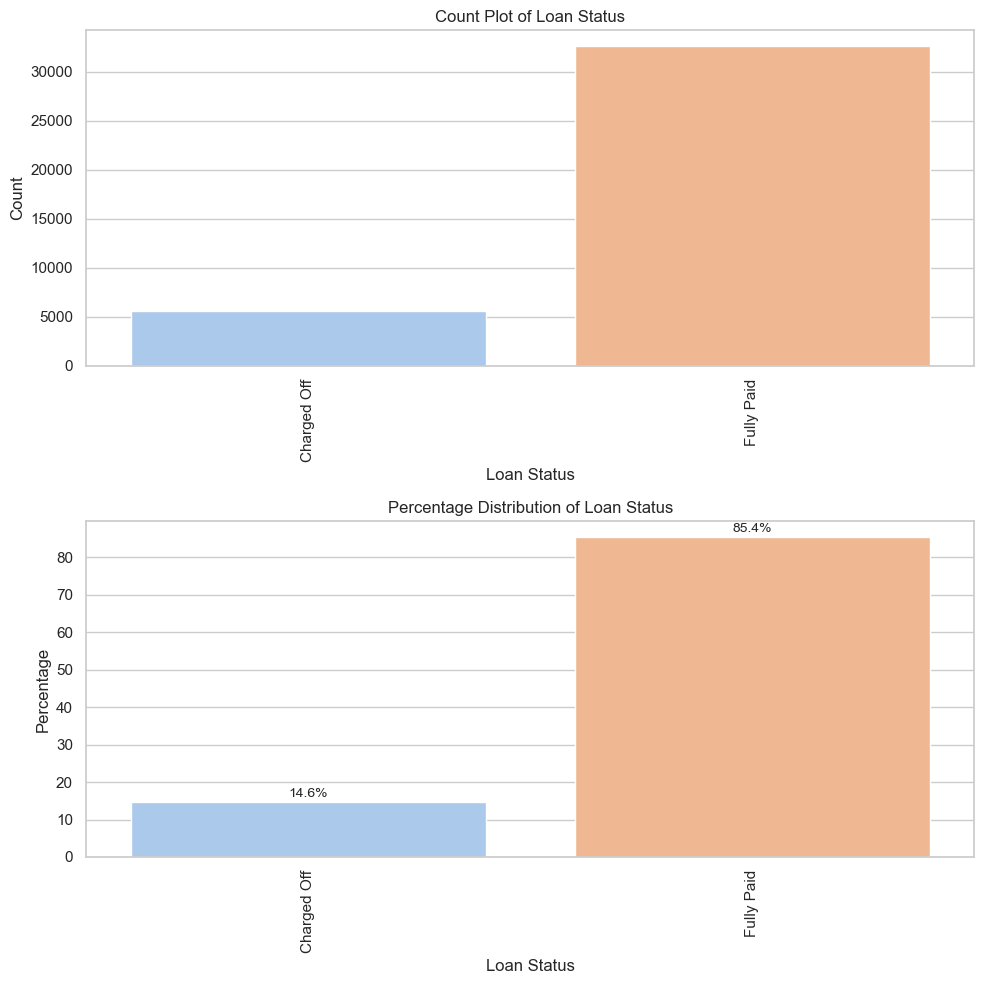

In [179]:
univariate_analysis_by_column(loan_df,'loan_status')

In [180]:
# Inference
# Majority of the loans, i.e. 85.4% are fully paid. A smaller number around 5000 of the loans are under Charged Off status


In [181]:
# Skipping the default_status_binary as insights will be similar to loan_status

In [182]:
# 2. loan_amnt - continuous numerical column
# Distribution of loan_amnt

In [183]:
loan_df['loan_amnt'].describe()

count    38191.000000
mean     10962.265979
std       7266.157660
min        500.000000
25%       5200.000000
50%       9600.000000
75%      15000.000000
max      35000.000000
Name: loan_amnt, dtype: float64

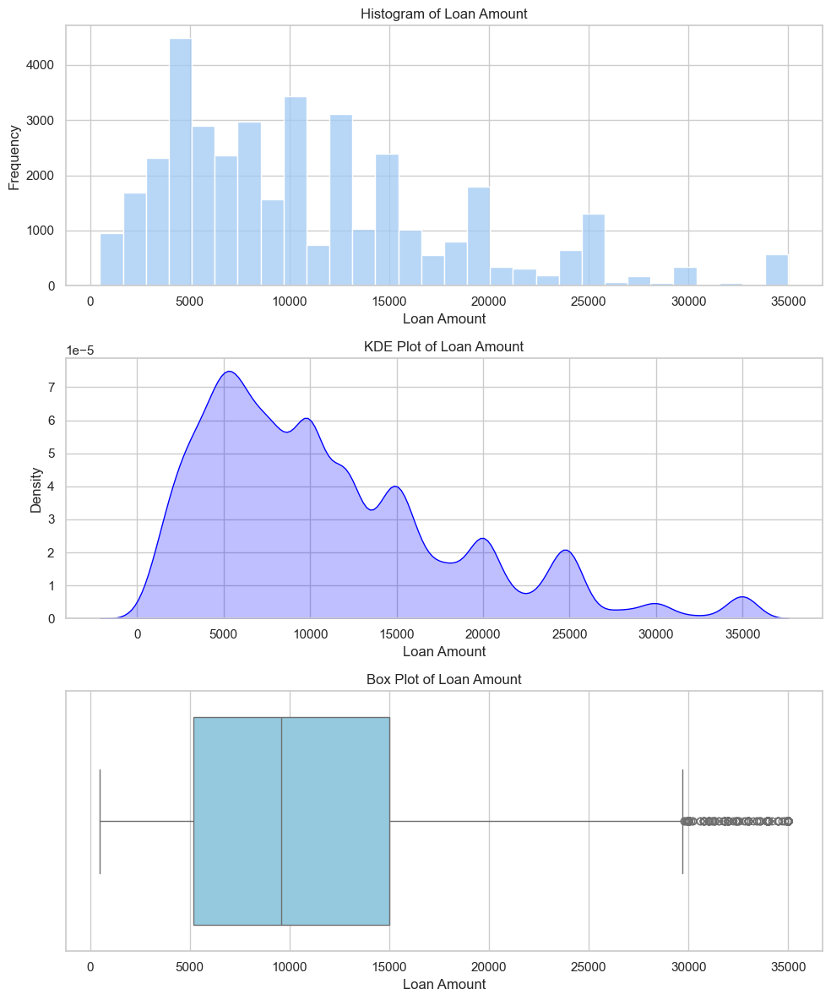

In [184]:
univariate_analysis_by_column(loan_df,'loan_amnt', 'Loan Amount')

In [185]:
# Inference
# Loan amount varies from 500 to 35000; mean is  10962.26
# There is a right skew showing that most loans are towards lower amounts. There is a wide range showing diversity in loan amounts


In [186]:
# 3. funded_amnt - continuous numerical column
# Distribution of funded_amnt

In [187]:
loan_df['funded_amnt'].describe()

count    38191.000000
mean     10703.329973
std       7011.076206
min        500.000000
25%       5100.000000
50%       9500.000000
75%      15000.000000
max      35000.000000
Name: funded_amnt, dtype: float64

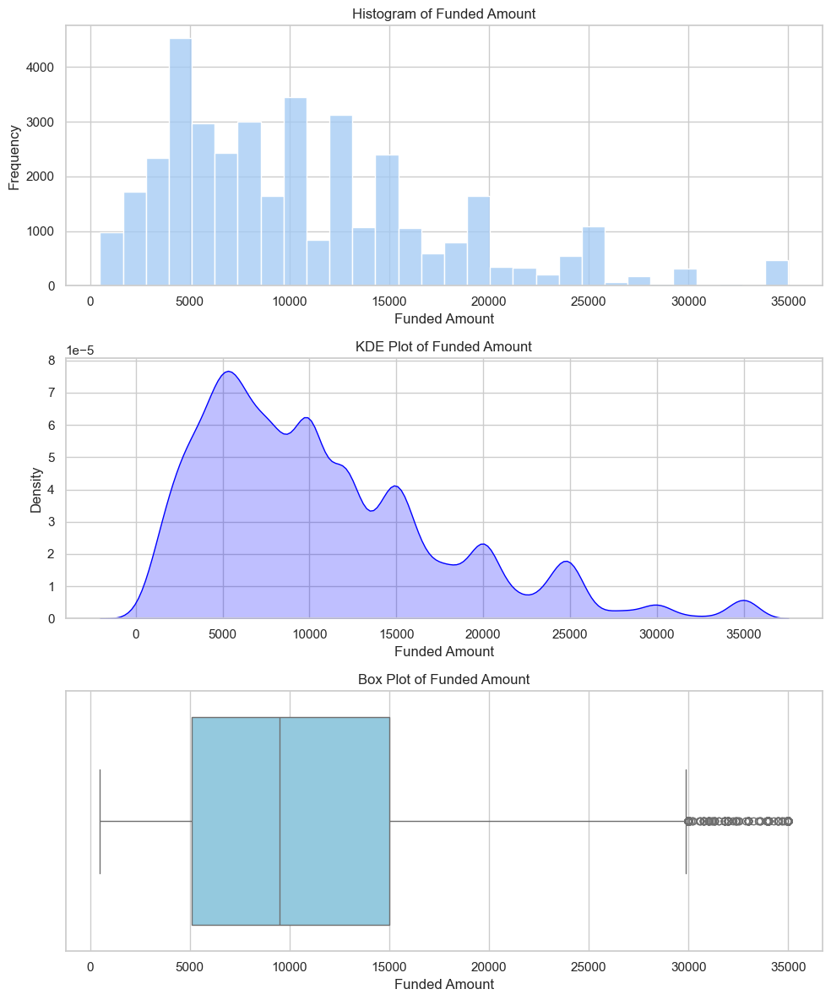

In [188]:
univariate_analysis_by_column(loan_df,'funded_amnt', 'Funded Amount')

In [189]:
# Loan amount and funded amount is similar for many columns. Check if it is same for all rows

In [190]:
loan_df['loan_amnt'].equals(loan_df['funded_amnt'])


False

In [191]:
comparison = loan_df['loan_amnt'] == loan_df['funded_amnt']
different_rows = loan_df[~comparison]
len(different_rows)

1727

In [192]:
# There are columns with different funded values

In [193]:
# Inference
# Though most of the values are similar to loan_amt there are rows with different funded_amt
# Similar to the loan_amt funded_amt distribution also shows a right skew indicating that most loans are towards lower amounts.

In [194]:
# 4. int_rate - continuous numerical column

loan_df['int_rate'].value_counts().sort_values().head()

int_rate
16.20    1
20.52    1
16.71    1
22.94    1
21.48    1
Name: count, dtype: int64

In [195]:
loan_df['int_rate'].nunique() # Check if the values of interest rates are less to be considered for a count plot


370

In [196]:
# Values are continuous and higher in number so, consider as numeric 


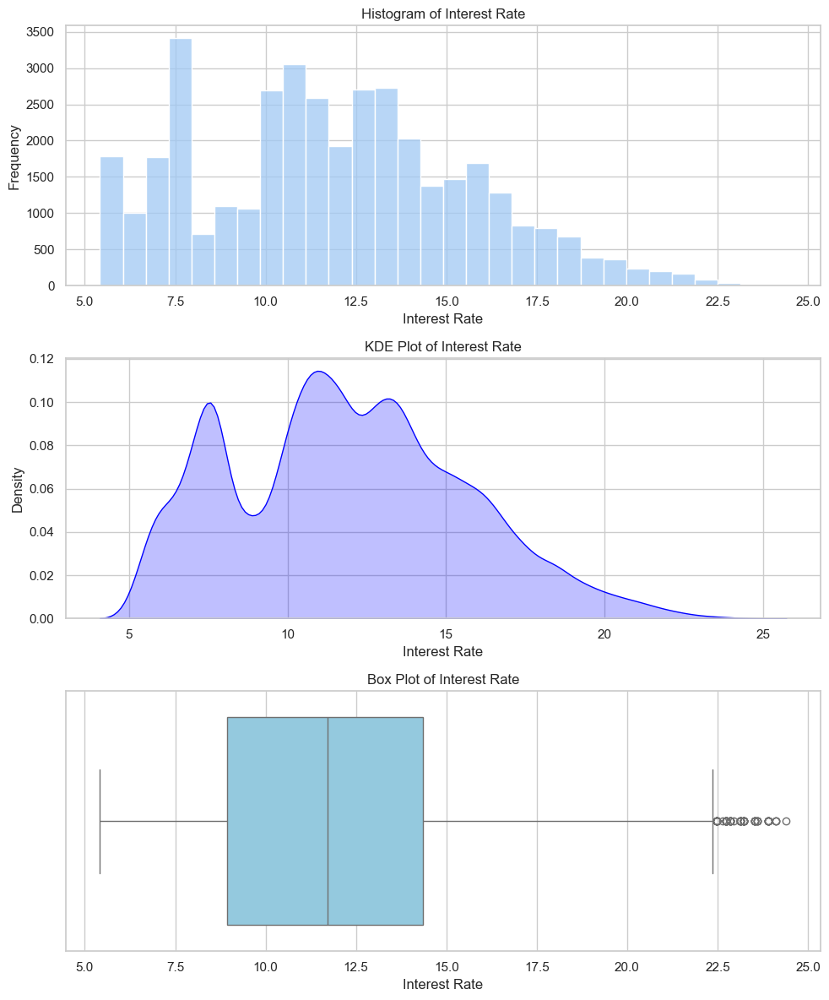

In [197]:
univariate_analysis_by_column(loan_df,'int_rate', 'Interest Rate')

In [198]:
loan_df['int_rate'].value_counts().sort_index(ascending=False).head()

int_rate
24.40    1
24.11    3
23.91    8
23.59    4
23.52    6
Name: count, dtype: int64

In [199]:
loan_df['int_rate'].value_counts().sort_index(ascending=False).tail()

int_rate
6.03    444
6.00     16
5.99    345
5.79    410
5.42    570
Name: count, dtype: int64

In [200]:
# Inference
# Interest rates ranges from 5.42 to 24.40
# Maximum number of loans were in the range of about 10 to 14 interest rates
# There is dip in the distribution along the range of approximately 7.5 to 9.5, showing there is less number of loans given with this 
# range of interest rates.

In [201]:
# 5. installment - continuous numerical column

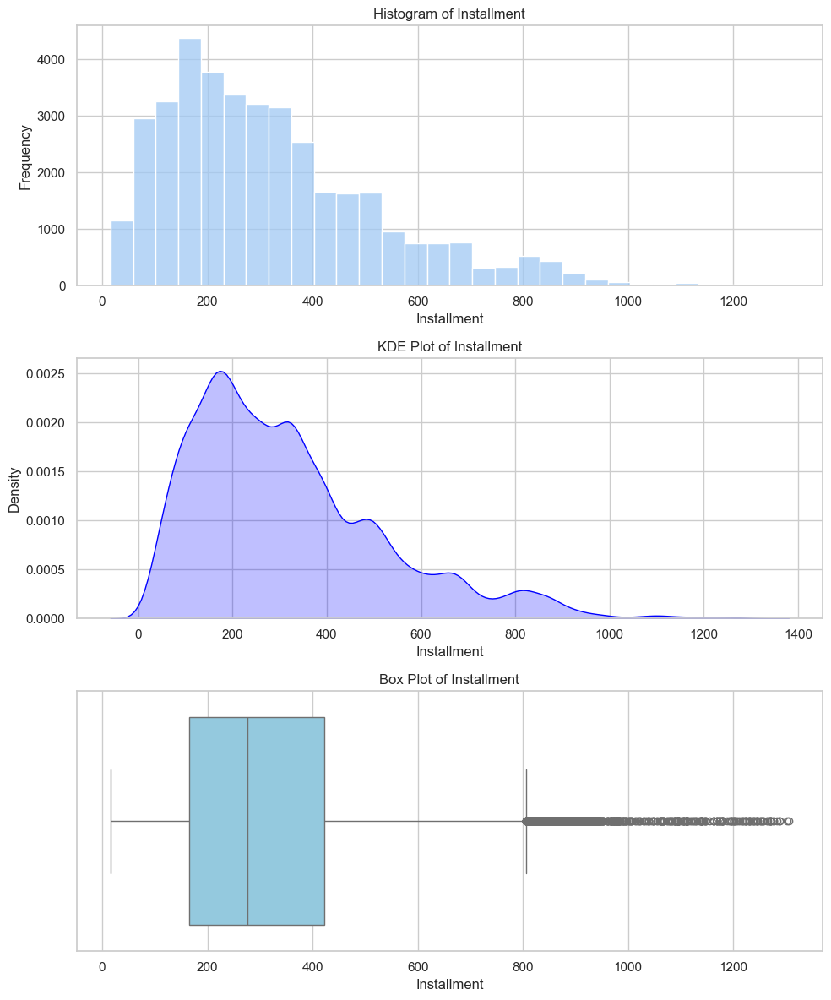

In [202]:
univariate_analysis_by_column(loan_df,'installment', 'Installment')

In [203]:
# Inference
# Disribution chart is right skewed showing that majority of the borrowers have relatively lower monthly installment amounts
# There are significantly fewer loans with installment value above 1000


In [204]:
# 6. grade - categorical column

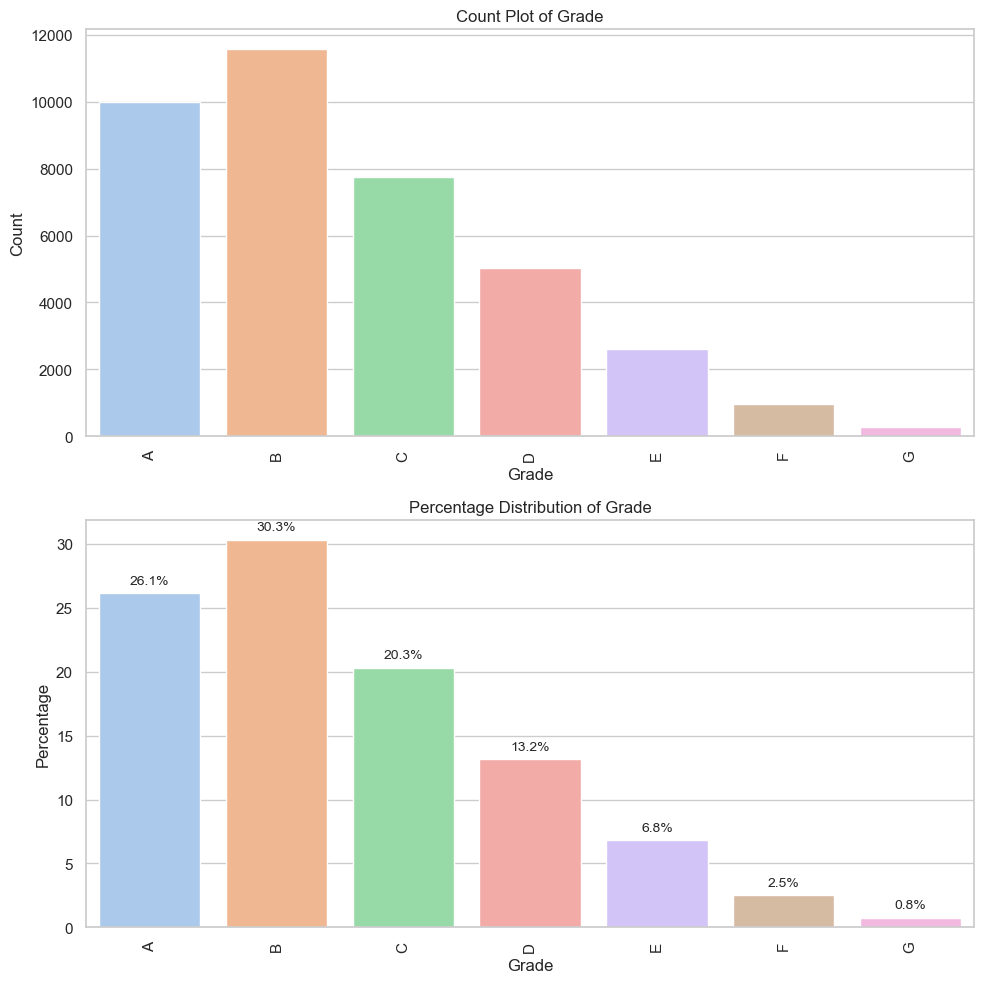

In [205]:
univariate_analysis_by_column(loan_df,'grade', 'Grade')

In [206]:
# Inference 
# Highest number of loans were under grade B followed by grade A in second position
# Distribution is almost right skewed,  showing that lesser loans were given to lower grades

In [207]:
# 7. sub_grade - categorical column

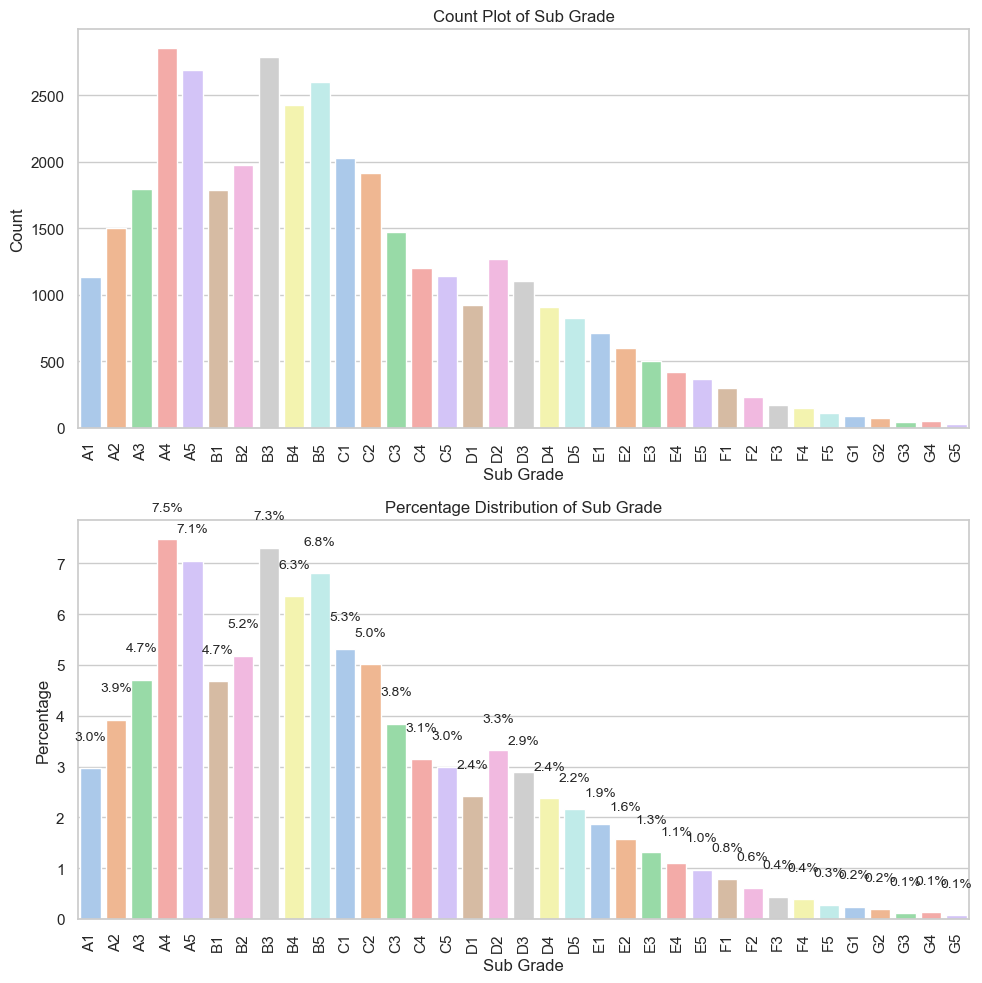

In [208]:
univariate_analysis_by_column(loan_df,'sub_grade', 'Sub Grade')

In [209]:
# Inference
# Distribution is almost right skewed with some variations on the left, but overall, it shows that lesser loans were given to lower sub grades
# A4 is the sub grade with the highest number of loans followed by B3

In [210]:
# 8. purpose - categorical column

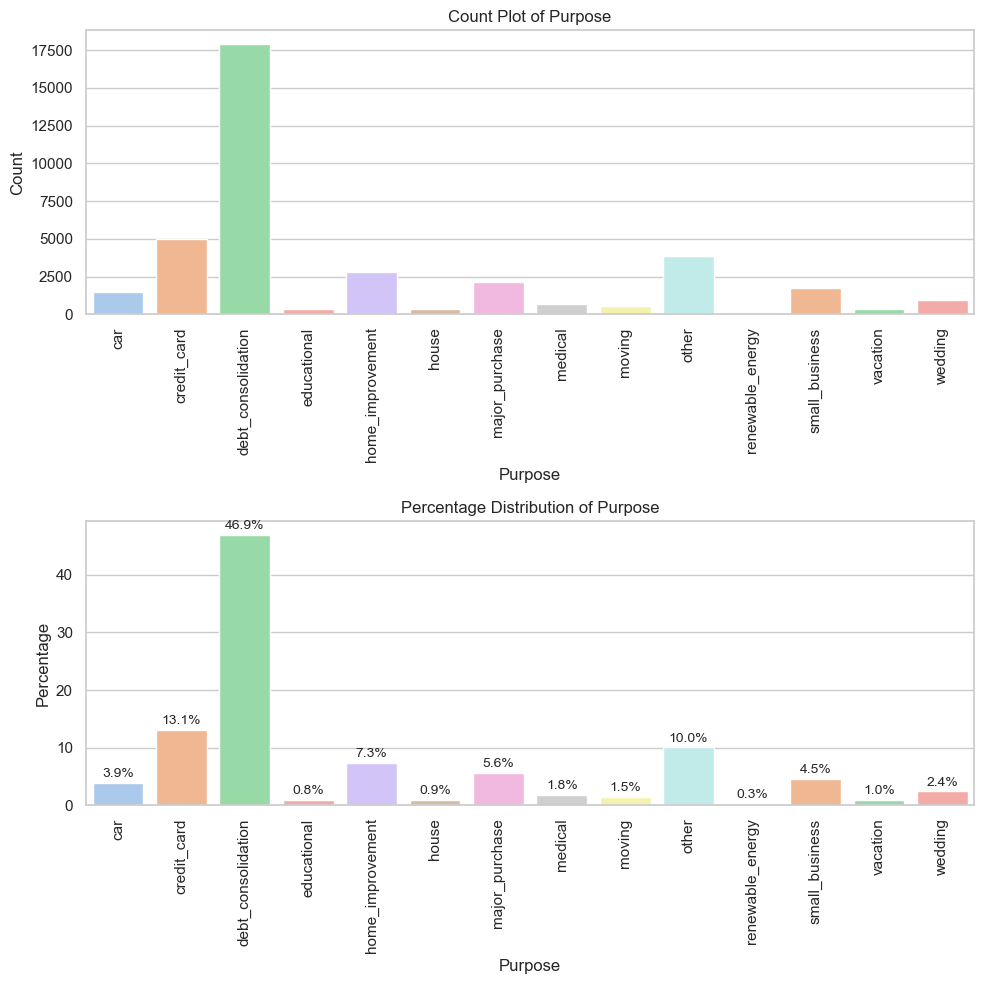

In [211]:
univariate_analysis_by_column(loan_df,'purpose', 'Purpose')

In [212]:
# Inference
# Highest number of loans were under the purpose of debt_consolidation followed by credit_card

In [213]:
# 9. term_in_months - There are two values only so it is a categorical column
loan_df['term_in_months'].value_counts()

term_in_months
36    28819
60     9372
Name: count, dtype: int64

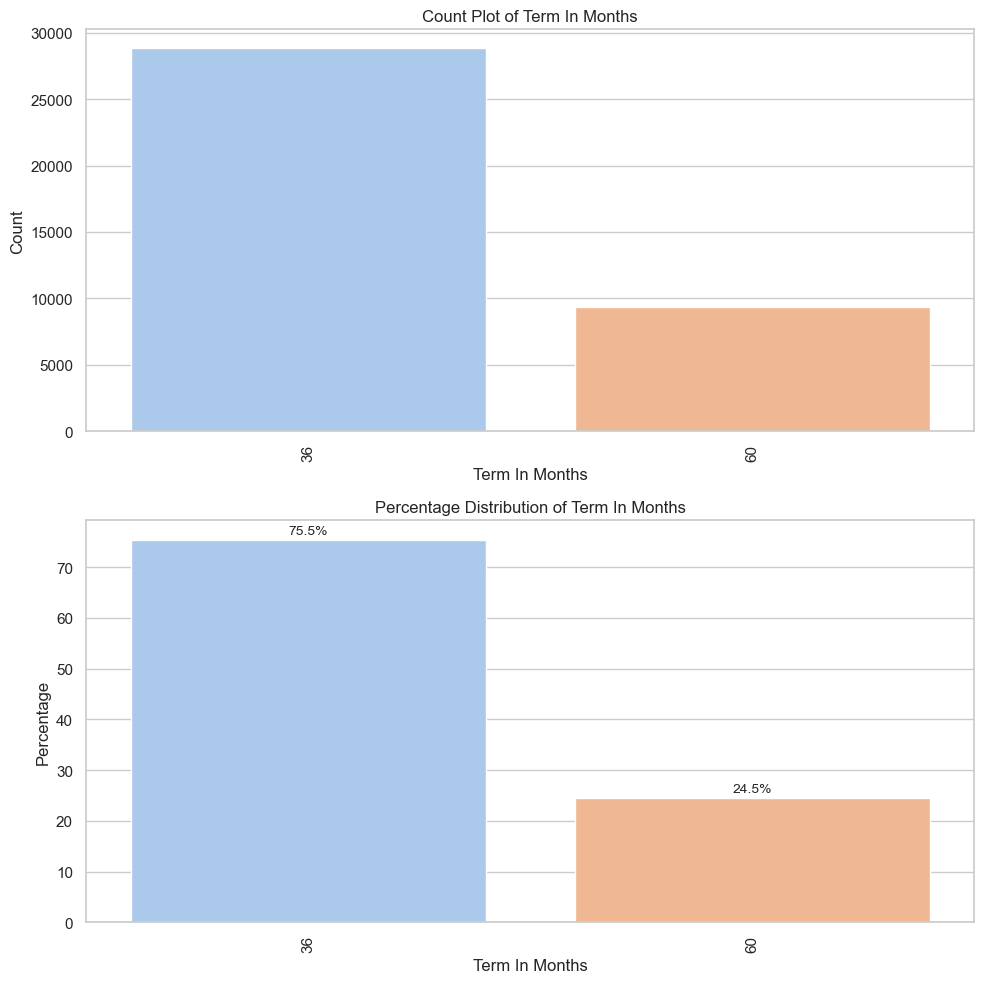

In [214]:
univariate_analysis_by_column(loan_df,'term_in_months',analysis_type='categorical')

In [215]:
# Inference
# 36 months term loans were almost three times higher in number than 60 months term loans

In [216]:
# Inference 
# 13 year old loans has significantly more defaults than older loans.
# Might be worth analyzing the default loan count in loan issued year 2011 ( current year(2024) -13 = 2011), analyze why more defaults 
# happened during that year

In [217]:
# 11. loan_size_category -  Categorical data
loan_df['loan_size_category'].value_counts()

loan_size_category
Small         18566
Medium        12927
Large          5441
Very Large     1257
Name: count, dtype: int64

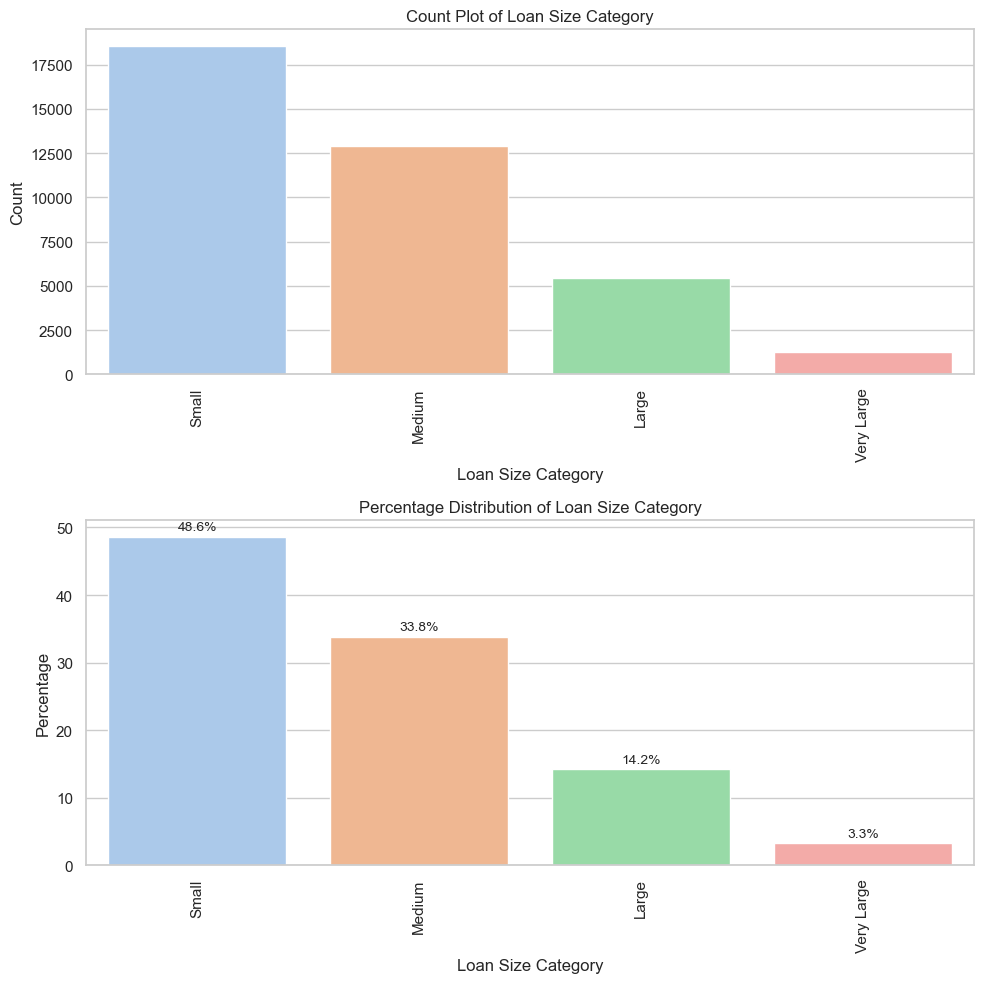

In [218]:
univariate_analysis_by_column(loan_df,'loan_size_category')

In [219]:
# Inference
# Majority of the loans given were under small size category

In [220]:
# 12. int_rate_category -  Categorical data
loan_df['int_rate_category'].value_counts()

int_rate_category
Medium       17649
Low          12292
High          7292
Very High      958
Name: count, dtype: int64

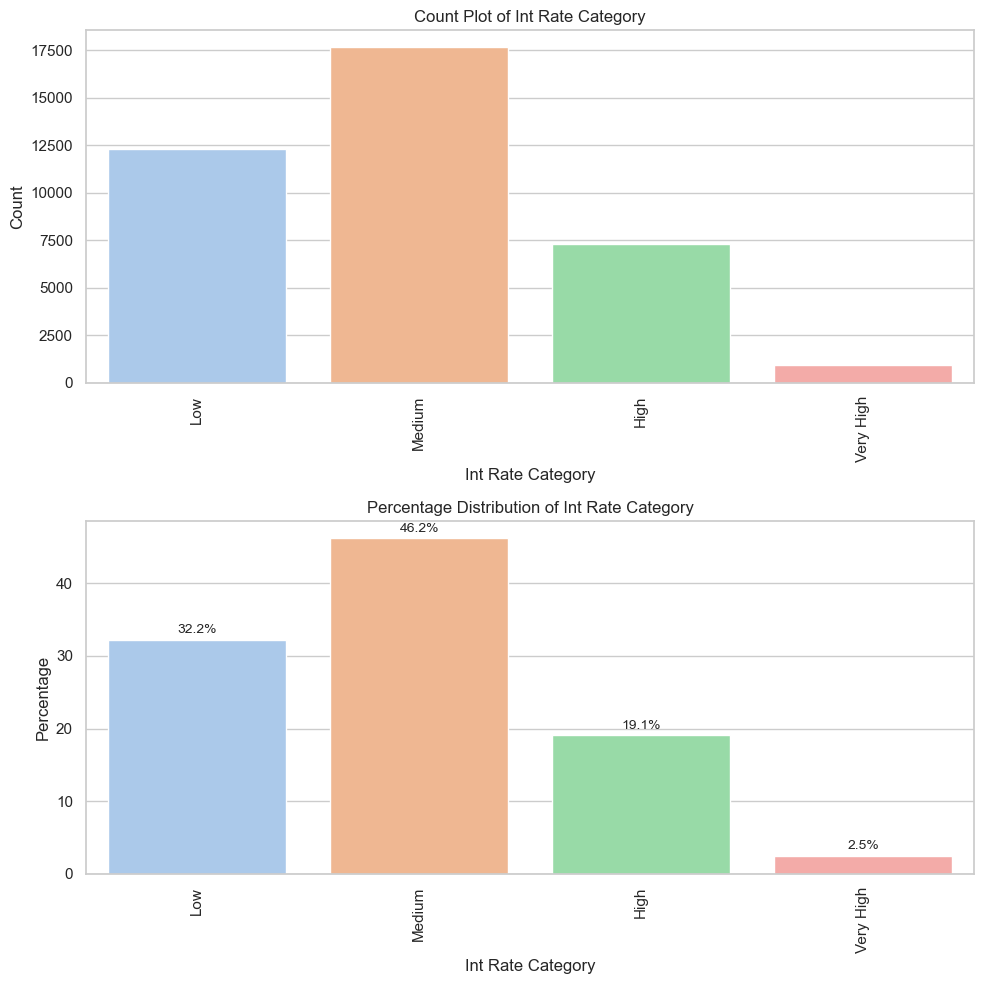

In [221]:
univariate_analysis_by_column(loan_df,'int_rate_category')

In [222]:
# Inference
# Majority of loans given had medium interest rates

In [223]:
# 13. loan_issue_month -  Categorical data

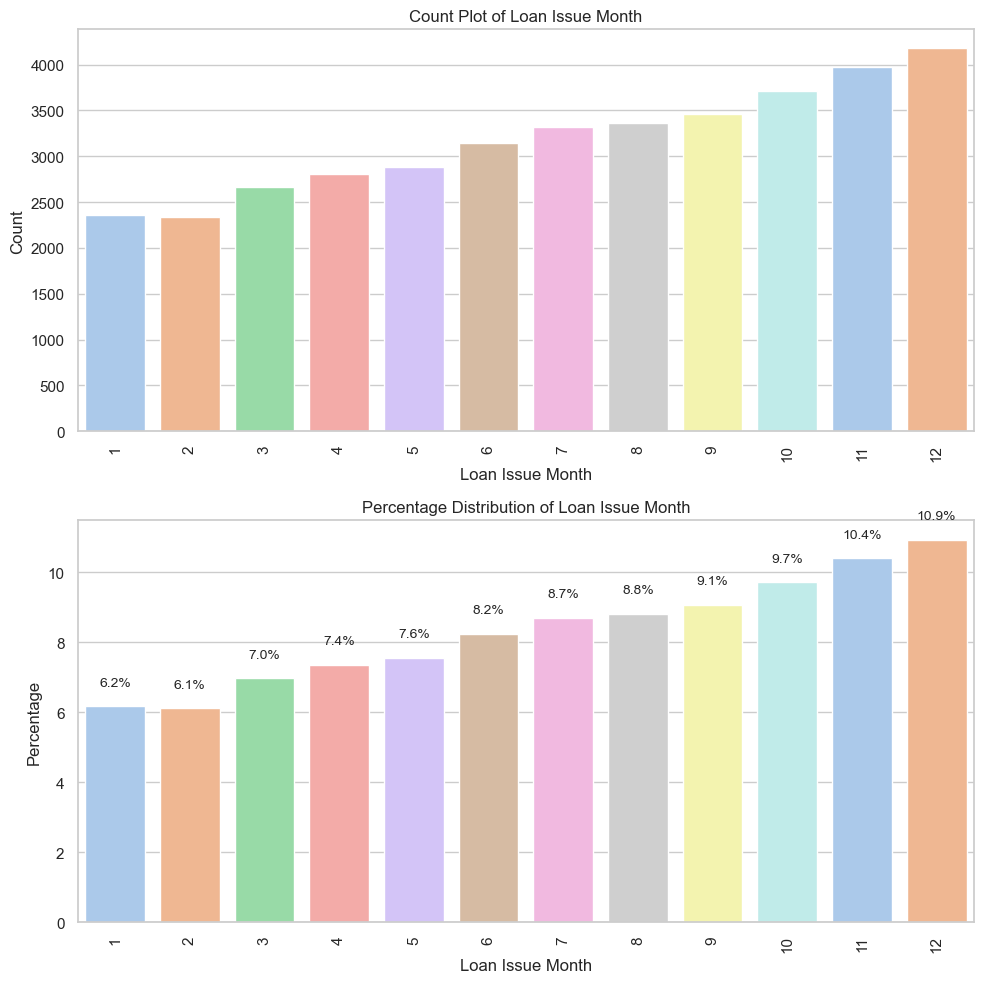

In [224]:
univariate_analysis_by_column(loan_df,'loan_issue_month',analysis_type='categorical')

In [225]:
# Inference
# More loans were given in the last month and the rate increased almost linearly from the first month to the last

In [226]:
# 14. loan_issue_year -  Categorical data

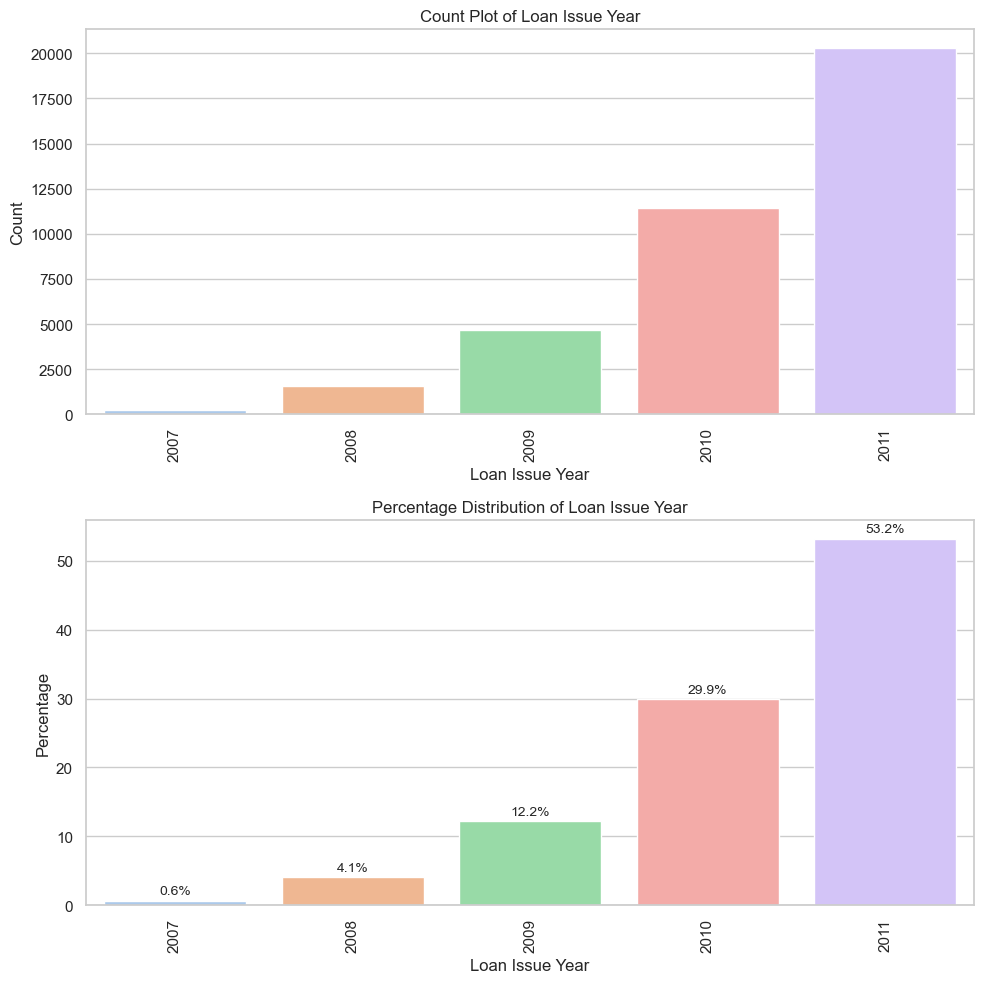

In [227]:
univariate_analysis_by_column(loan_df,'loan_issue_year')

In [228]:
# Inference
# Highest number of loans were given in 2011. 
# There is almost an exponential increase in amount of loans given, every year starting from 2007 to 2011


In [229]:
# 15. verification_status -  Categorical data

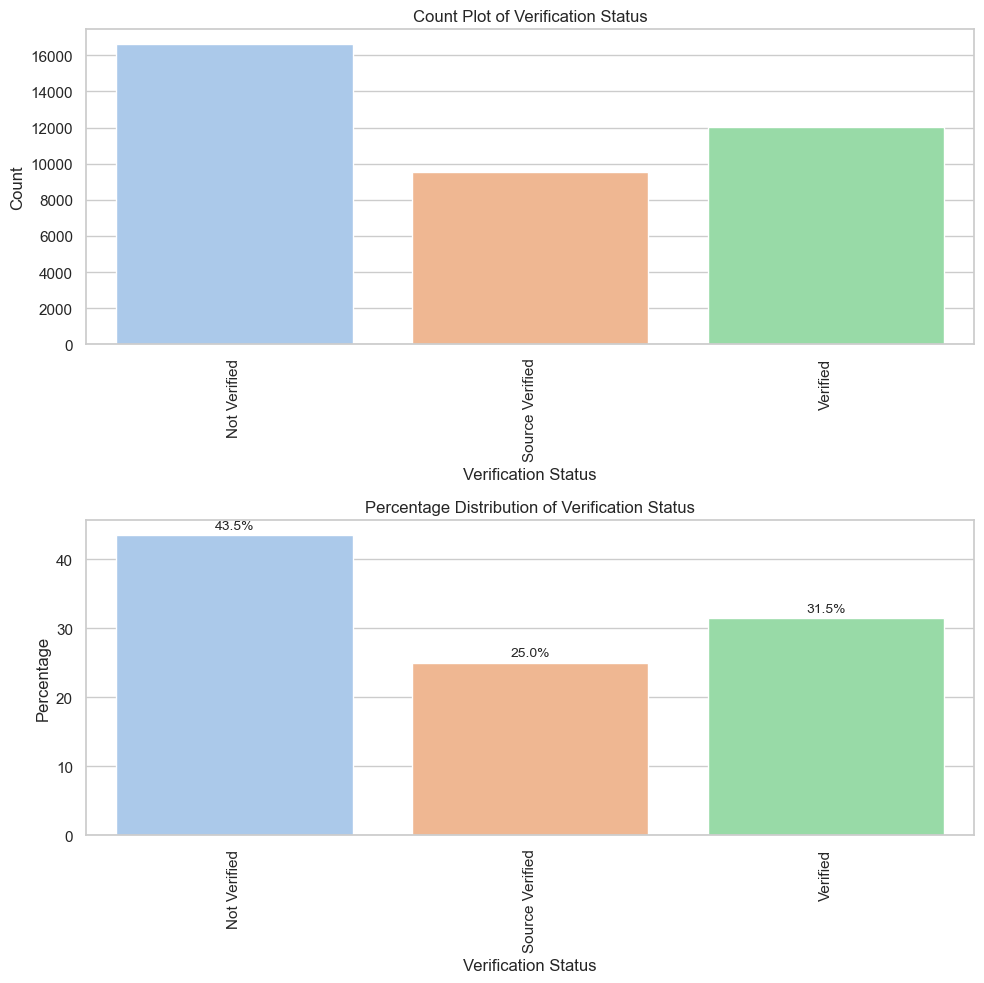

In [230]:
univariate_analysis_by_column(loan_df,'verification_status')

In [231]:
# Inference
# Most of the loans were not verified. 
# Source verified loans were less, compared to verified and non verified


In [232]:
# 16. issue_d

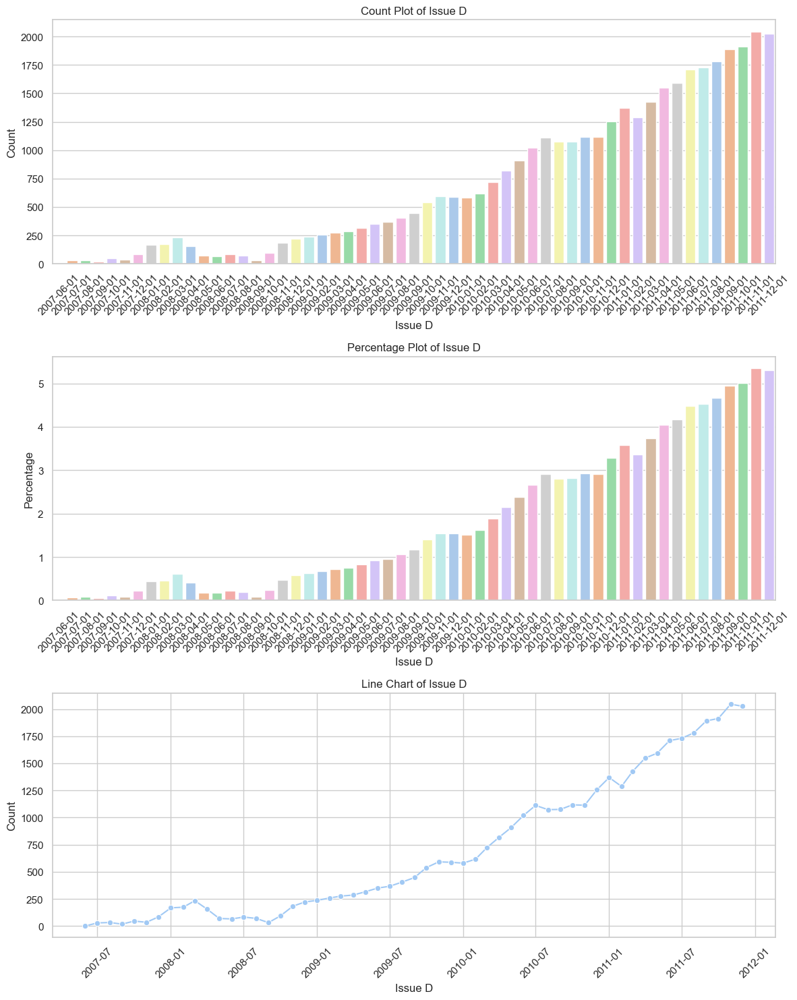

In [233]:
univariate_analysis_by_column(loan_df,'issue_d')

In [234]:
# Inference
# More loans were given during the latest dates in the data. This means that the number of loans increased over time
# showing increased business

In [235]:
# 17. addr_state -  Categorical data
loan_df['addr_state'].value_counts().head()

addr_state
CA    6882
NY    3644
FL    2749
TX    2628
NJ    1767
Name: count, dtype: int64

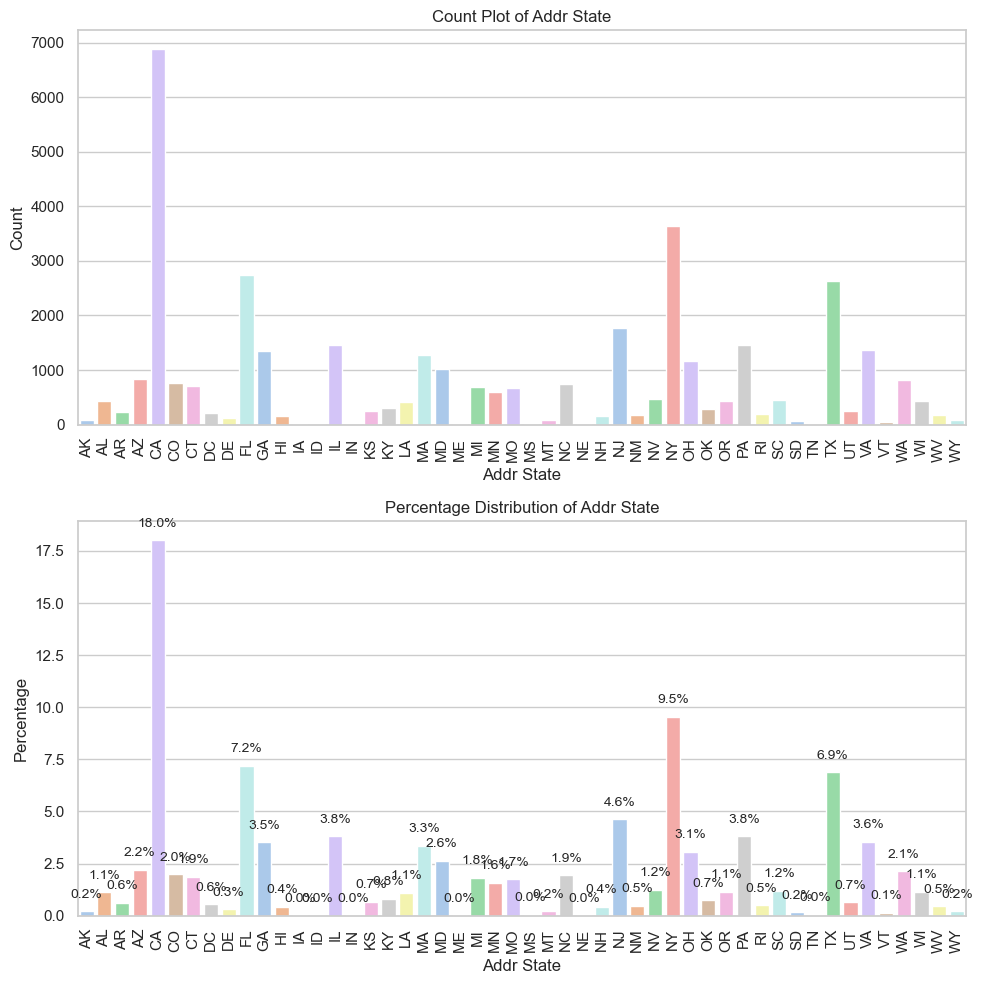

In [236]:
univariate_analysis_by_column(loan_df,'addr_state')

In [237]:
# Inference
# Highest number of loans were given to borrowers in CA, followed by NY in second position

In [238]:
# 18. dti -  Debt to income ratio- numerical continuos data
loan_df['dti'].describe()


count    38191.000000
mean        13.333491
std          6.657843
min          0.000000
25%          8.210000
50%         13.430000
75%         18.600000
max         29.990000
Name: dti, dtype: float64

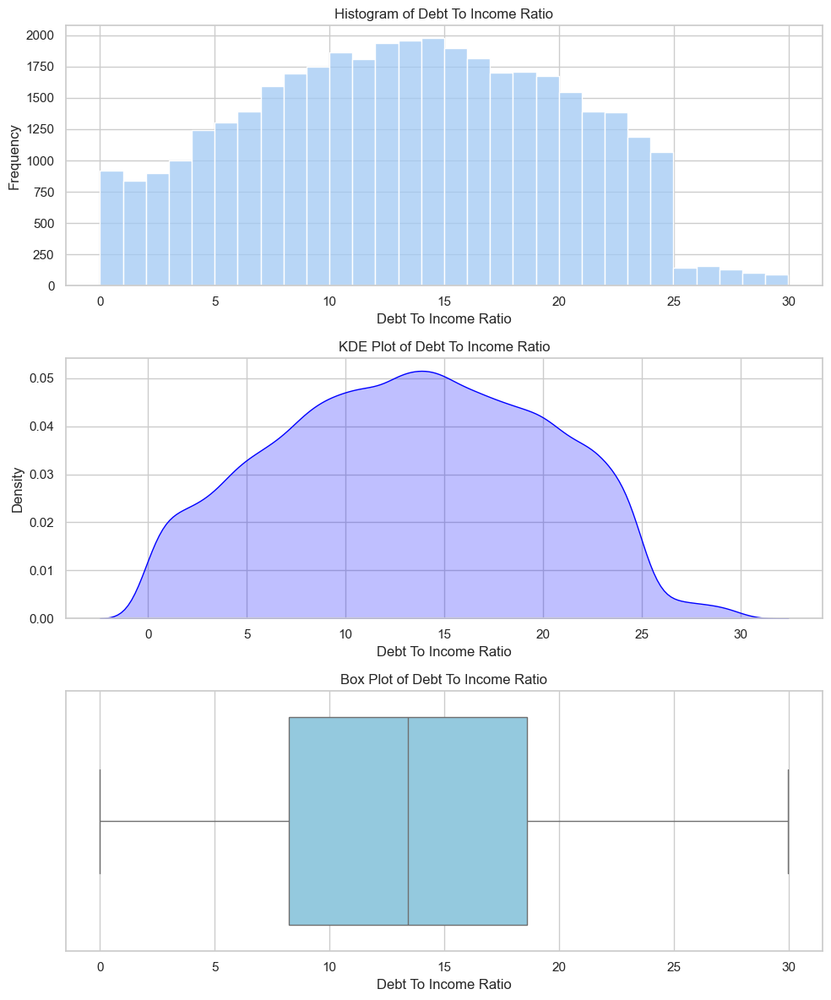

In [239]:
univariate_analysis_by_column(loan_df,'dti','Debt To Income Ratio')

In [240]:
# Inference
# dti has almost a normal distribution
# Majority of the borrowers had a high dti, that means they had higher debts compared to their income

In [241]:
# 19. lti -  Loan to income ratio- numerical continous data

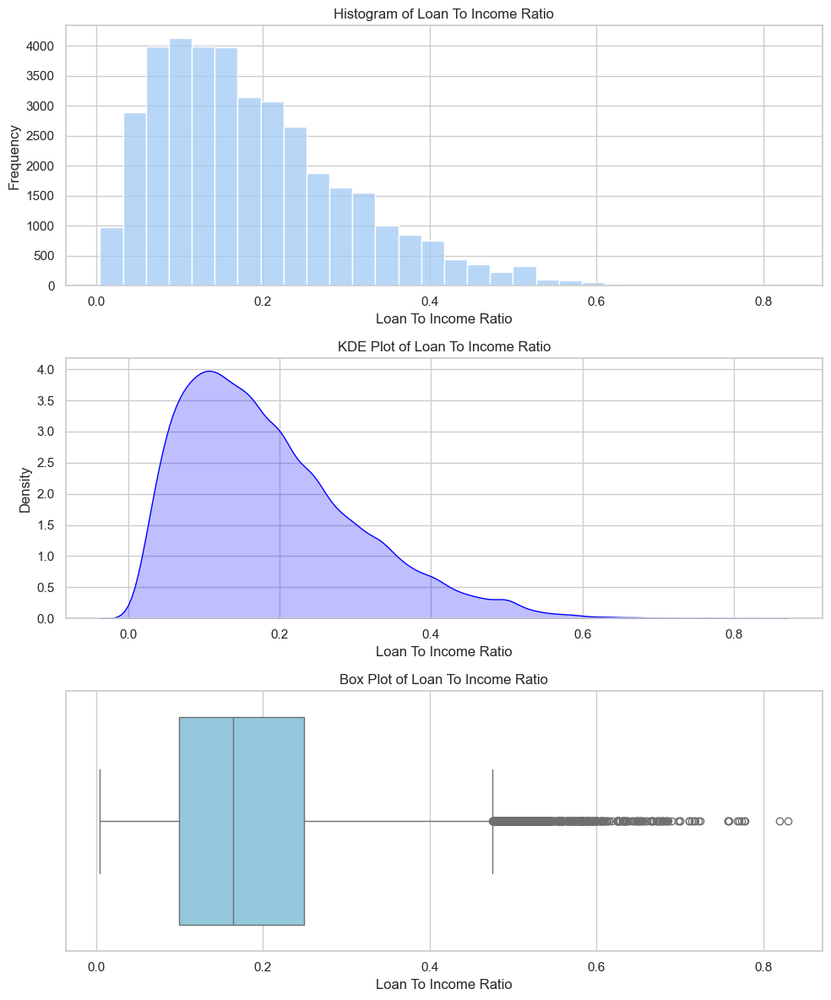

In [242]:
univariate_analysis_by_column(loan_df,'lti','Loan To Income Ratio')

In [243]:
# Inference
# The right skew in the chart shows that majority of the borrowers have low lti ratios, which means 
# most borrowers are taking loans that represent a relatively small proportion of their income from the perspective of the 
# specific loan amount. But DTI showed that majority had higher total debts in total
# A small proportion of borrowers have loans that constitute a relatively higher portion of their income.

In [244]:
# 20. pub_rec_bankruptcies -  categorical data
loan_df['pub_rec_bankruptcies'].value_counts()

pub_rec_bankruptcies
0.0    36553
1.0     1633
2.0        5
Name: count, dtype: int64

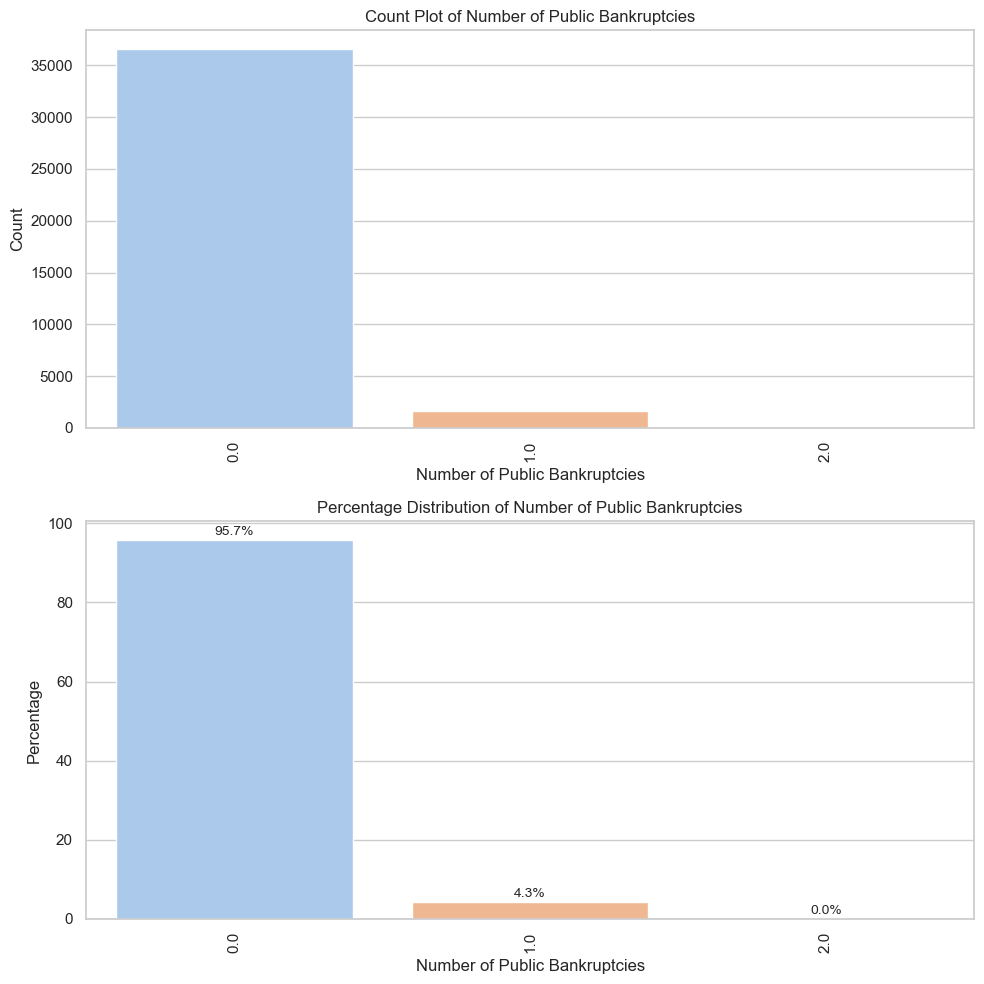

In [245]:
univariate_analysis_by_column(loan_df,'pub_rec_bankruptcies','Number of Public Bankruptcies')

In [246]:
# Inference
# Majority of customers didnt have public record bankruptcies.

In [247]:
# 21. emp_length -  categorical data as there is limited set of numberical data ranging from 0 to 10
loan_df['emp_length'].value_counts()

emp_length
10.0    8354
0.0     4479
4.0     4343
2.0     4245
3.0     3977
5.0     3168
1.0     3143
6.0     2151
7.0     1697
8.0     1419
9.0     1215
Name: count, dtype: int64

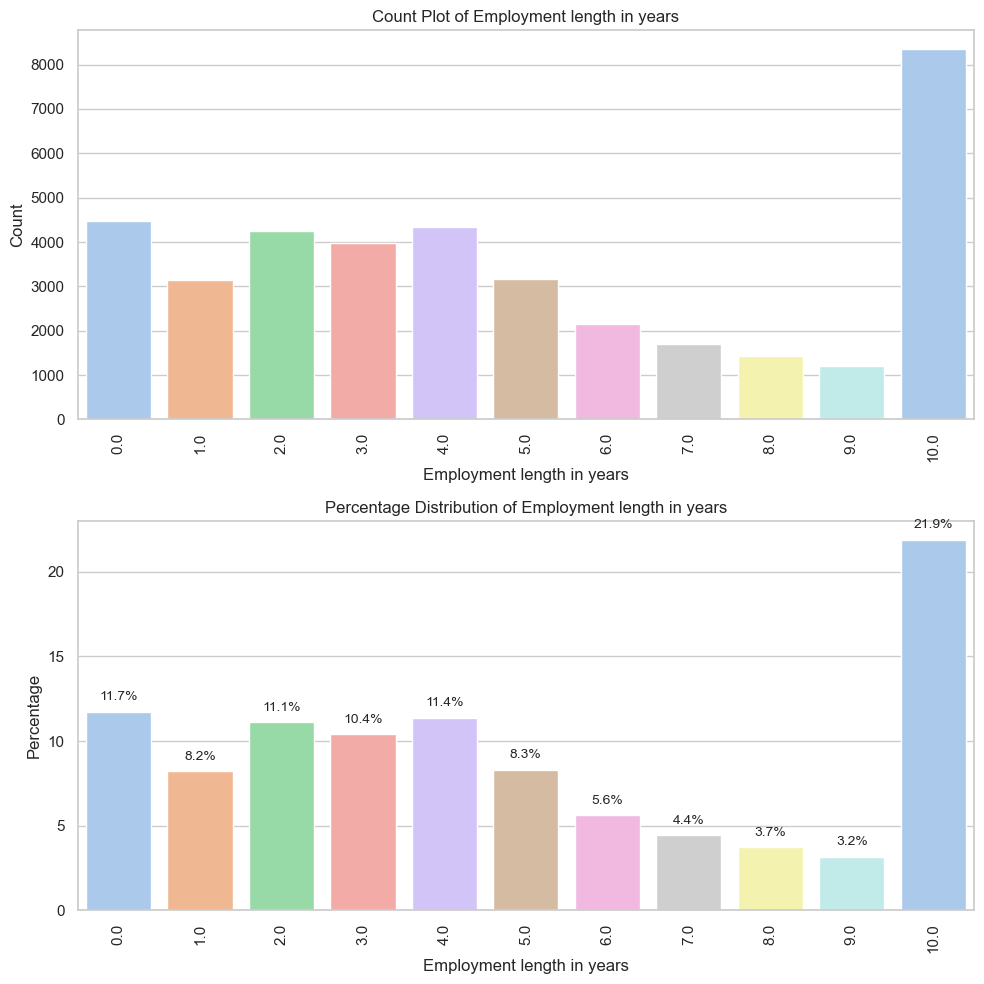

In [248]:
univariate_analysis_by_column(loan_df,'emp_length','Employment length in years',analysis_type='categorical')

In [249]:
# Inference
# Majority of the borrowers had 10 or more years of employment experience length


In [250]:
# 22. home_ownership -  categorical data
loan_df['home_ownership'].value_counts()

home_ownership
RENT        18397
MORTGAGE    16748
OWN          2947
OTHER          96
NONE            3
Name: count, dtype: int64

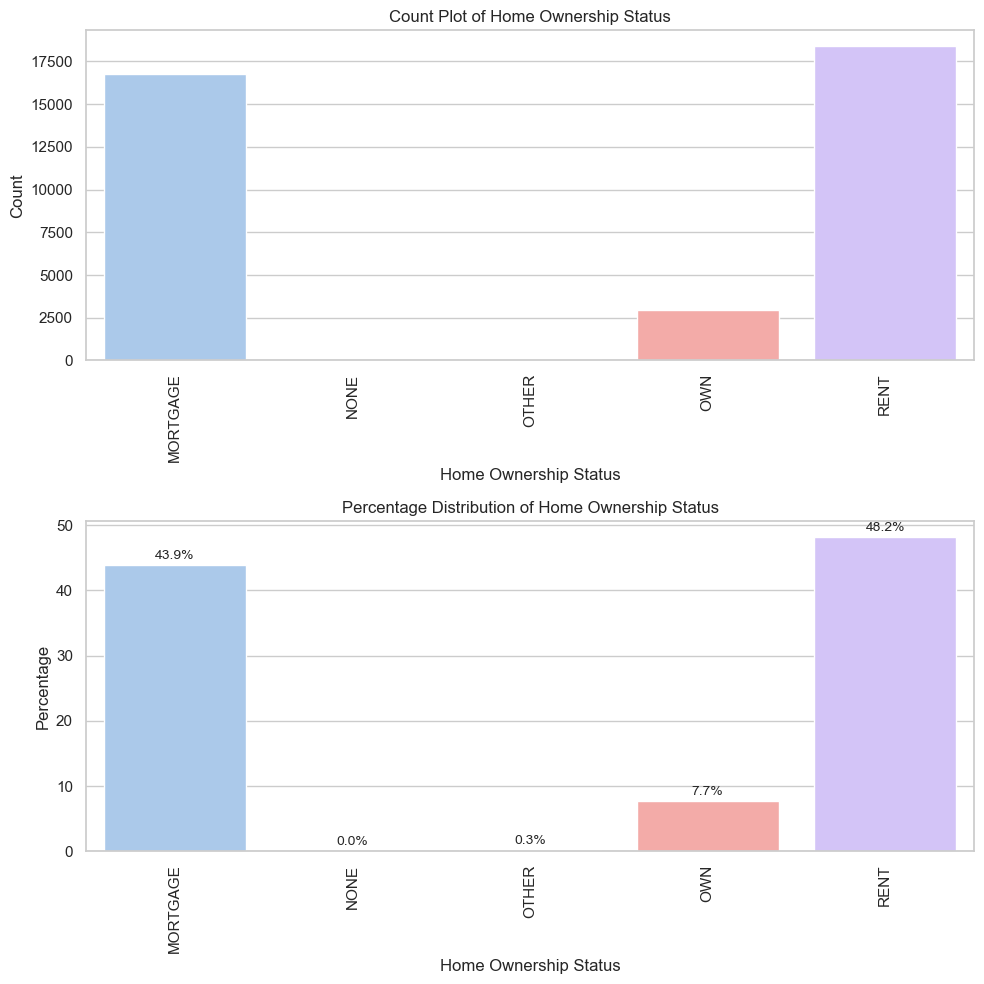

In [251]:
univariate_analysis_by_column(loan_df,'home_ownership','Home Ownership Status')

In [252]:
# Inference
# Majority of borrowers had home ownership status of rent, that may indicate that they don't own a house
# followed by borrowers with mortgage status

In [253]:
# 23. annual_inc -  continuous numerical data
loan_df['annual_inc'].value_counts().head()

annual_inc
60000.0    1466
50000.0    1029
40000.0     855
45000.0     811
30000.0     808
Name: count, dtype: int64

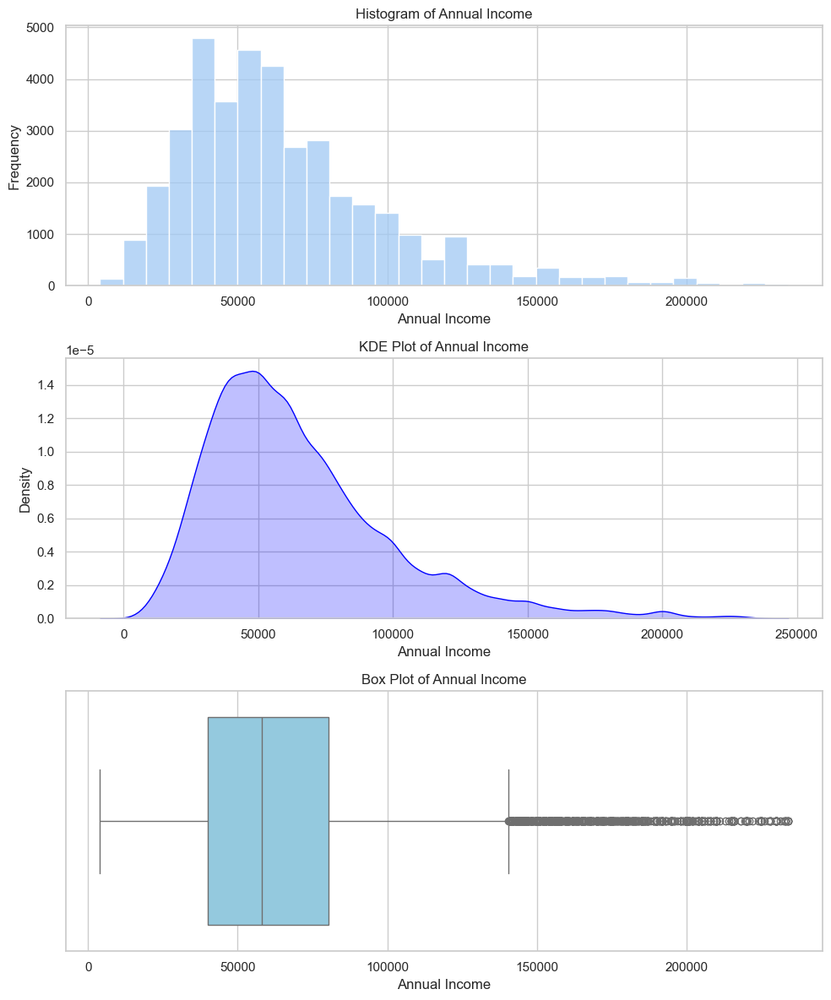

In [254]:
univariate_analysis_by_column(loan_df,'annual_inc','Annual Income')

In [255]:
# Inference
# The annual income distribution is slightly right skewed indicating that there are fewer high income borrowers than
# medium and low income borrowers
# Most of the borrowers have low or medium annual income 

## Segmented Univariate Analysis

In [256]:

# Function to create plots for segmented univariate analysis, considering the data type of the column
def segmented_univariate_analysis_by_column(df, column_name, segment_column, col_name_label=None, segment_col_name_label=None, analysis_type=None, include_line_chart_categorical=False, x_axis_label_rotation=0):
    """
    Perform segmented univariate analysis for a specific column in the DataFrame.
    Handles numerical columns as categorical if unique occurrences are minimal.
    Includes specific handling for date columns, segmentation by a target variable, and optional line plot.
    
    Parameters:
        df (DataFrame): The input DataFrame.
        column_name (str): The column to analyze.
        segment_column (str): The column used for segmentation (e.g., default_status_binary).
        col_name_label (str): Optional expanded name for column labels and titles.
        analysis_type (str): Specify "numerical" or "categorical" to limit analysis type. Default is None (automatic).
        include_line_plot (bool): Whether to include line plots for trends. Default is False.
    """
    sns.set_palette("pastel")
    sns.set_style("whitegrid")
    
    # Check if the column and segment column exist in the dataframe
    if column_name not in df.columns or segment_column not in df.columns:
        print(f"One or both columns '{column_name}' and '{segment_column}' not found in the DataFrame.")
        return

    # Determine the column label
    if not col_name_label:
        col_label = " ".join(x.title() for x in column_name.split("_"))
    else:
        col_label = col_name_label

    # Determine the segment column label
    if not segment_col_name_label:
        segment_label = segment_column.replace('_', ' ').title()
    else:
        segment_label = segment_col_name_label

    # Automatically determine type if analysis_type is not provided
    col_type = df[column_name].dtype
    unique_values = df[column_name].nunique()  # Count the unique values in the column

    if analysis_type is None:
        if pd.api.types.is_datetime64_any_dtype(df[column_name]):  # Check if the column is of date type
            analysis_type = "date"
        elif unique_values <= 10:  # Treat numerical columns with minimal unique values as categorical
            analysis_type = "categorical"
        elif col_type in ['int64', 'float64', 'int32']:
            analysis_type = "numerical"
        elif col_type == 'object' or col_type.name == 'category':
            analysis_type = "categorical"
        else:
            print(f"Unsupported column type for '{column_name}'.")
            return

    # Map segment labels for better readability if segment_column is binary
    if segment_column == "default_status_binary":
        segment_labels = {1: "Defaulted", 0: "Non-Defaulted"}
        df["segment_label"] = df[segment_column].map(segment_labels)
        hue_order = ["Non-Defaulted", "Defaulted"]
    else:
        df["segment_label"] = df[segment_column]
        hue_order = sorted(df["segment_label"].unique())  # Sort hue labels alphabetically or as needed

    if analysis_type == "numerical" and col_type in ['int64', 'float64', 'int32']:
        g = sns.FacetGrid(df, col="segment_label", sharex=False, height=5, aspect=1.5)
        g.map(sns.histplot, column_name, kde=True, bins=30)
        g.set_axis_labels(col_label, "Frequency")
        g.set_titles("{col_name}")
        plt.suptitle(f"Segmented Analysis of {col_label} by {segment_label}", y=1.02)
        plt.tight_layout()
        plt.show()

        # Horizontal Box Plot
        sns.boxplot(data=df, y="segment_label", x=column_name, orient="h", order=hue_order)
        plt.title(f"Box Plot of {col_label} by Segment")
        plt.xlabel(col_label)
        plt.ylabel("Segment")
        plt.show()

        # Horizontal Violin Plot
        sns.violinplot(data=df, y="segment_label", x=column_name, orient="h", order=hue_order)
        plt.title(f"Violin Plot of {col_label} by Segment")
        plt.xlabel(col_label)
        plt.ylabel("Segment")
        plt.show()

        # Overlapping KDE Plot
        plt.figure(figsize=(10, 6))
        for segment_value in hue_order:
            sns.kdeplot(
                data=df[df["segment_label"] == segment_value][column_name],
                label=segment_value,
                shade=True
            )
        plt.title(f"Density Plot of {col_label} by Segment")
        plt.xlabel(col_label)
        plt.ylabel("Density")
        plt.legend(title="Segment")
        plt.tight_layout()
        plt.show()

    elif analysis_type == "categorical":  # Categorical column
        # Sort categories by frequency
        sorted_categories = df[column_name].value_counts().sort_index().index

        fig, axes = plt.subplots(3, 1, figsize=(12, 18))
        
        # Count Plot
        sns.countplot(
            data=df, 
            x=column_name, 
            hue="segment_label", 
            hue_order=hue_order, 
            order=sorted_categories, 
            ax=axes[0]
        )
        axes[0].set_title(f"Count Plot of {col_label} by Segment")
        axes[0].set_xlabel(col_label)
        axes[0].set_ylabel("Count")
        axes[0].legend(title="Segment")
        axes[0].tick_params(axis='x', rotation=x_axis_label_rotation)

        # Percentage Within Each Category (Risk Assessment)
        counts = df.groupby([column_name, "segment_label"]).size().reset_index(name="Count")
        totals_category = counts.groupby(column_name)["Count"].transform("sum")  # Total counts per category
        counts["Percentage Within Category"] = counts["Count"] / totals_category  # Normalize within each category

        sns.barplot(
            data=counts, 
            x=column_name, 
            y="Percentage Within Category", 
            hue="segment_label", 
            hue_order=hue_order, 
            order=sorted_categories, 
            ax=axes[1], 
            palette="pastel"
        )
        axes[1].set_title(f"Percentage Within Each Category (Risk in {col_label})")
        axes[1].set_xlabel(col_label)
        axes[1].set_ylabel("Percentage")
        axes[1].legend(title="Segment")
        axes[1].tick_params(axis="x", rotation=x_axis_label_rotation)

        # Add percentage labels for Category Plot
        for p in axes[1].patches:
            percentage = p.get_height() * 100  # Convert fraction to percentage
            if percentage > 0:  # Avoid showing labels for bars with no height
                axes[1].annotate(
                    f'{percentage:.1f}%',
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='bottom', fontsize=9, color='black'
                )

        # Percentage Within Each Segment (Segment Contribution)
        totals_segment = counts.groupby("segment_label")["Count"].transform("sum")  # Total counts per segment
        counts["Percentage Within Segment"] = counts["Count"] / totals_segment  # Normalize within each segment

        sns.barplot(
            data=counts, 
            x=column_name, 
            y="Percentage Within Segment", 
            hue="segment_label", 
            hue_order=hue_order, 
            order=sorted_categories, 
            ax=axes[2], 
            palette="pastel"
        )
        axes[2].set_title(f"Percentage Within Each Segment (Contribution to Segment)")
        axes[2].set_xlabel(col_label)
        axes[2].set_ylabel("Percentage")
        axes[2].legend(title="Segment")
        axes[2].tick_params(axis="x", rotation=x_axis_label_rotation)

        # Add percentage labels for Segment Plot
        for p in axes[2].patches:
            percentage = p.get_height() * 100  # Convert fraction to percentage
            if percentage > 0:  # Avoid showing labels for bars with no height
                axes[2].annotate(
                    f'{percentage:.1f}%',
                    (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='bottom', fontsize=9, color='black'
                )

        plt.tight_layout()
        plt.show()

        # Optional Line Charts in categorical for percentage trends
        if include_line_chart_categorical:
            #  Default Rate Calculation
            category_summary = df.groupby([column_name, segment_column]).size().unstack(fill_value=0)
            category_summary.columns = ["Non-Defaulted", "Defaulted"]
            category_summary["Total Loans"] = category_summary.sum(axis=1)
            category_summary["Default Rate (%)"] = (category_summary["Defaulted"] / category_summary["Total Loans"]) * 100
    
            # Line Chart for Default Rate
            plt.figure(figsize=(10, 6))
            sns.lineplot(
                data=category_summary,
                x=category_summary.index,
                y="Default Rate (%)",
                marker="o",
                color=sns.color_palette("pastel")[1],  # Use a color from the pastel palette
                linewidth=2.5,
            )
            plt.title(f"Trend of Default Rate by {col_label}")
            plt.xlabel(col_label)
            plt.ylabel("Default Rate (%)")
            plt.grid(True, linestyle="--", alpha=0.6)
            plt.tight_layout()
            plt.show()
 

    elif analysis_type == "date":
        # rate over time - line chart
        
        # Create a complete date range for the index
        complete_index = pd.date_range(
            start=df[column_name].min(), 
            end=df[column_name].max(), 
            freq="M"
        )
    
        # Group and calculate the default rate
        category_summary = df.groupby([df[column_name].dt.to_period("M"), segment_column]).size().unstack(fill_value=0)
        category_summary.columns = ["Non-Defaulted", "Defaulted"]
        category_summary["Total Loans"] = category_summary.sum(axis=1)
        category_summary["Default Rate (%)"] = (category_summary["Defaulted"] / category_summary["Total Loans"]) * 100
    
        # Reindex to include all months in the range, filling missing values with 0
        category_summary = category_summary.reindex(complete_index.to_period("M"), fill_value=0)
    
        # Line Plot for Default Rate Over Time
        plt.figure(figsize=(12, 6))
        sns.lineplot(
            data=category_summary,
            x=category_summary.index.astype(str),
            y="Default Rate (%)",
            marker="o",
            color=sns.color_palette("pastel")[1],
            linewidth=2.5
        )
        plt.title(f"Trend of Default Rate Over Time ({col_label})")
        plt.xlabel(col_label)
        plt.ylabel("Default Rate (%)")
        plt.xticks(rotation=x_axis_label_rotation)
        plt.grid(True, linestyle="--", alpha=0.6)
        plt.tight_layout()
        plt.show()

    else:
        print(f"Analysis type '{analysis_type}' does not match column type for '{column_name}'.")


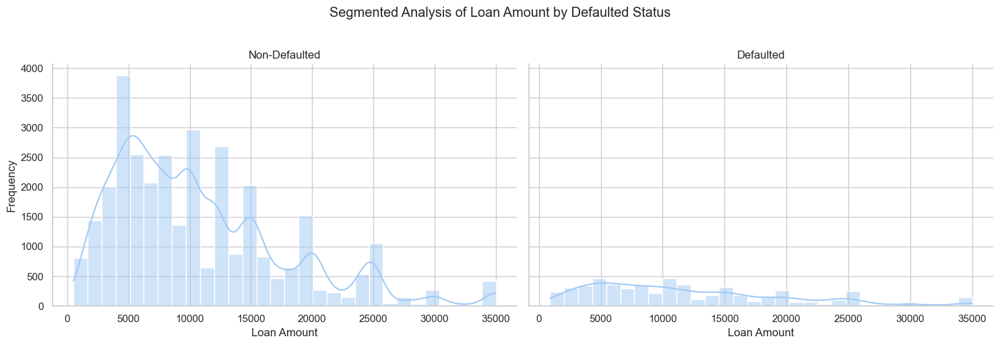

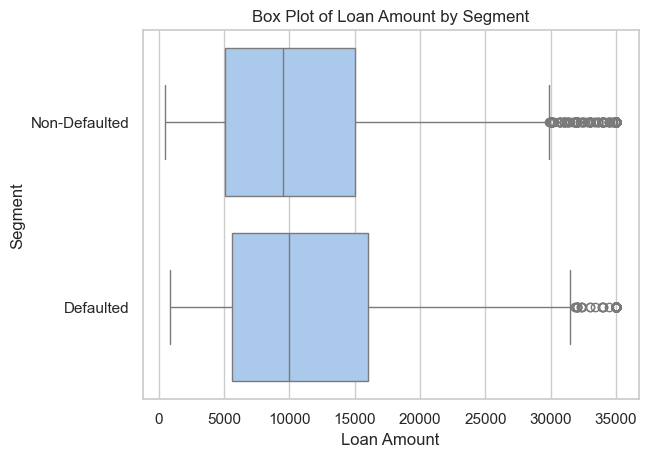

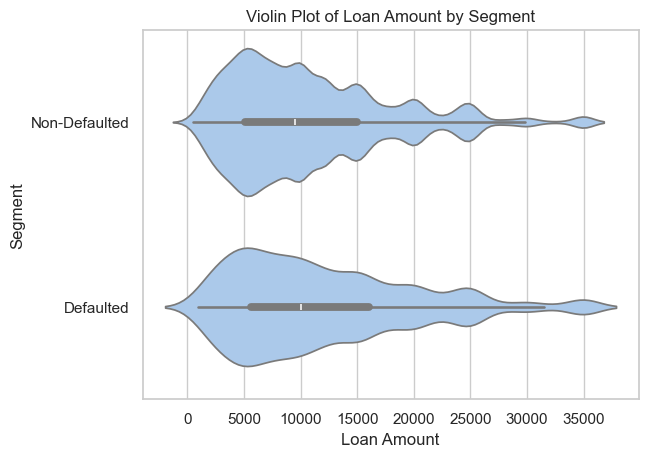

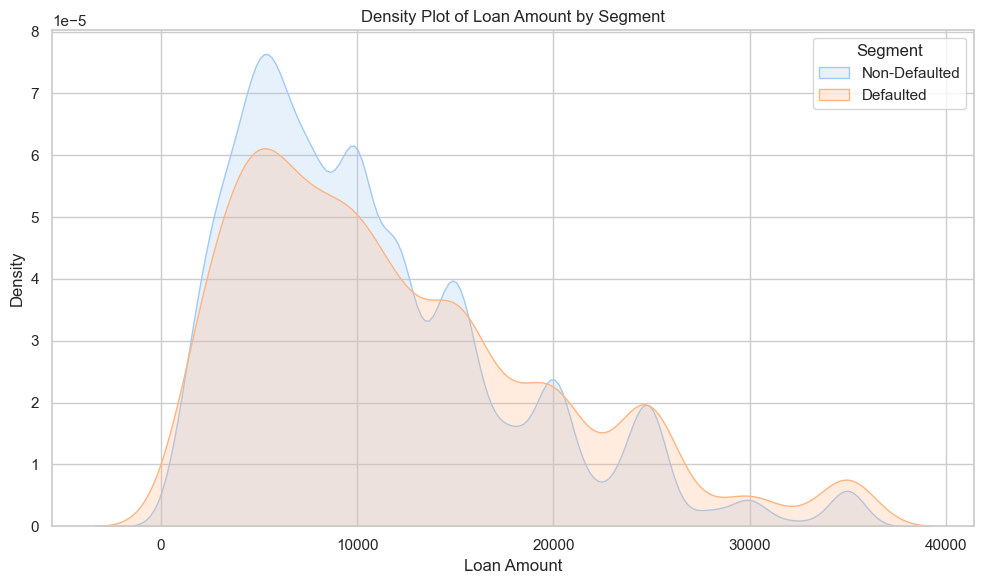

In [257]:
# loan_amnt
segmented_univariate_analysis_by_column(loan_df, "loan_amnt", "default_status_binary",col_name_label='Loan Amount', segment_col_name_label ="Defaulted Status")


In [258]:
# Inference
# Higher loan amounts has a higher likelyhood of default
# The 25th and 50th percentile(median) values of both segments are close but defaulted is slightly towards the higher side
# The IQR is broader for defaulted, suggesting higher variability in loan amounts for defaulters.


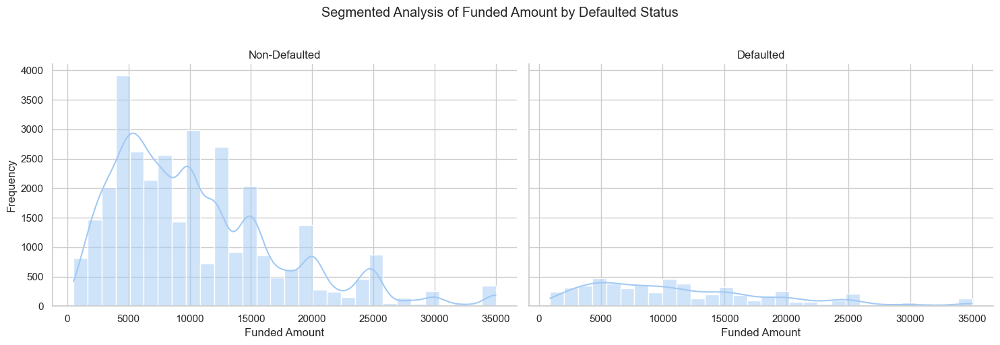

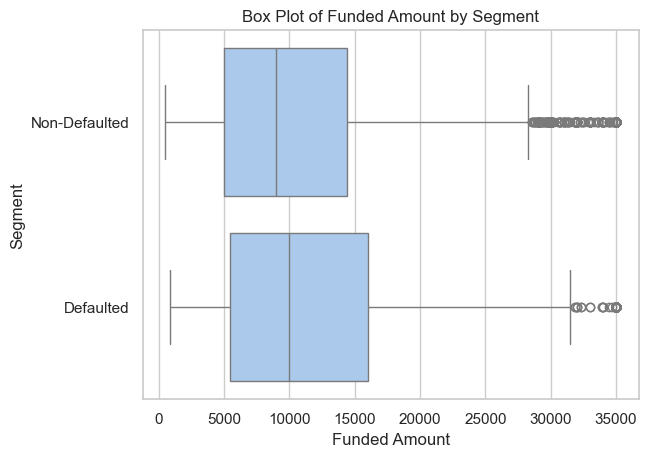

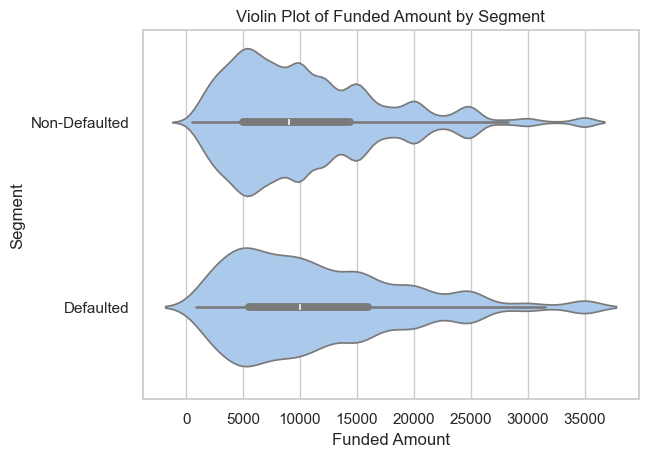

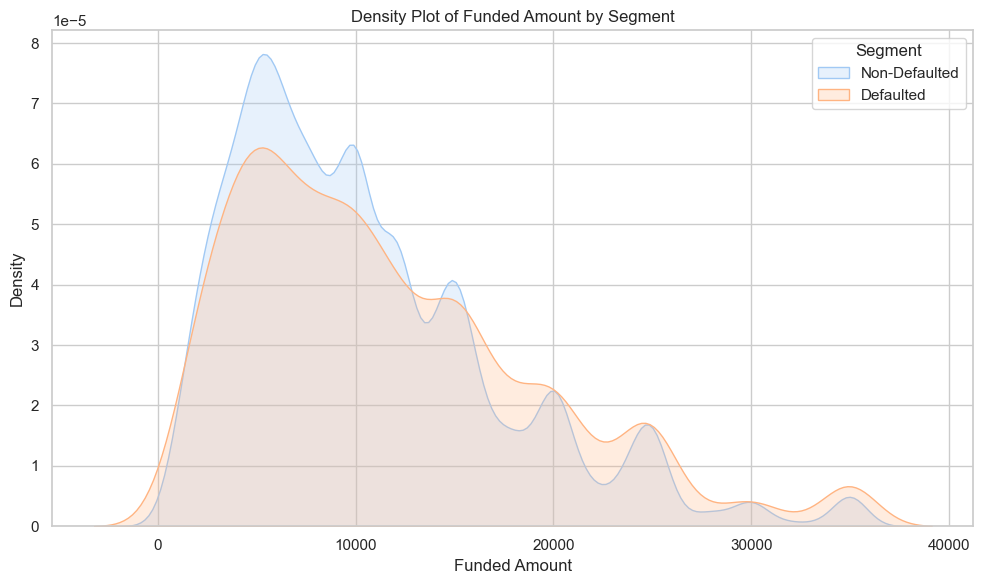

In [259]:
# funded_amnt

segmented_univariate_analysis_by_column(loan_df, "funded_amnt", "default_status_binary",col_name_label='Funded Amount', segment_col_name_label ='Defaulted Status')


In [260]:
# Inference
# Funded amount distribution is very similar to loan amount. This would imply that most of the funded amounts were
# similar to loan amounts applied for.

In [261]:
# Analyze interest rate

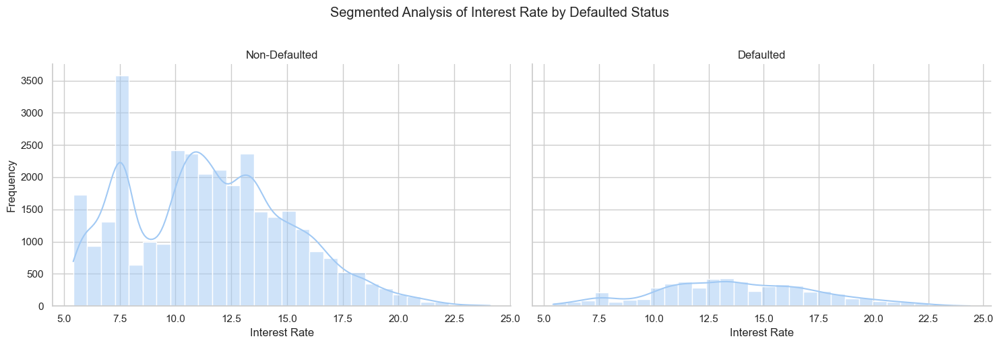

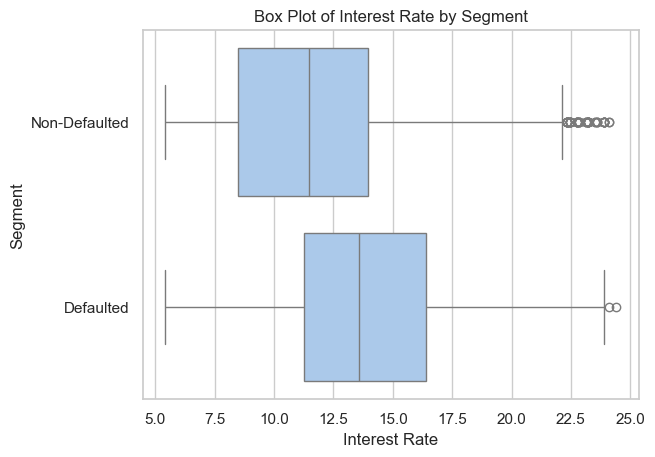

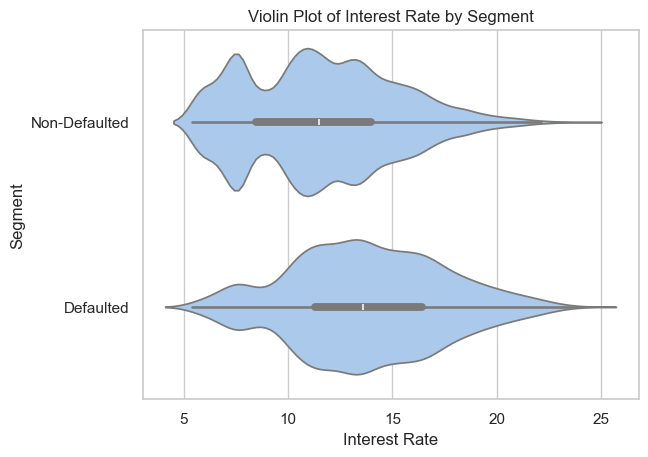

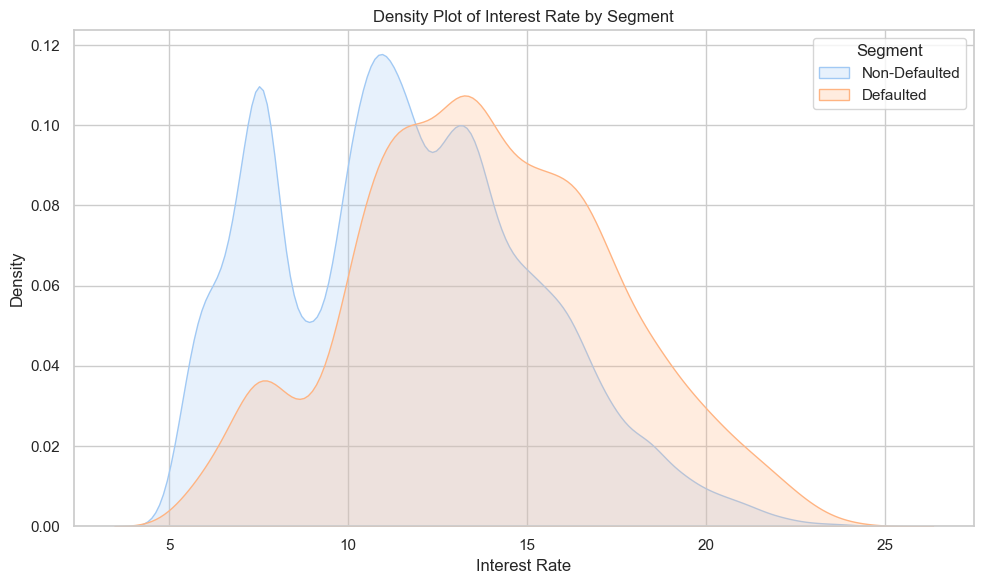

In [262]:
segmented_univariate_analysis_by_column(loan_df, "int_rate", "default_status_binary",col_name_label='Interest Rate',segment_col_name_label ='Defaulted Status')


In [263]:
# Inference
# Loans of higher interest rates had more defaults
# The higher interest rates associated with Charged Off loans might suggest that these loans were given to riskier applicants, 
# leading to defaults.
# Borrowers with higher interest rates have a greater likelihood of default, as seen by the increased proportion of charged-off loans.



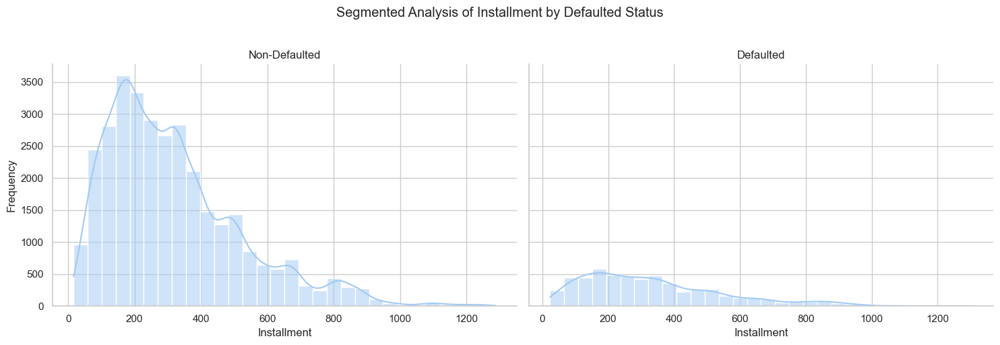

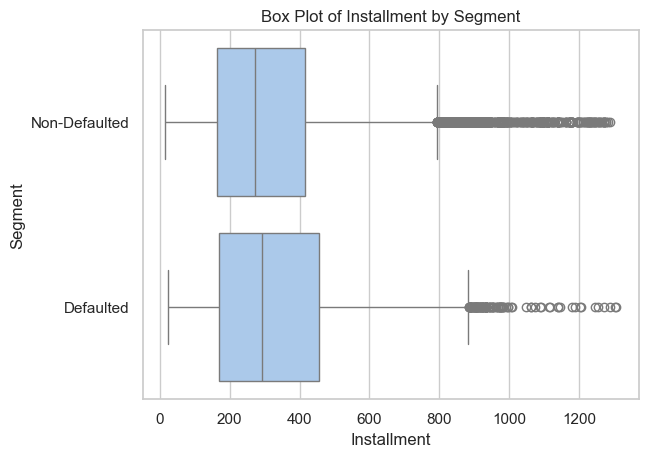

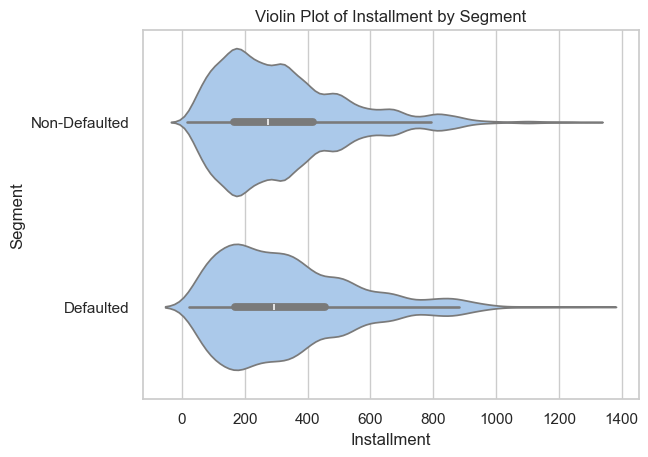

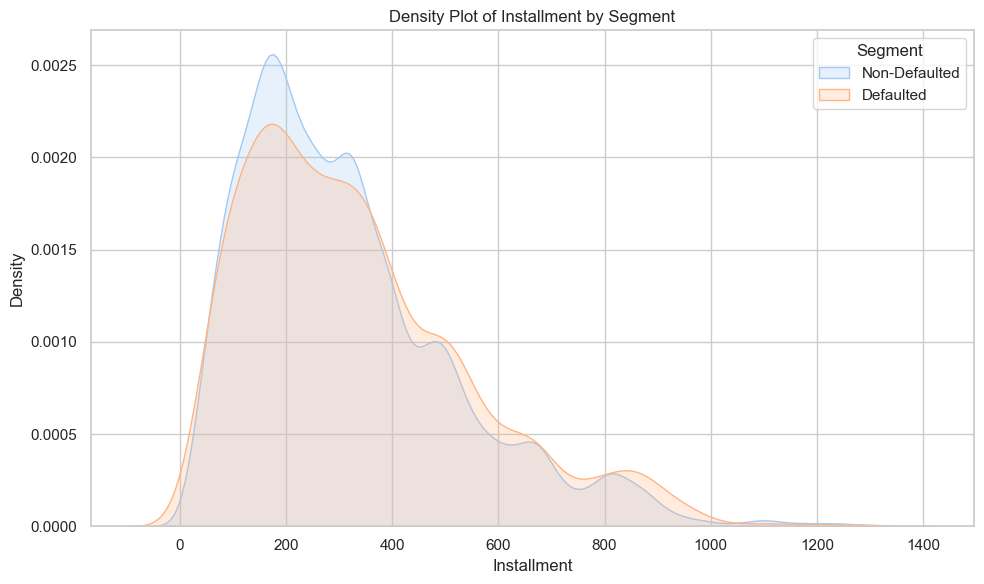

In [264]:
# installment
segmented_univariate_analysis_by_column(loan_df, "installment", "default_status_binary",col_name_label='Installment',segment_col_name_label ='Defaulted Status')


In [265]:
# Inference
# The IQR (Interquartile Range) of defaulted loans is wider, indicating significant variability in installment amounts.
# This implies that defaults occur across a broad range of loan sizes, not restricted to low or high amounts.
# Towards the right of the overlapping KDE curves, the defaulted curve gets higher showing that higher installments
# had relatively higher defaults

In [266]:
# grade by loan status

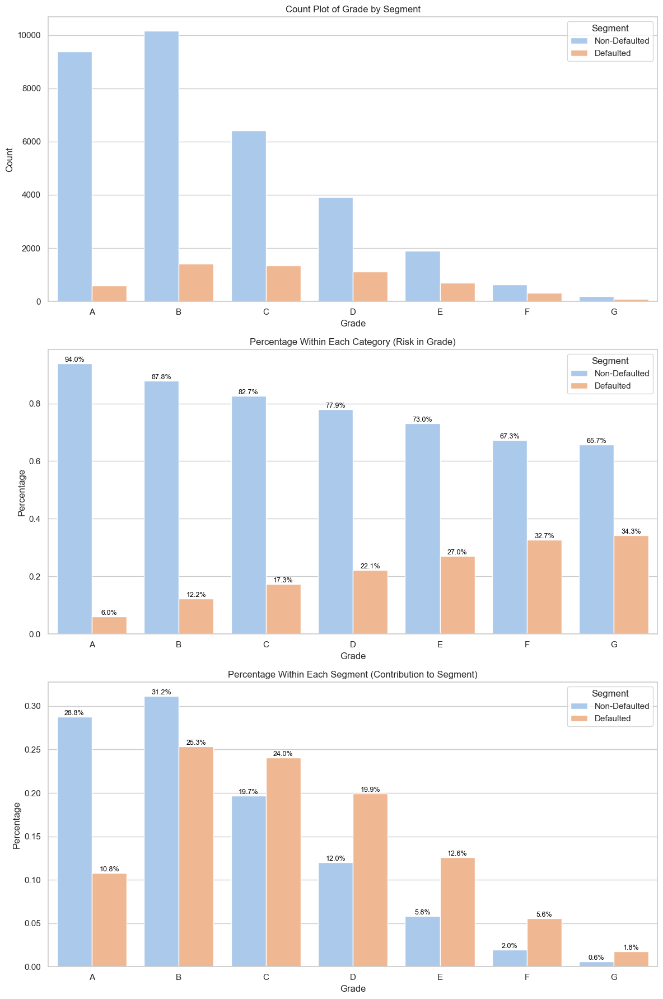

In [267]:
segmented_univariate_analysis_by_column(loan_df, "grade", "default_status_binary",col_name_label='Grade', segment_col_name_label ='Defaulted Status')


In [268]:
# Inference
# "Charged Off" loans (defaults) are more in proportion in lower grades (C,D, E, F, G), indicating higher risk in these categories.
# From the Percentage Within Each Category plot, almost a linear increase of default rate is seen towards lower grades
# The Percentage Within Each Segment plot(Contribution to Segment) shows what portion of all defaults/non defaults come from each Grade
# From the Percentage Within Each Segment plot, the highest contribution of defaults and non defaults is from Grade B, which also has the highest number of loans given



In [269]:
# sub grade by loan status

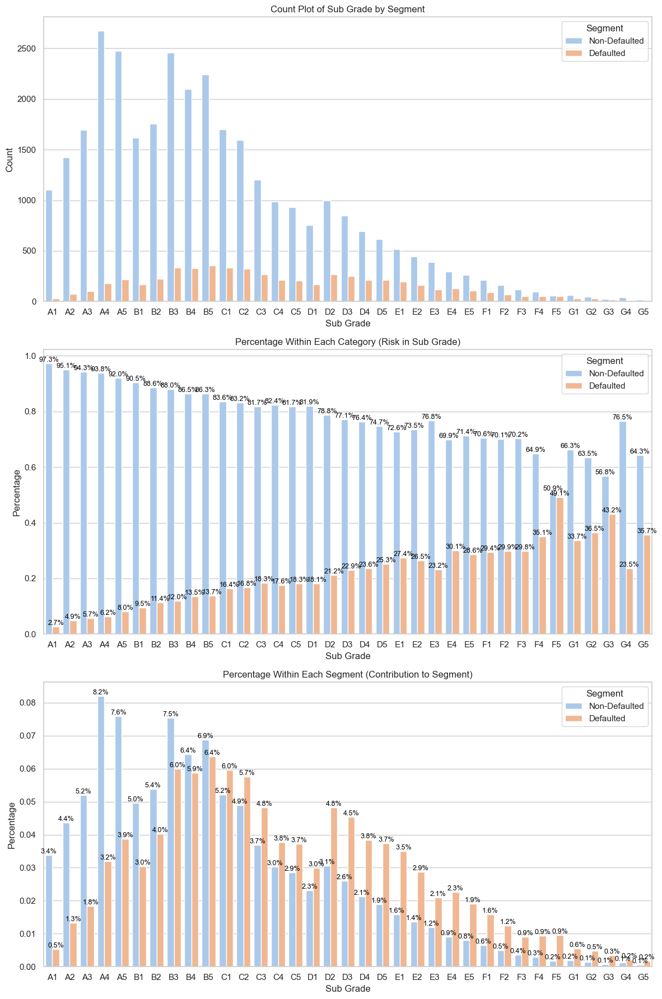

In [270]:
segmented_univariate_analysis_by_column(loan_df, "sub_grade", "default_status_binary",col_name_label='Sub Grade', segment_col_name_label ='Defaulted Status')


In [271]:
# Inference
# The proportion of "Charged Off" loans (orange bars) increases in lower sub-grades, indicating higher risk associated with these categories.
# The increase towards lower grades shows some variations, but overall it is a linear increase at a higher level. 
# There is a significantly higher default rate in F5 and G3
# The variations could suggest that the sub grade definition and risk factors analyzed to allocate subgrades may need to be revised
# and updated

# From the plot Percentage Within Each Segment (Contribution to Segment), it is clear that the lower subgrades are contributing proportionately
# higher to the defaults than the non defaults



In [272]:
# purpose

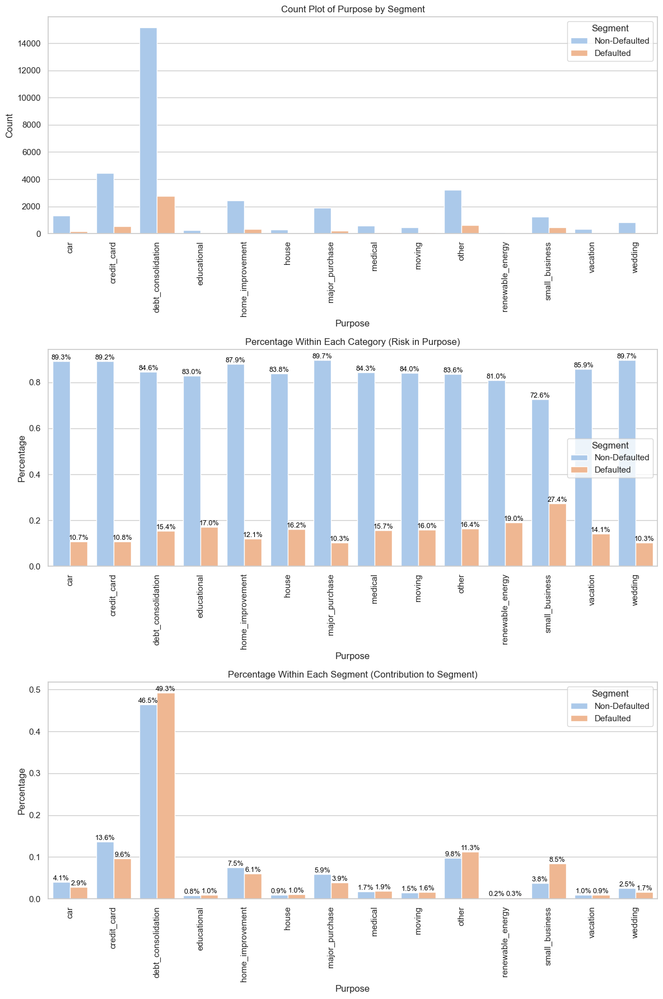

In [273]:
segmented_univariate_analysis_by_column(loan_df, "purpose", "default_status_binary",col_name_label='Purpose',segment_col_name_label ='Defaulted Status',x_axis_label_rotation=90)


In [274]:
# Inference
# Small business purpose, has proportionately highest number of defaulted loans
# Renewable energy comes next in the percentage of defaulted loans
# Debt consolidation has the highest number of loans in the fully paid and charged off status


In [275]:
# Analyze term_in_months by loan_status

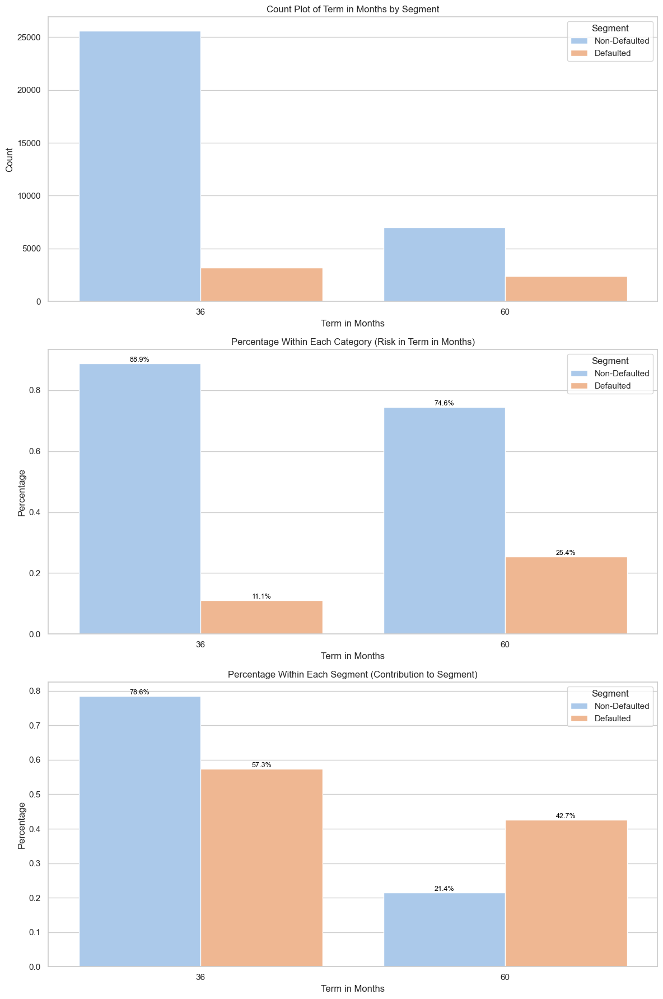

In [276]:
segmented_univariate_analysis_by_column(loan_df, "term_in_months", "default_status_binary",col_name_label='Term in Months',segment_col_name_label ='Defaulted Status')


In [277]:
# Inference
# The proportion of loans "Charged Off" is relatively higher for 60-month terms compared to 36-month terms. 

# Loans with longer terms (60 months) are associated with higher default rates (Charged Off). 
# This suggests longer loan terms may be riskier.


In [278]:
# Analyze loan_size_category by loan_status

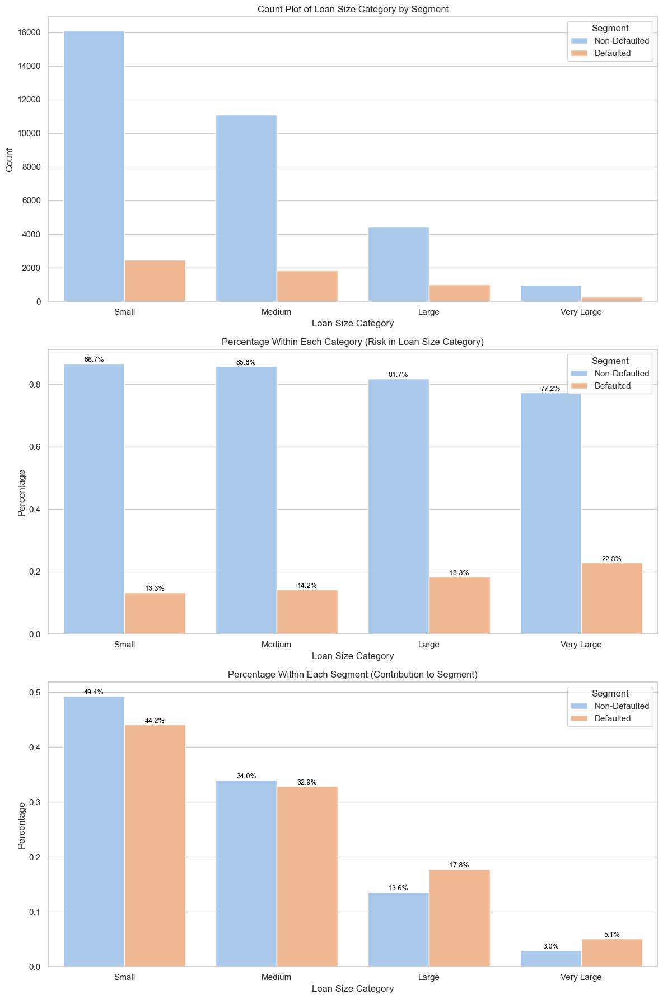

In [279]:
segmented_univariate_analysis_by_column(loan_df, "loan_size_category", "default_status_binary",col_name_label='Loan Size Category',segment_col_name_label ='Defaulted Status')


In [280]:
# Inference
# As the loan size increases, the proportion of Charged Off loans also increases, 
# showing a strong correlation between loan size and default risk.

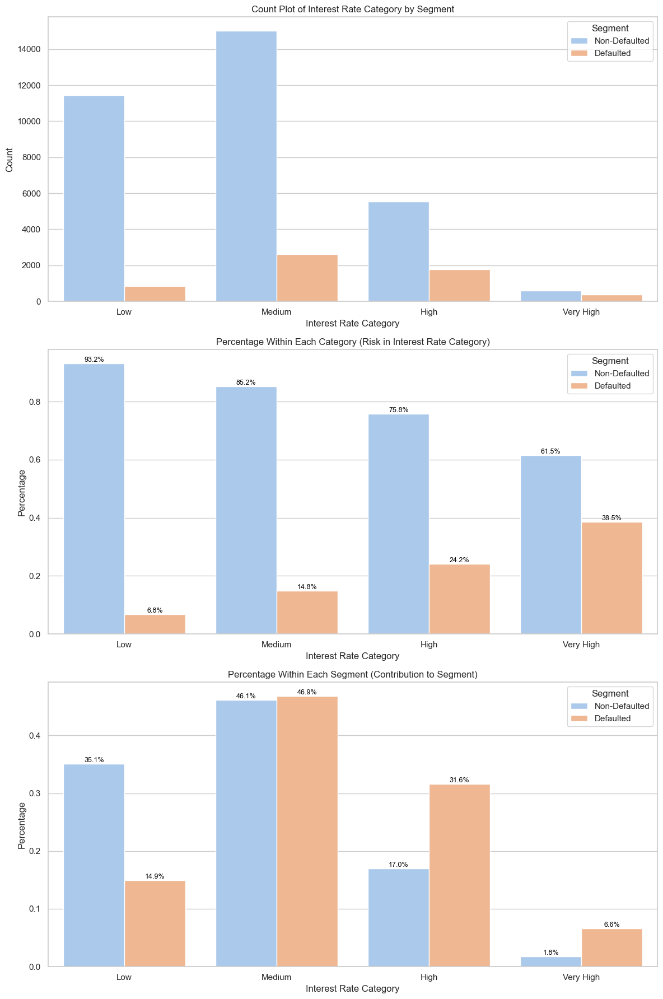

In [281]:
segmented_univariate_analysis_by_column(loan_df, "int_rate_category", "default_status_binary",col_name_label='Interest Rate Category',segment_col_name_label ='Defaulted Status')


In [282]:
# Inference
# The proportion of defaulted loans increases almost linearly when the interest increases.
# Higher interest category has higher defaults
# Loans in the Medium interest rate category have the highest contribution in both segments
# High interest rate category contributes 31.6% of Defaulted loans, which is much higher than its contribution to Non-Defaulted loans (17.0%).
# The Very High interest rate category contributes very little to Non-Defaulted loans (1.8%) but has a higher proportional 
# contribution to Defaulted loans (6.6%).


In [283]:
# loan_issue_month by loan status

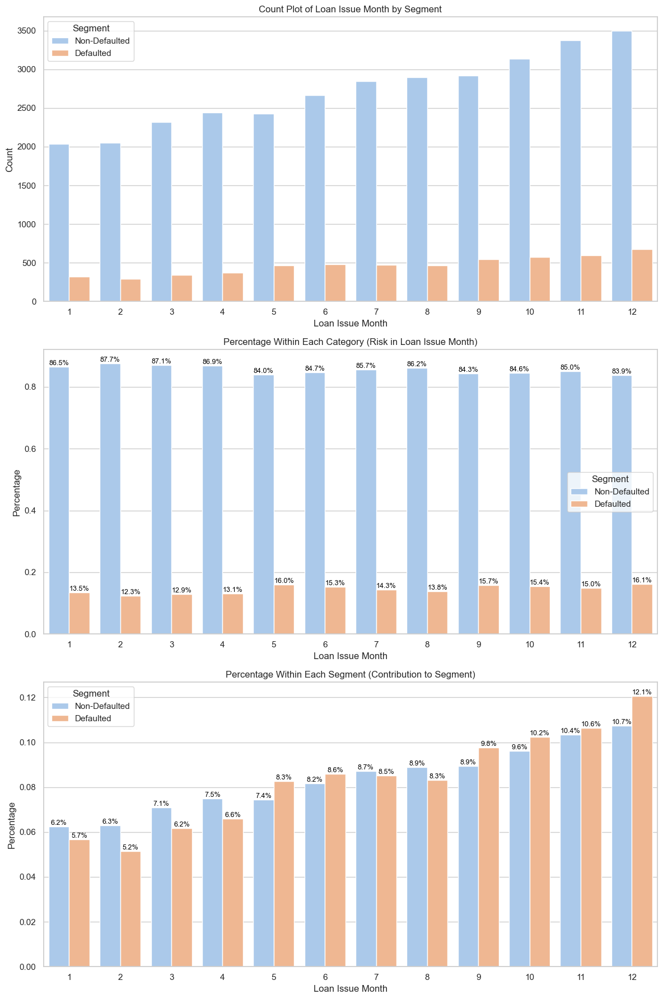

In [284]:
segmented_univariate_analysis_by_column(loan_df, "loan_issue_month", "default_status_binary",col_name_label='Loan Issue Month',segment_col_name_label ='Defaulted Status', analysis_type='categorical')


In [285]:
# The proportion of Defaulted loans (orange) is generally consistent, ranging from 12.3% to 16.1% across all months.
# Loans issued in May and December have the highest proportion of defaults relative to other months, but not a significant difference

In [286]:
# loan_issue_year by loan_status

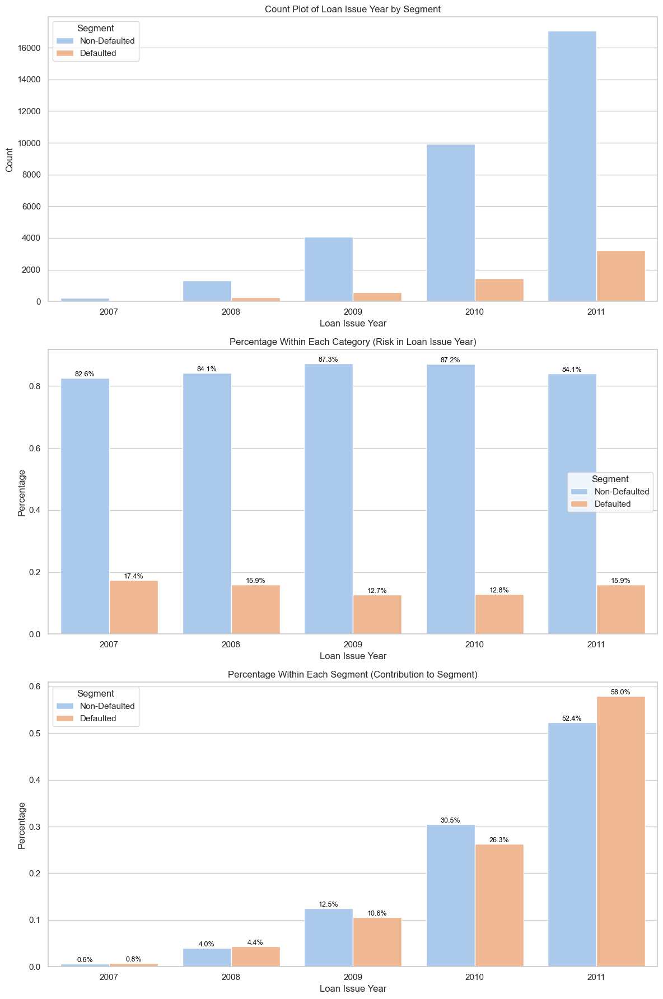

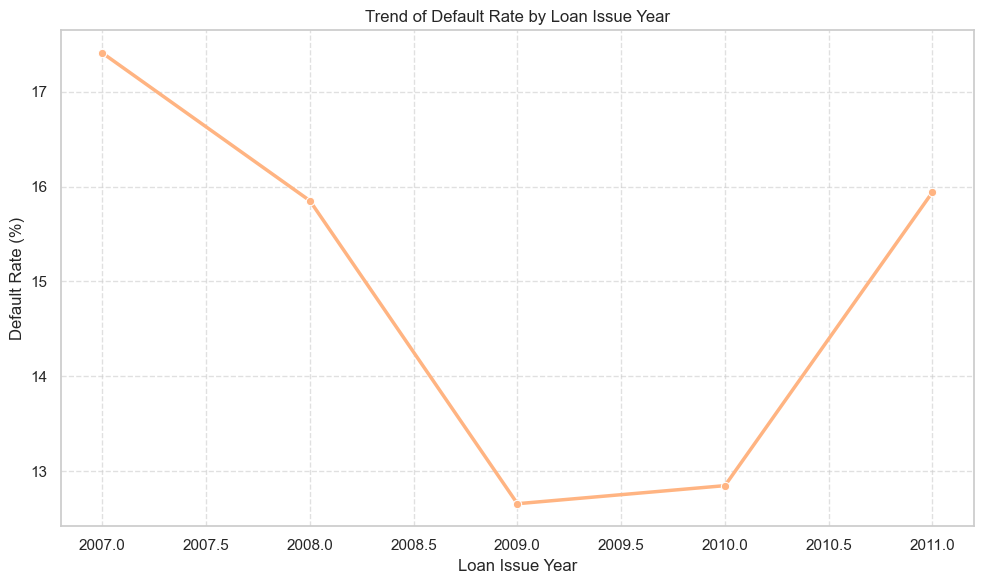

In [287]:
# Plot with line chart to see the trend over years
segmented_univariate_analysis_by_column(loan_df, "loan_issue_year", "default_status_binary",col_name_label='Loan Issue Year',segment_col_name_label ='Defaulted Status', analysis_type='categorical', include_line_chart_categorical=True)



In [288]:
# Inference
# Loan issuance grew steadily from 2007 to 2011, with a significant spike in 2011.
# Default risk decreased over time, peaking in 2007 (17.4%) and dropping to its lowest in 2009
# While the default rate has improved over time till 2009,it started increasing slowly and had a steep significant increase in 2011
# This indicates a need for better risk mitigation stratgies




In [289]:
# verification_status segmented by loan_status

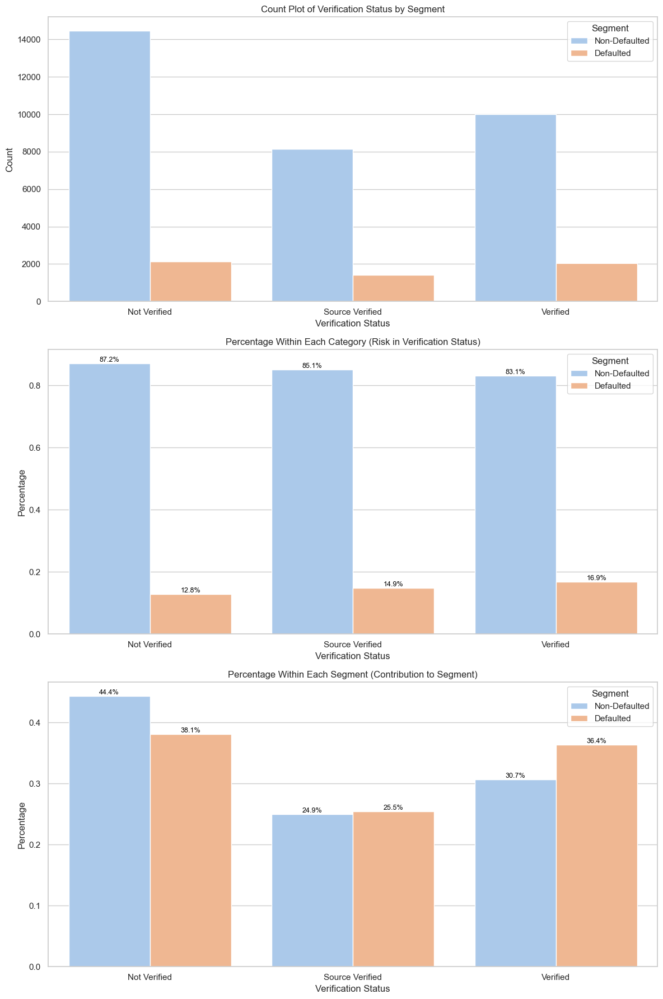

In [290]:
segmented_univariate_analysis_by_column(loan_df, "verification_status", "default_status_binary",segment_col_name_label ='Defaulted Status')

In [291]:
# Inference
# Contrary to expectations, the proportion of Charged Off loans (orange bars) is actually higher 
# in the Verified and Source Verified categories compared to the Not Verified category.

In [292]:
# issue_d

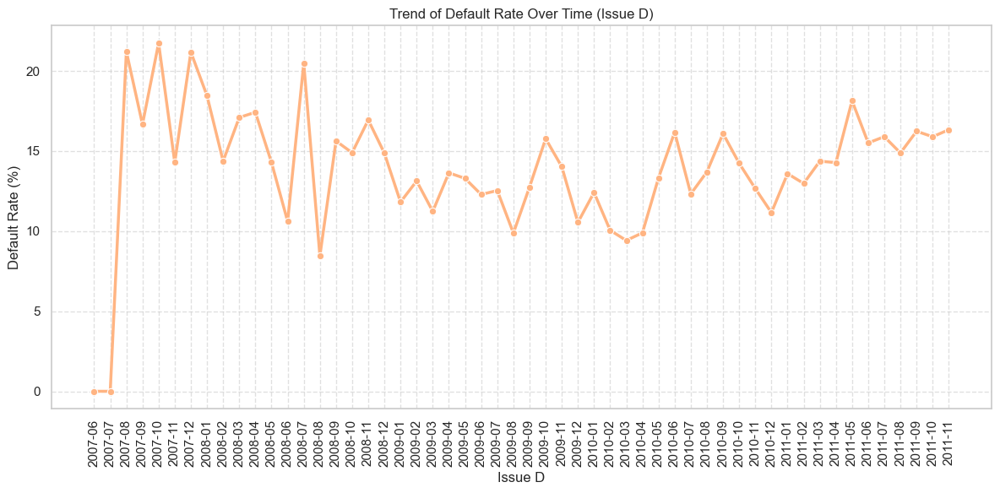

In [293]:
segmented_univariate_analysis_by_column(loan_df, "issue_d", "default_status_binary", x_axis_label_rotation=90)

In [294]:
# Inference
# The default rate shows significant variability over time
# Certain periods show relatively lower default rates. But toward the end of the timeline, there is a noticeable rise in default rates
# We already saw yearly analysis earlier that is aggregated and gives a better insights. This plot 
# is more detailed and may be difficult to infer


In [295]:
# addr_state segmented by loan_status

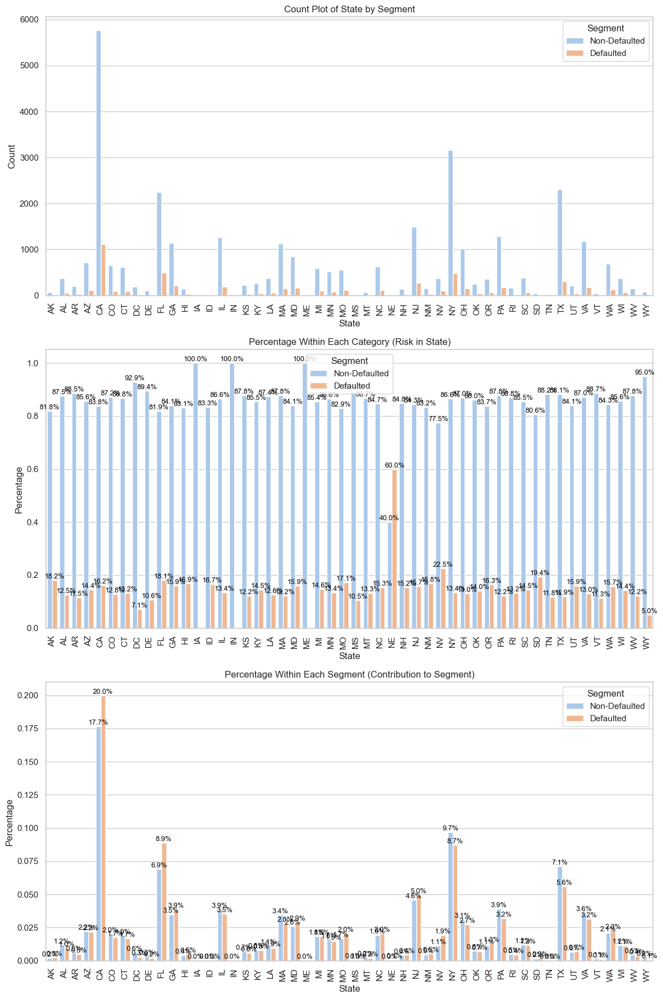

In [296]:
segmented_univariate_analysis_by_column(loan_df, "addr_state", "default_status_binary",col_name_label="State", x_axis_label_rotation=90)

In [297]:
# Inference
# Larger states like CA, NY, and FL have higher absolute counts of Charged Off loans due to their overall loan volume.

In [298]:

# NE (Nebraska) has the highest default rate, followed by NV (Nevada), SD (South Dakota), and AK (Alaska).
# These states represent higher financial risk for loans, possibly due to economic conditions or borrower profiles

# States such as ME (Maine), IN (Indiana), and IA (Iowa) have the lowest default rates, indicating relatively stable repayment patterns.
# These states could be safer regions for loan disbursement.

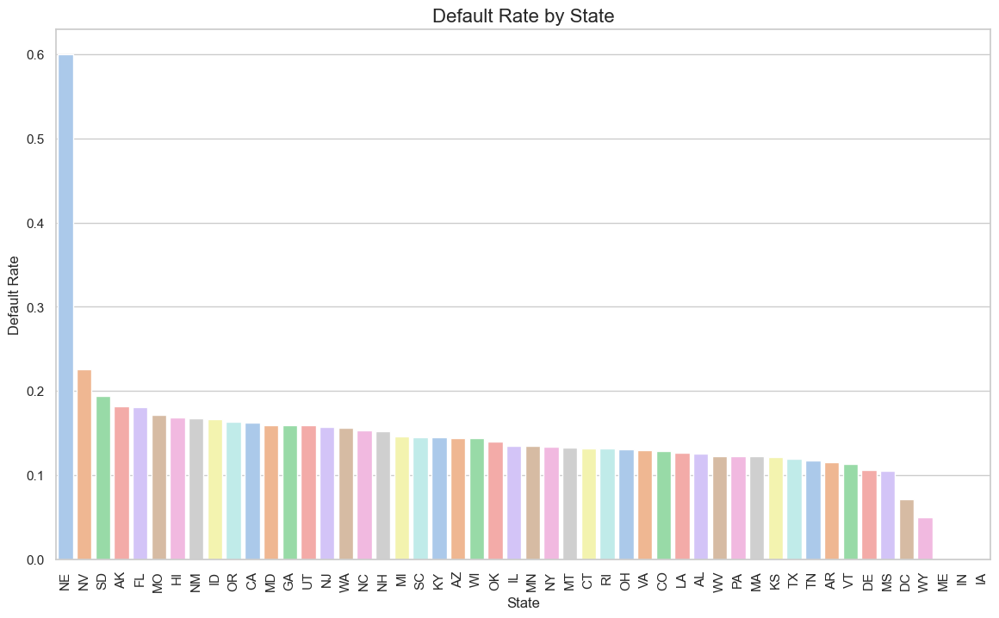

In [299]:
# The above graph is a little cluttered due to the large number of states
# Create another chart with just the default rates and loan_status for presentation use

# Calculate default rates by state
state_counts = loan_df.groupby(['addr_state', 'loan_status']).size().unstack(fill_value=0)
state_counts['Total Loans'] = state_counts.sum(axis=1)
state_counts['Default Rate'] = state_counts['Charged Off'] / state_counts['Total Loans']

# Reset index for plotting
state_counts = state_counts.reset_index()

# Sort by default rate (optional)
state_counts = state_counts.sort_values(by='Default Rate', ascending=False)

# Plot using Seaborn
plt.figure(figsize=(14, 8))
sns.barplot(data=state_counts, x='addr_state', y='Default Rate', palette='pastel')
plt.title('Default Rate by State', fontsize=16)
plt.xlabel('State', fontsize=12)
plt.ylabel('Default Rate', fontsize=12)
plt.xticks(rotation=90)
plt.show()

In [300]:
#  analyze dti (Debt-to-Income Ratio) segmented by loan_status

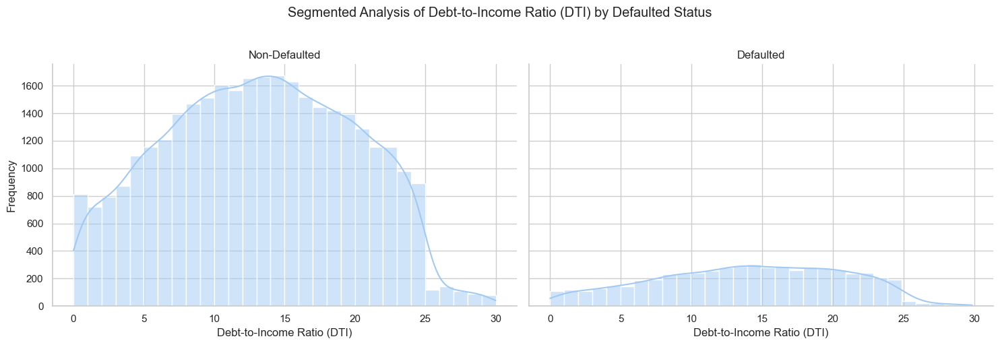

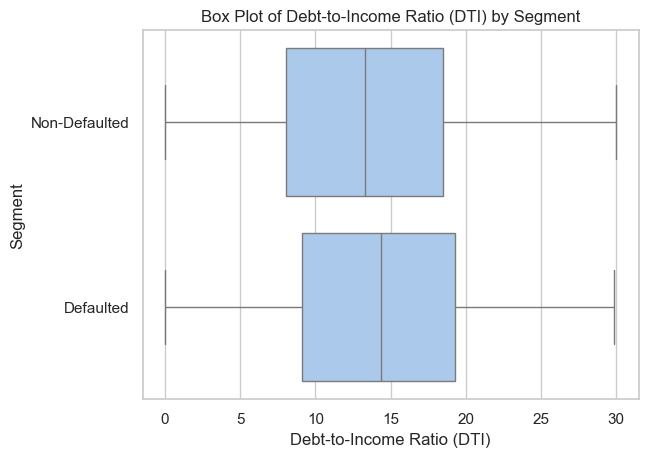

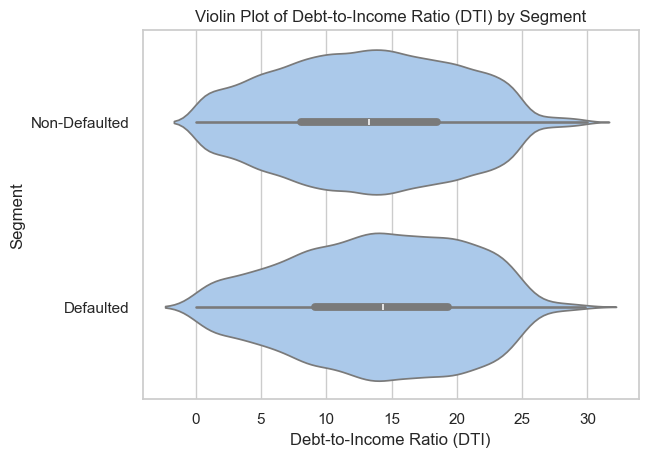

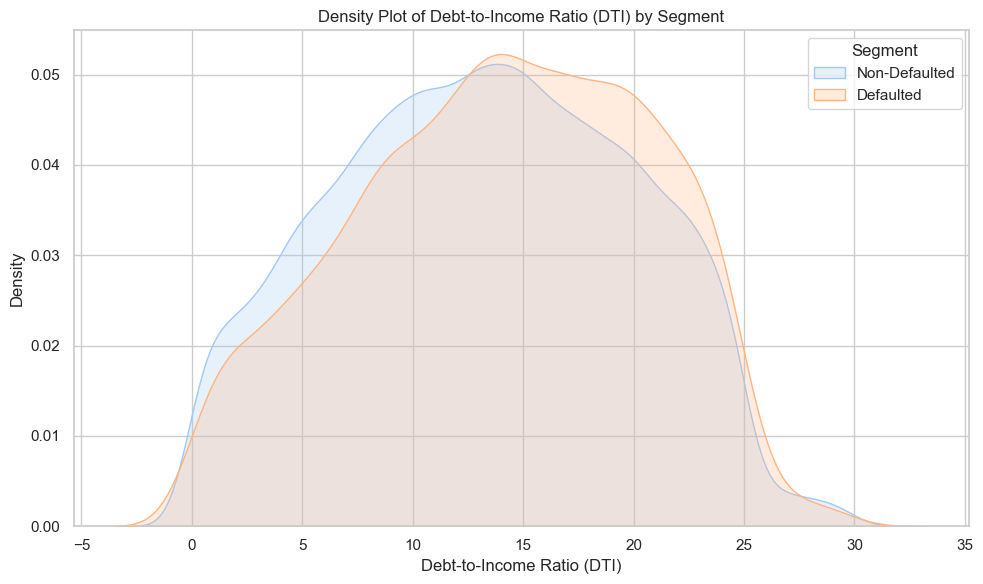

In [301]:
segmented_univariate_analysis_by_column(loan_df, "dti", "default_status_binary",col_name_label="Debt-to-Income Ratio (DTI)",segment_col_name_label ='Defaulted Status')

In [302]:
# Inference
# Loans with a DTI in the range of 10 to 20 are prominent in both defaulted and non-defaulted categories.
# For DTI values above approximately 14, the density for defaulted loans exceeds that of non-defaulted loans, 
# indicating that borrowers with a higher DTI are more likely to default.



In [303]:
# LTI by loan_status

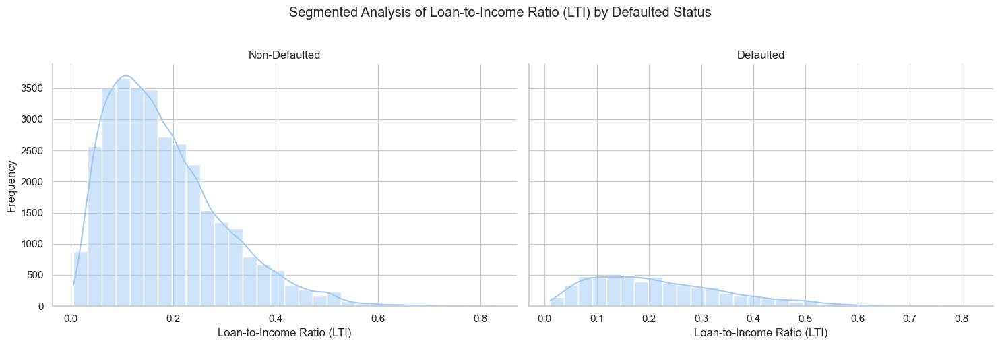

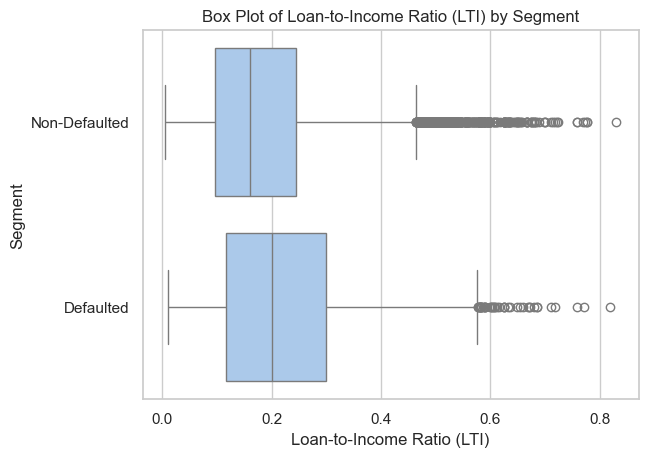

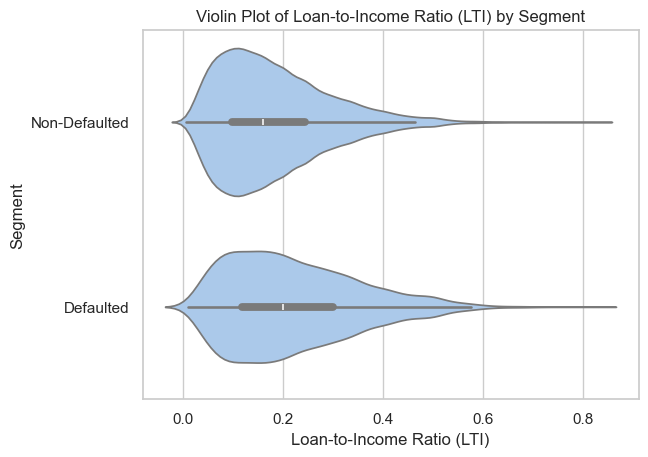

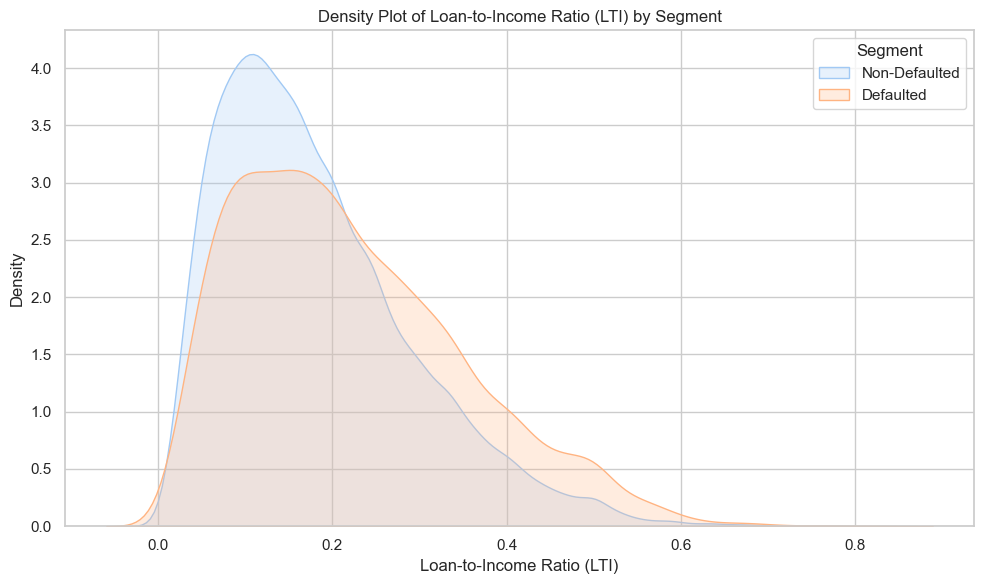

In [304]:
segmented_univariate_analysis_by_column(loan_df, "lti", "default_status_binary",col_name_label="Loan-to-Income Ratio (LTI)",segment_col_name_label ='Defaulted Status')



In [305]:
# Inference
# The orange density curve (Defaulted) shifts slightly to the right compared to the blue curve (Non-Defaulted), 
# indicating that borrowers with a higher Loan-to-Income ratio are more likely to default.

# The Non-Defaulted loans peak at a slightly lower LTI value compared to the Defaulted loans, 
# this suggests that lower LTIs are associated with lower default risks.




In [306]:
# pub_rec_bankruptcies

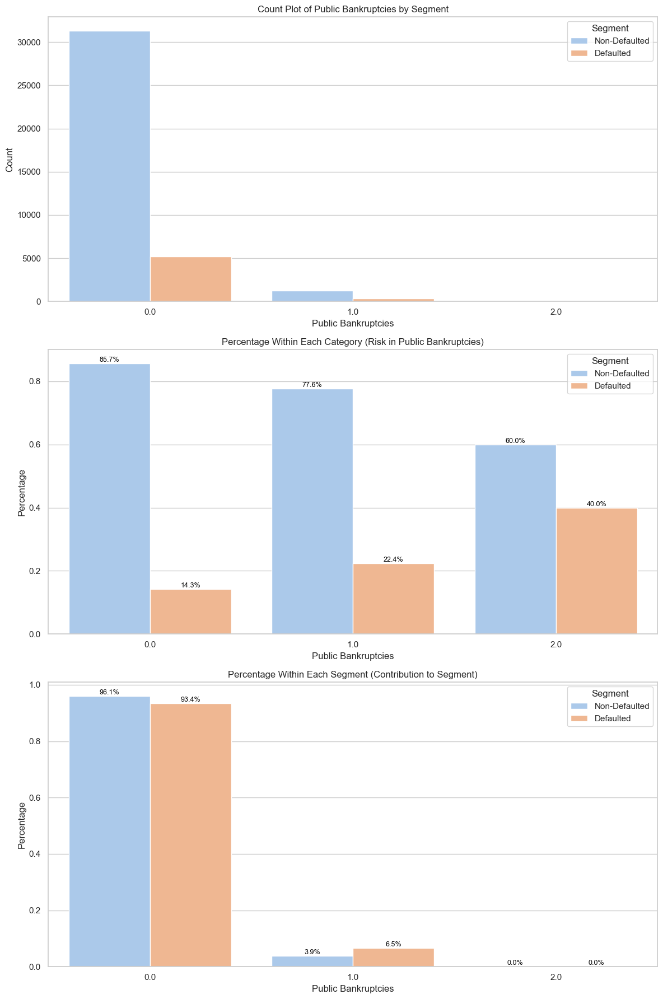

In [307]:
segmented_univariate_analysis_by_column(loan_df, "pub_rec_bankruptcies", "default_status_binary",col_name_label="Public Bankruptcies",segment_col_name_label ='Defaulted Status')


In [308]:
# Inference
# The percentage of defaulted loans increases with increase in number of bankruptcies showing an increasing risk.
# Borrowers with no history of bankruptcies have the highest non defaulted loans

In [309]:
# emp_length

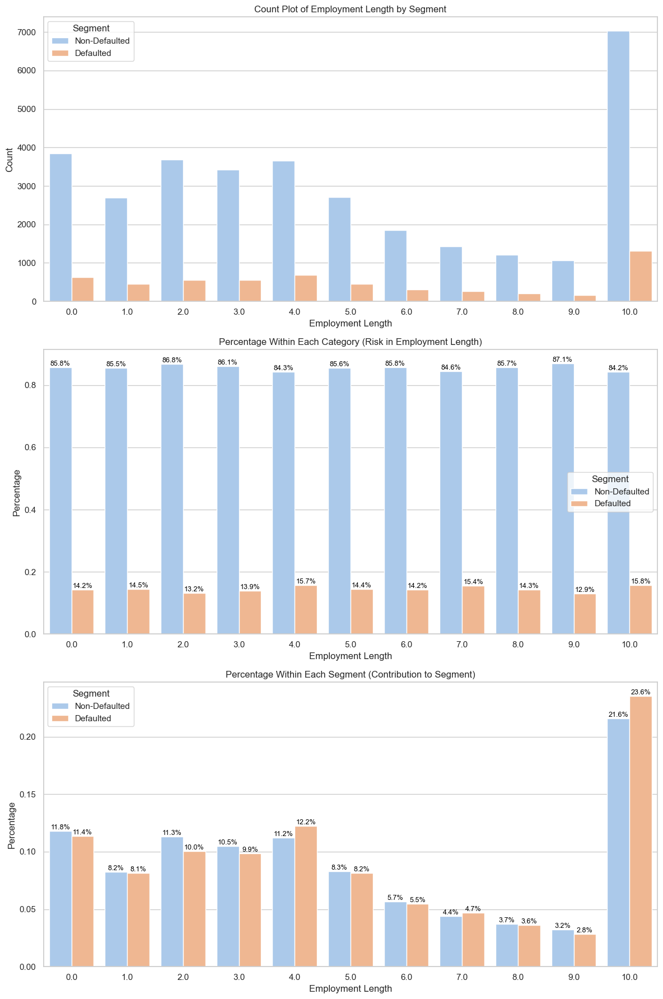

In [310]:
segmented_univariate_analysis_by_column(loan_df, "emp_length", "default_status_binary",col_name_label="Employment Length",segment_col_name_label ='Defaulted Status', analysis_type='categorical')


In [311]:
# Inference
# It seems there is no clear, strong differentiating factor between employment length and default rate. 
# The distribution of default rates across employment lengths seems fairly similar, with some minor variations that might not be statistically significant.



In [312]:
# home_ownership

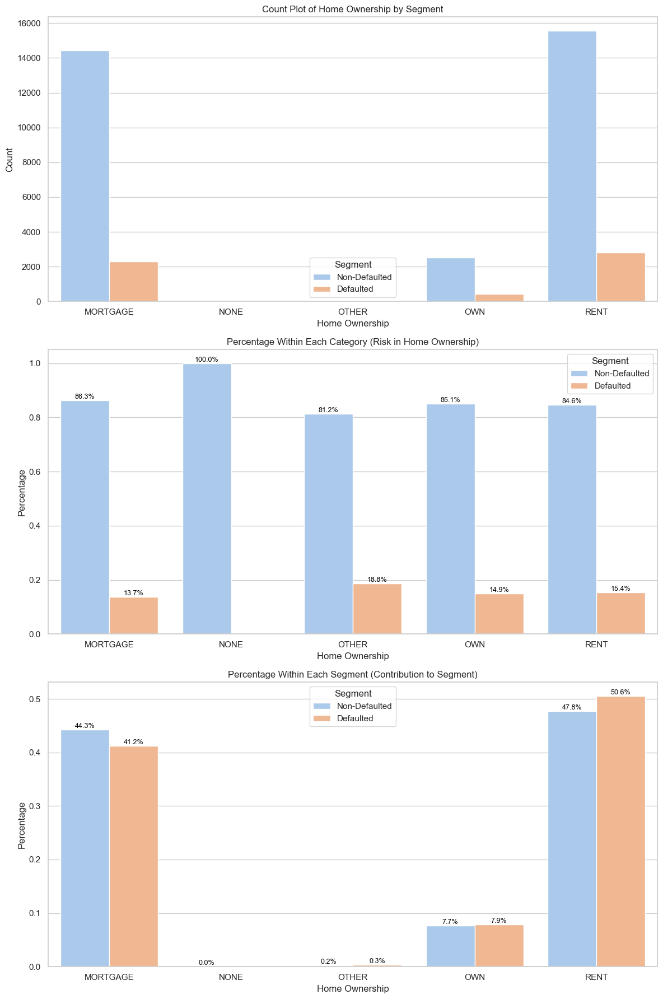

In [313]:
segmented_univariate_analysis_by_column(loan_df, "home_ownership", "default_status_binary",col_name_label="Home Ownership",segment_col_name_label ='Defaulted Status', analysis_type='categorical')


In [314]:
# Inference
# Borrowers in the "Other" homeownership category have the highest default ratio, indicating they are the riskiest group.
# Borrowers who rent or own homes have similar default ratios, slightly lower than "Other."
# Borrowers with a mortgage show the lowest default ratio, suggesting they are relatively lower risk.


In [315]:

# annual_inc

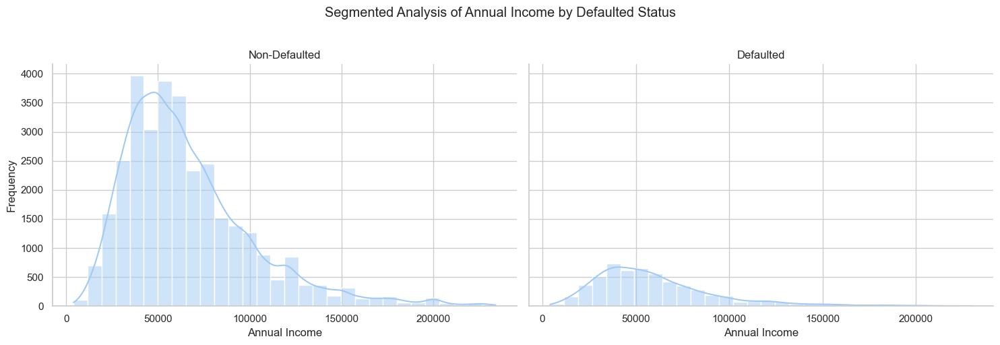

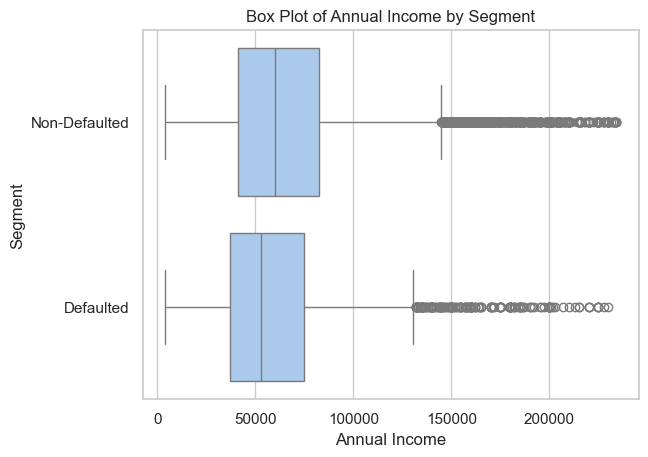

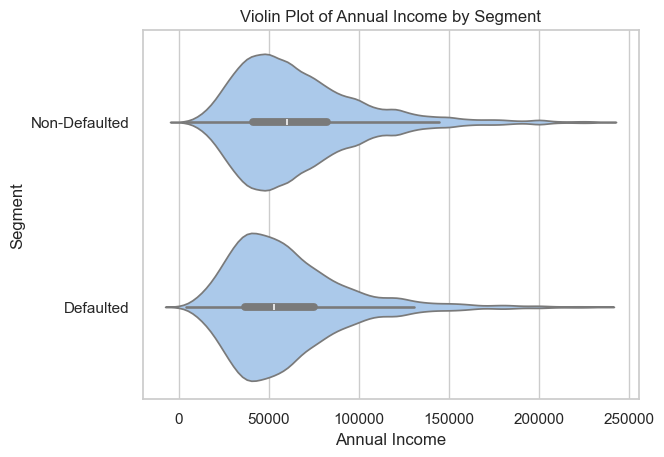

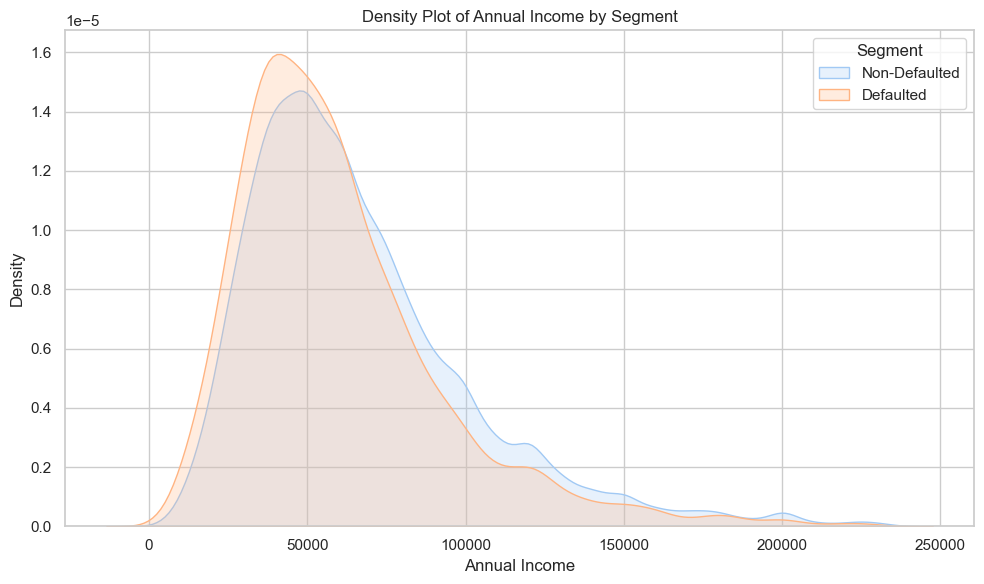

In [316]:
segmented_univariate_analysis_by_column(loan_df, "annual_inc", "default_status_binary",col_name_label="Annual Income",segment_col_name_label ='Defaulted Status')


In [317]:
# Inference
# The proportion of charged-off loans is higher for borrowers in lower income ranges, indicating higher default rates among low-income groups.

#### Univariate Analysis completed

---

## Bivariate Analysis

In [318]:
# Create utility functions for bivariate analysis

In [319]:
# Function to create scatterplots of numerical variable combinations
def plot_scatter_combinations(df, numerical_columns, hue_column):
    """
    Generate scatter plots for all combinations of numerical columns with a hue.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
        numerical_columns (list): A list of numerical column names.
        hue_column (str): The column used for coloring the scatter plots.

    Returns:
        None
    """
    # Check if all columns exist in the DataFrame
    columns_with_missing_values = [col for col in numerical_columns + [hue_column] if col not in df.columns]
    if columns_with_missing_values:
        print(f"Missing columns in DataFrame: {columns_with_missing_values}")
        return

    # Generate all combinations of numerical columns (pairwise)
    combinations = list(itertools.combinations(numerical_columns, 2))

    # Plot scatter plots for each combination
    for x_col, y_col in combinations:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=df, x=x_col, y=y_col, hue=hue_column, palette="pastel", alpha=0.7)
        plt.title(f"Scatter Plot: {x_col} vs {y_col}")
        plt.xlabel(x_col)
        plt.ylabel(y_col)
        plt.legend(title=hue_column)
        plt.grid(True, linestyle="--", alpha=0.6)
        plt.tight_layout()
        plt.show()

In [320]:
# contour plot function

def create_contour_plot(df, x_col, y_col, hue_col=None):
    """
    Create a contour plot for two numerical columns with an optional hue column.

    Parameters:
    - df (DataFrame): The dataset.
    - x_col (str): The column for the x-axis.
    - y_col (str): The column for the y-axis.
    - hue_col (str, optional): The column for the hue (categorical segmentation).
    """
    plt.figure(figsize=(10, 6))
    sns.kdeplot(
        data=df,
        x=x_col,
        y=y_col,
        hue=hue_col,
        fill=True,
        alpha=0.6,
        cmap="coolwarm",
        levels=20  # Adjust levels for contour granularity
    )
    plt.title(f"Contour Plot of {x_col} and {y_col}" + (f" by {hue_col}" if hue_col else ""))
    plt.xlabel(x_col)
    plt.ylabel(y_col)
    plt.tight_layout()
    plt.show()


In [321]:
# Function to plot contour plots of numerical variable combinations
def plot_contour_combinations(df, numerical_columns, hue_column):
    """
    Generate contour plots for all combinations of numerical columns with a hue.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
        numerical_columns (list): A list of numerical column names.
        hue_column (str): The column used for separating the contour plots.

    Returns:
        None
    """
    import itertools

    # Check if all columns exist in the DataFrame
    columns_with_missing_values = [col for col in numerical_columns + [hue_column] if col not in df.columns]
    if columns_with_missing_values:
        print(f"Missing columns in DataFrame: {columns_with_missing_values}")
        return

    # Generate all combinations of numerical columns (pairwise)
    combinations = list(itertools.combinations(numerical_columns, 2))

    # Iterate over all combinations and create contour plots using create_contour_plot
    for x_col, y_col in combinations:
        create_contour_plot(df, x_col, y_col, hue_col=hue_column)

In [322]:
# Function to create cross-tabulation of columns and create a stacked bar chart

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def plot_cross_tab_stacked_bar(df, combination_columns, target_column):
    """
    Creates a horizontal stacked bar plot for a combination of categorical columns against a target column.
    
    Parameters:
        df (pd.DataFrame): The input DataFrame.
        combination_columns (list): List of columns to combine for the index.
        target_column (str): The target column to calculate proportions.
    """
    # Create a cross-tabulation
    stacked_data = pd.crosstab(
        index=[df[col] for col in combination_columns],
        columns=df[target_column],
        normalize='index'
    )
    
    # Reset index for better display in Seaborn
    stacked_data = stacked_data.reset_index()
    
    # Melt the data for Seaborn
    stacked_data_melted = stacked_data.melt(
        id_vars=combination_columns, var_name='Default Status', value_name='Proportion'
    )
    
    # Combine columns for better visualization
    stacked_data_melted['Combination'] = stacked_data_melted[combination_columns].agg(' & '.join, axis=1)
    
    # Adjust the figure size dynamically based on the number of combinations
    fig_height = max(8, len(stacked_data_melted['Combination'].unique()) * 0.5)
    plt.figure(figsize=(12, fig_height))
    
    # Create a horizontal stacked bar plot
    sns.barplot(
        data=stacked_data_melted,
        y='Combination',  # Use 'y' instead of 'x' for horizontal bars
        x='Proportion',
        hue='Default Status',
        palette='coolwarm',
        dodge=False
    )
    
    # Set titles and labels
    plt.title('Horizontal Stacked Bar Plot', fontsize=14)
    plt.xlabel('Proportion', fontsize=12)
    plt.ylabel('Combination of ' + ' & '.join(combination_columns), fontsize=12)
    
    
    plt.legend(title='Default Status')
    plt.tight_layout()
    plt.show()


In [323]:
# create box plots between a categorical and numerical column
def plot_boxplot(data, numerical_col, categorical_col, title="Box Plot", xlabel=None, ylabel=None):
    sorted_categorical = sorted(loan_df[categorical_col].unique())
    
    plt.figure(figsize=(10,5))
    sns.boxplot(data=loan_df,x=numerical_col,y=categorical_col, order = sorted_categorical)
    plt.xlabel(numerical_col)
    plt.ylabel(categorical_col)
    plt.title(f'Comparison of {numerical_col} Based On {categorical_col}',fontsize=12)
    plt.show()

---

#### Prepare for bivariate analysis

In [324]:
# Prepare dataframe for bi variate analysis with relevant columns

# Filter for relevant columns
loan_df = loan_df[['loan_status', 'default_status_binary', 'loan_amnt', 'funded_amnt',
       'int_rate', 'installment', 'grade', 'sub_grade', 'purpose',
       'term_in_months', 'loan_size_category', 'int_rate_category',
       'loan_issue_month', 'loan_issue_year', 'verification_status', 'issue_d',
       'addr_state', 'dti', 'lti', 'pub_rec_bankruptcies', 'emp_length',
       'home_ownership', 'annual_inc']] 

target_column = 'loan_status'

numerical_columns = ['loan_amnt', 'funded_amnt', 'int_rate', 'installment','dti', 'lti', 'annual_inc']
categorical_columns = [ 'grade', 'sub_grade', 'purpose',
       'term_in_months', 'loan_size_category', 'int_rate_category',
       'loan_issue_month', 'loan_issue_year', 'verification_status',
       'addr_state', 'pub_rec_bankruptcies', 'emp_length',
       'home_ownership']


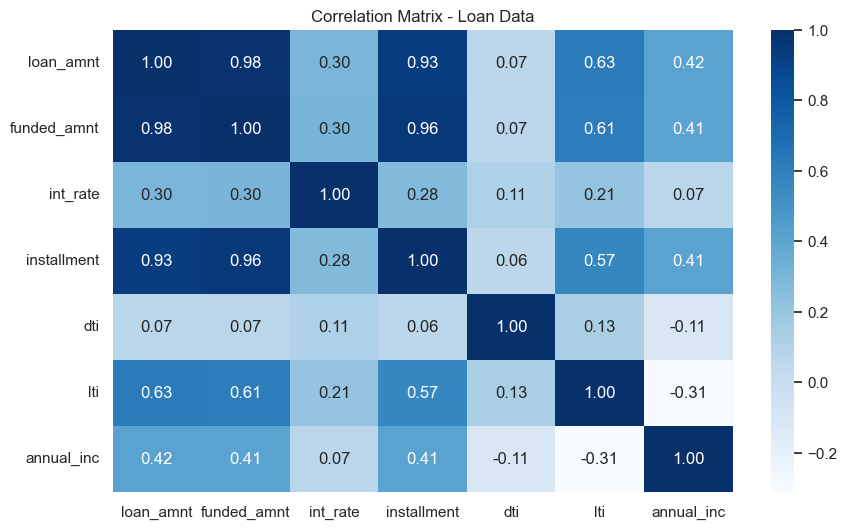

In [325]:
# Correlation Matrix for all numerical columns
correlation_matrix = loan_df[numerical_columns].corr()

# Plot the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='Blues', fmt='.2f')
plt.title('Correlation Matrix - Loan Data')
plt.show()


In [326]:
# Inference
# High Correlation Between loan_amnt, funded_amnt, and installment
# Higher loan amounts are associated with higher installments, which makes sense as installments are directly proportional to the loan size.

# Moderate Positive Correlation Between Iti (Loan-to-Income Ratio) and loan_amnt, funded_amnt. This is expected as higher loans lead 
# to higher lti

# Negative correlation between dti and annual_inc. Higher annual income leads to lesser dti

# Negative correlation between lti and annual_inc. Higher annual income leads to lesser lti



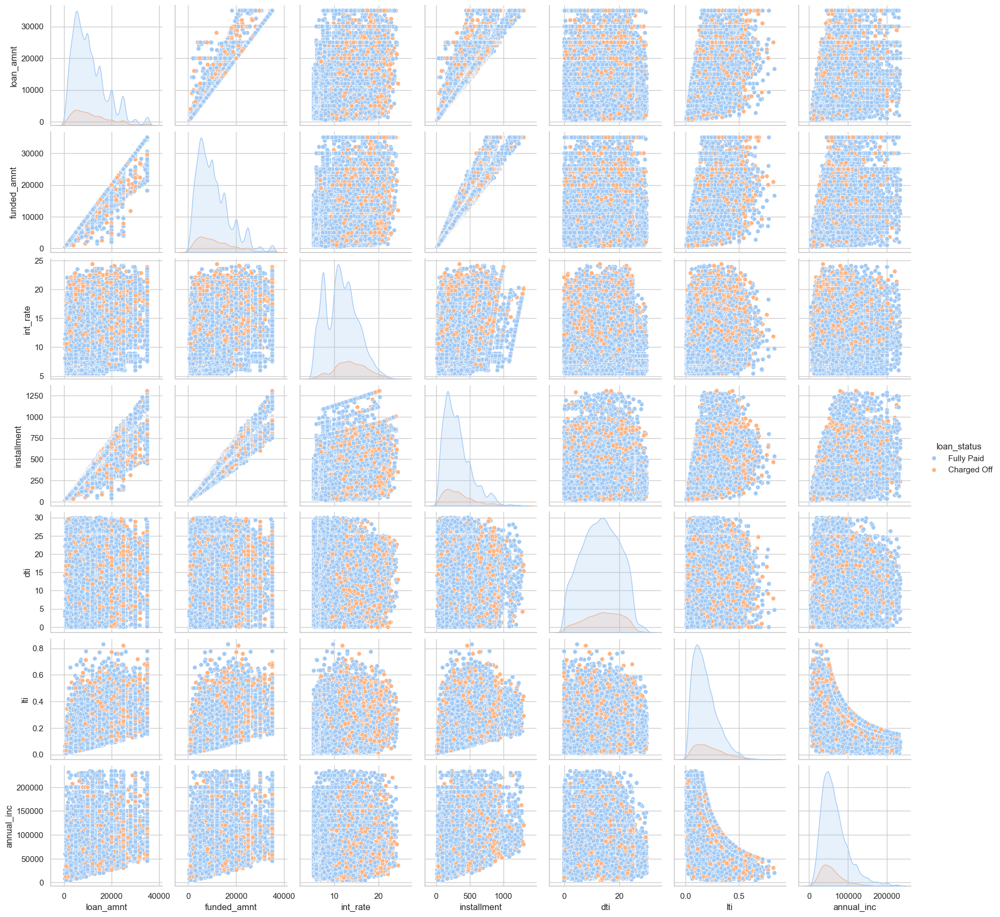

In [327]:
# Create a pairplot
sns.pairplot(
    data=loan_df, 
    vars=numerical_columns,
    hue=target_column,
    diag_kind="kde"
)

plt.show()

In [328]:
# Plot separate scatterplots for all numerical column combinations as it is difficult to interpret from the pairplot

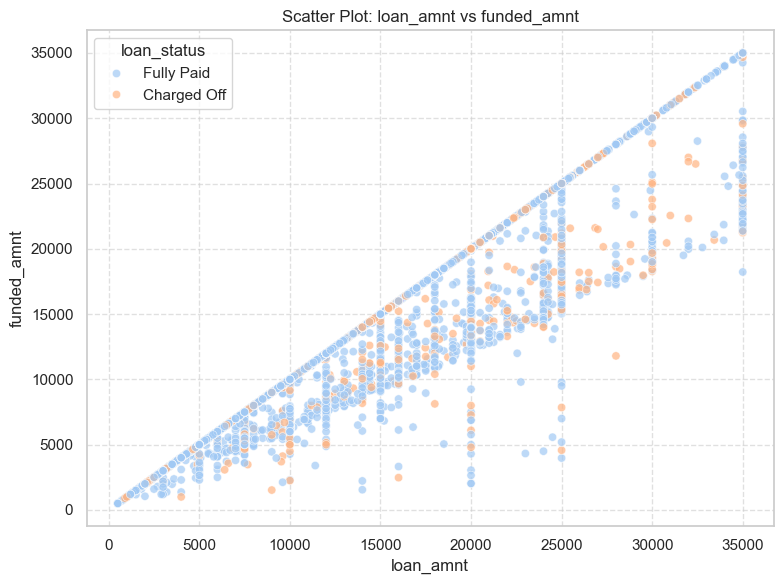

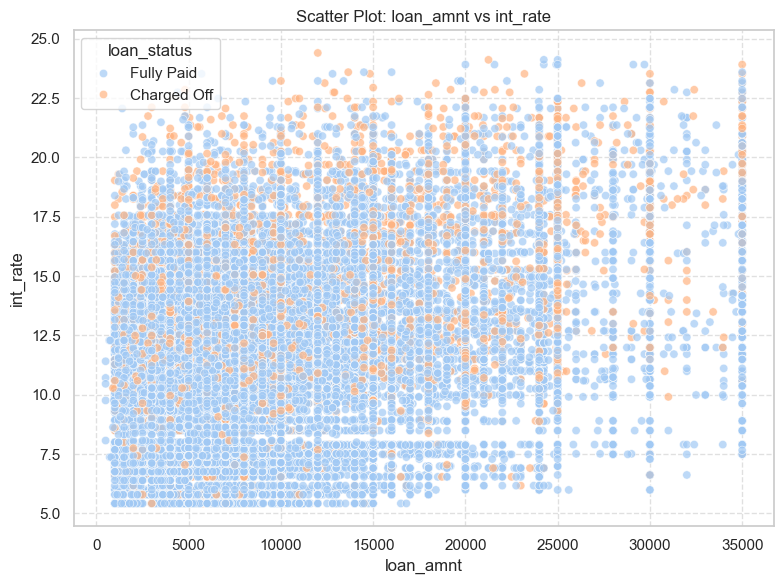

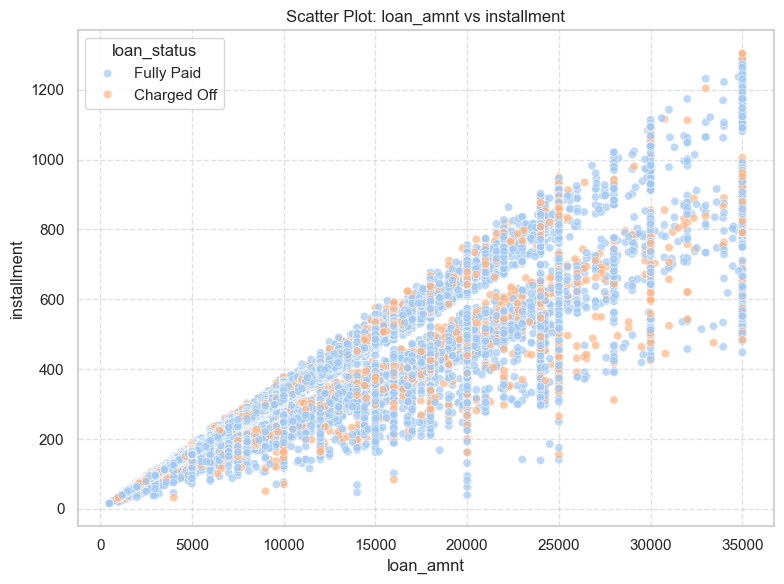

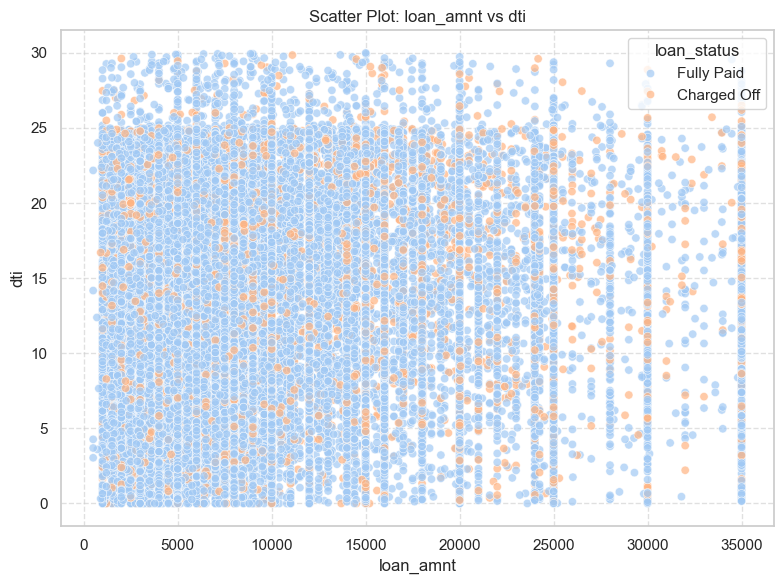

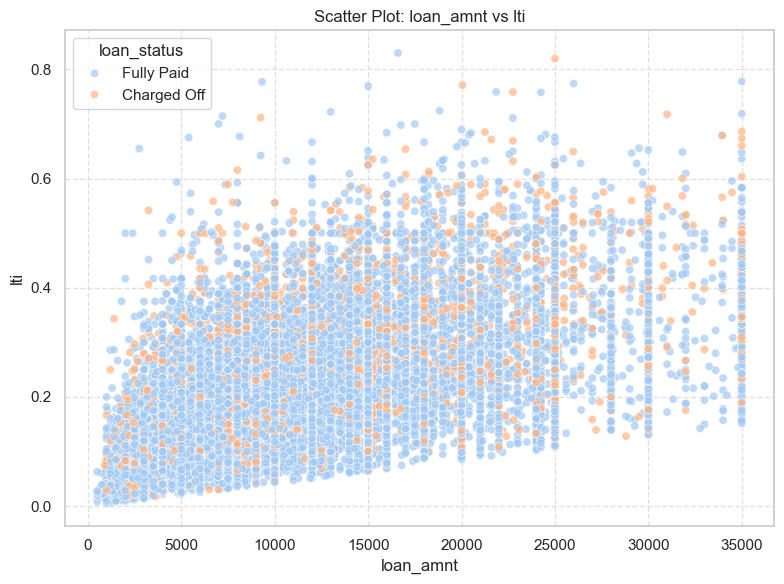

...

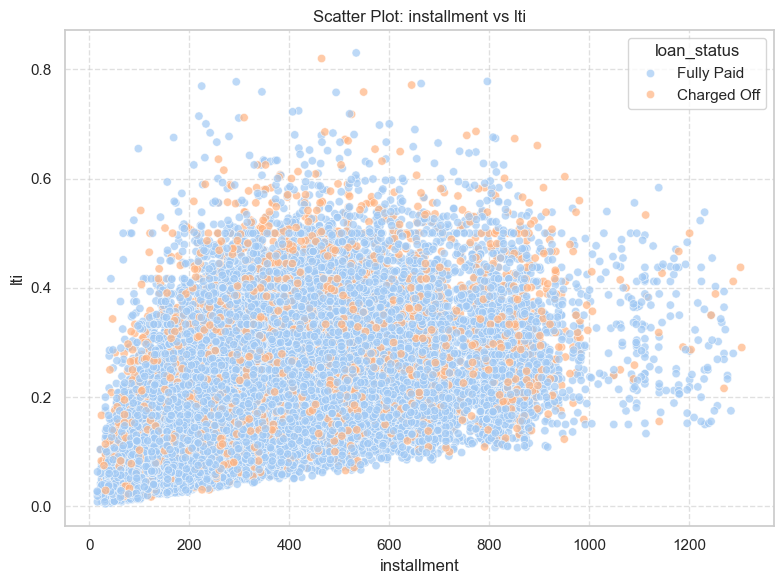

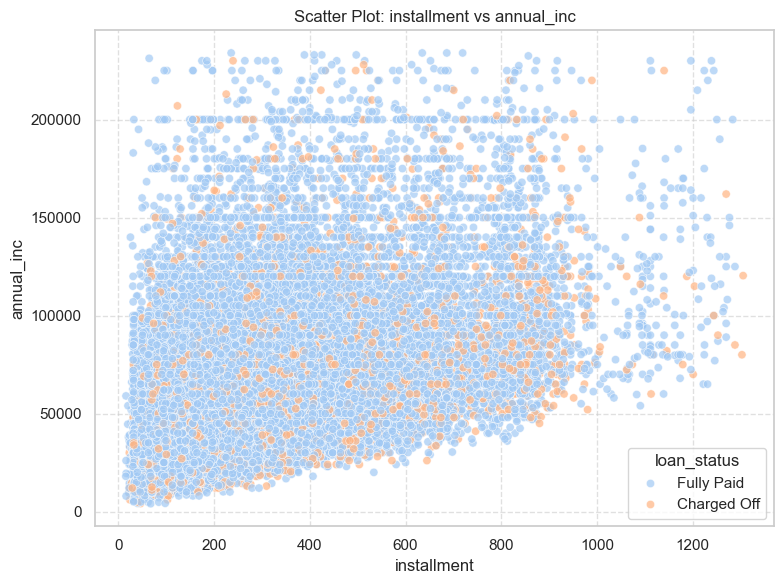

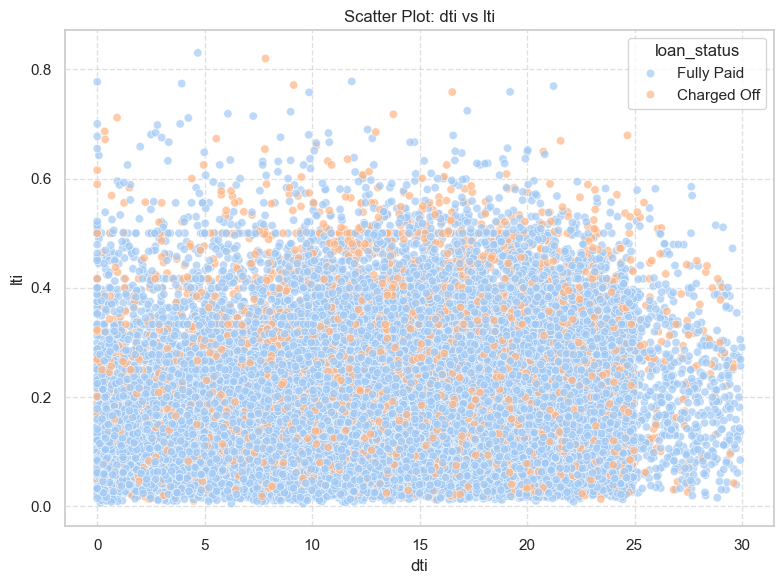

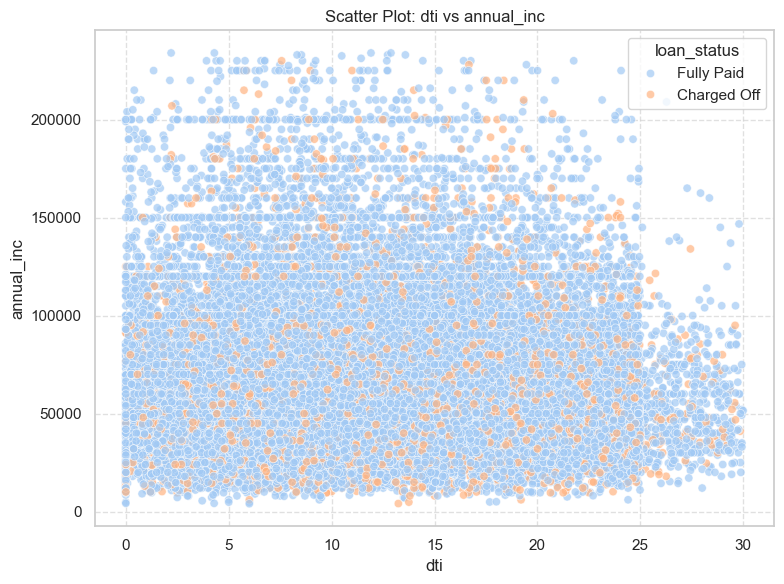

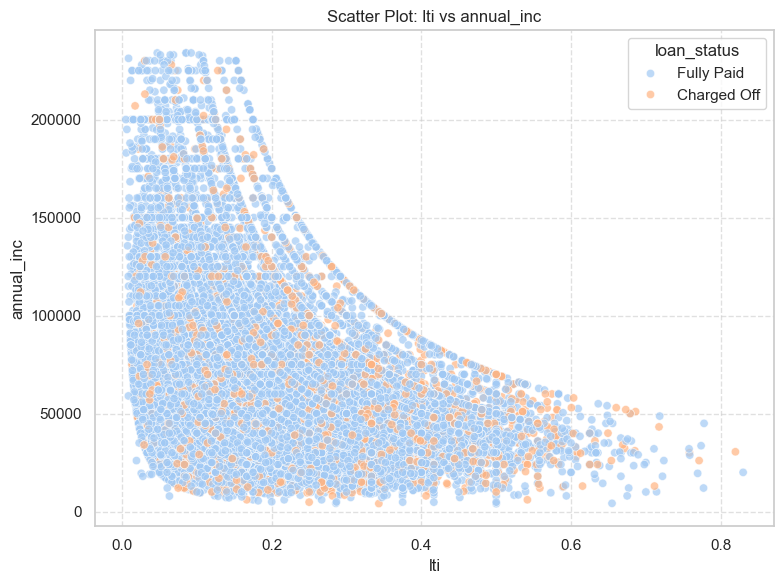

In [329]:
plot_scatter_combinations(loan_df, numerical_columns, target_column)

In [330]:
# Inference from scatter plots

# higher interest rates (int_rate) are associated with an increased density of charged-off loans (orange dots). 
# This suggests that higher interest rates contribute to a greater likelihood of default. 

# Charged-off loans (orange dots) are denser in the lower income range (below approximately $50,000) 
# when combined with higher interest rates (above 15%).

# The scatter plot indicates a higher concentration of orange dots (charged-off loans) at higher interest rates (int_rate) and 
# higher debt-to-income ratios (dti). This suggests that borrowers with higher interest rates and higher debt burdens are 
# more likely to default. Both "int_rate" and "dti" appear to be significant factors in assessing loan default risk.

# The relationship between lti (Loan-to-Income ratio) and annual_inc shows that higher lti values (closer to 0.6–0.8) have a 
# slightly increased density of charged-off loans (orange dots). 
# This suggests a potential association where borrowers with higher loan-to-income ratios may face a greater risk of default.

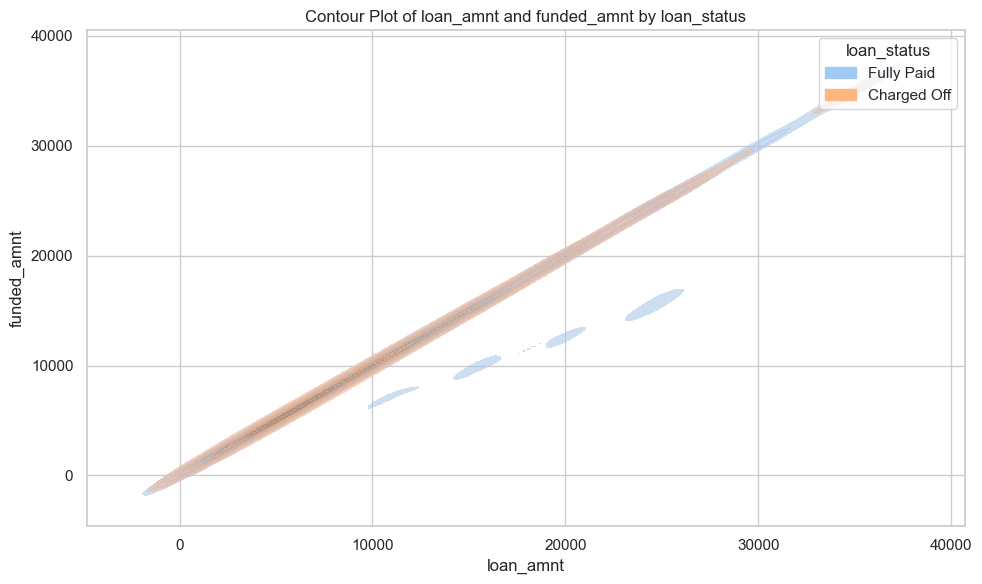

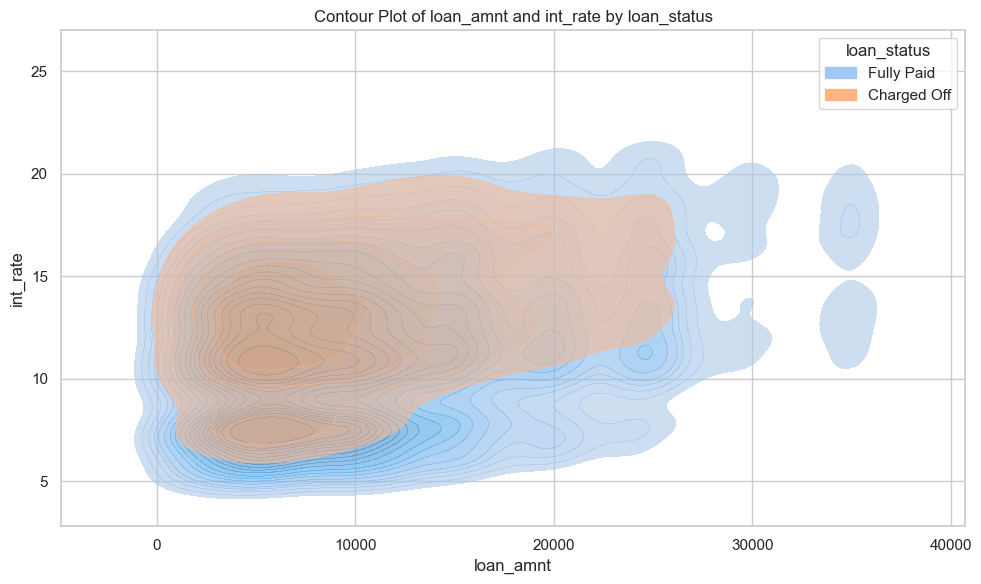

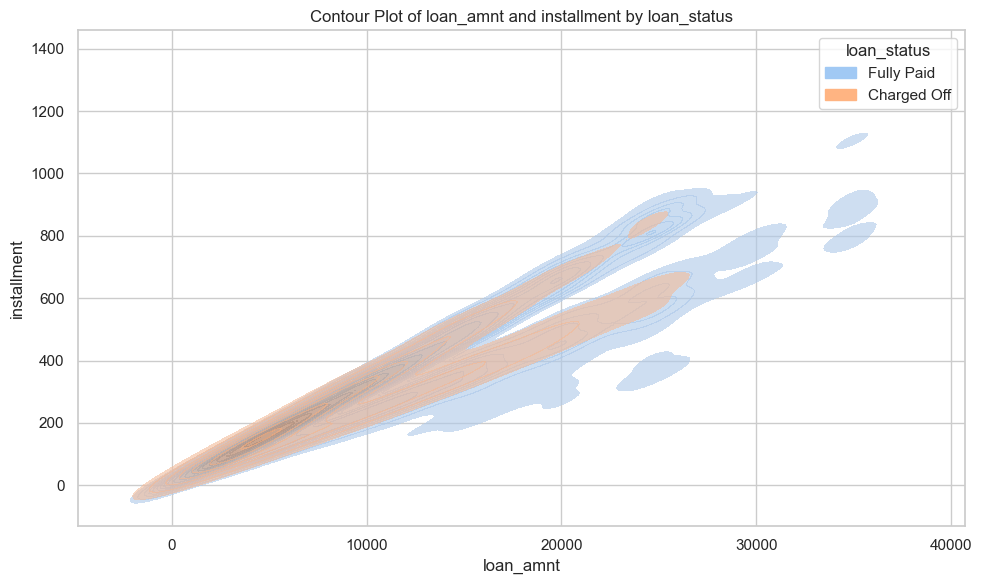

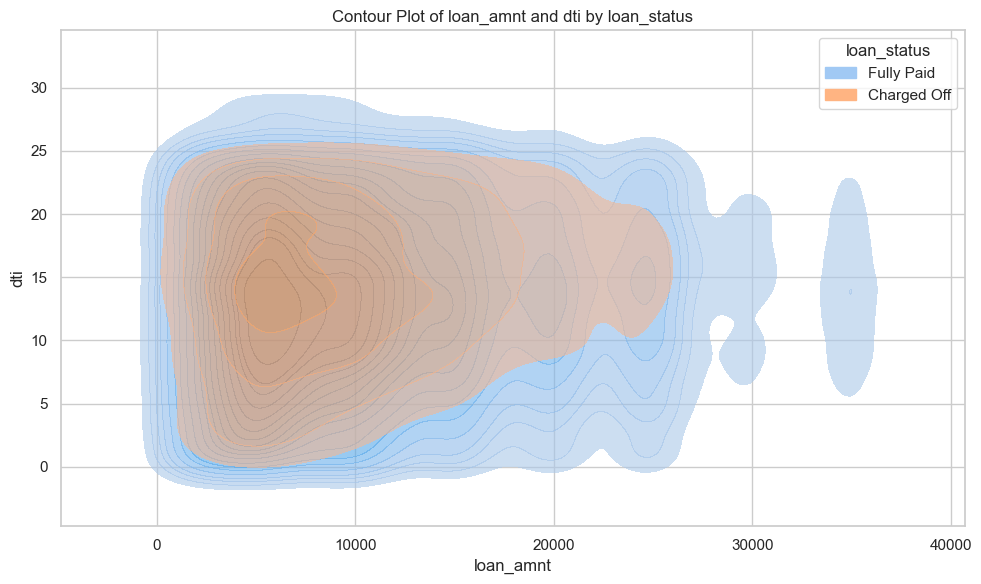

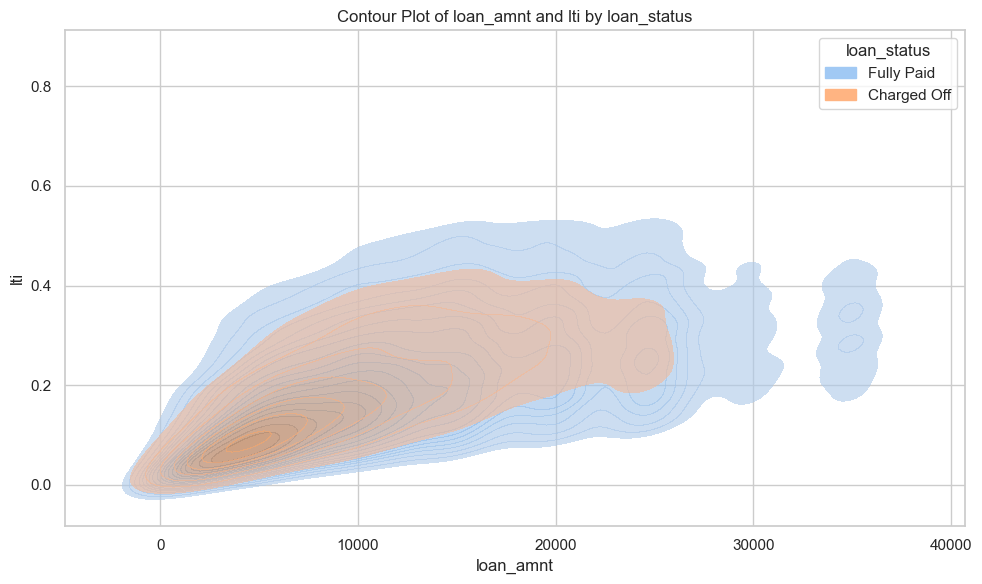

...

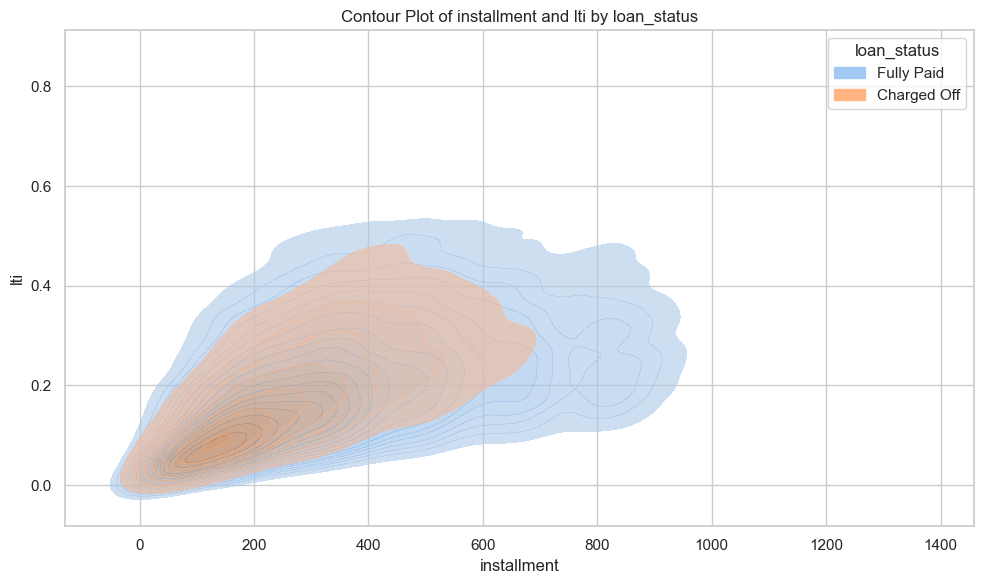

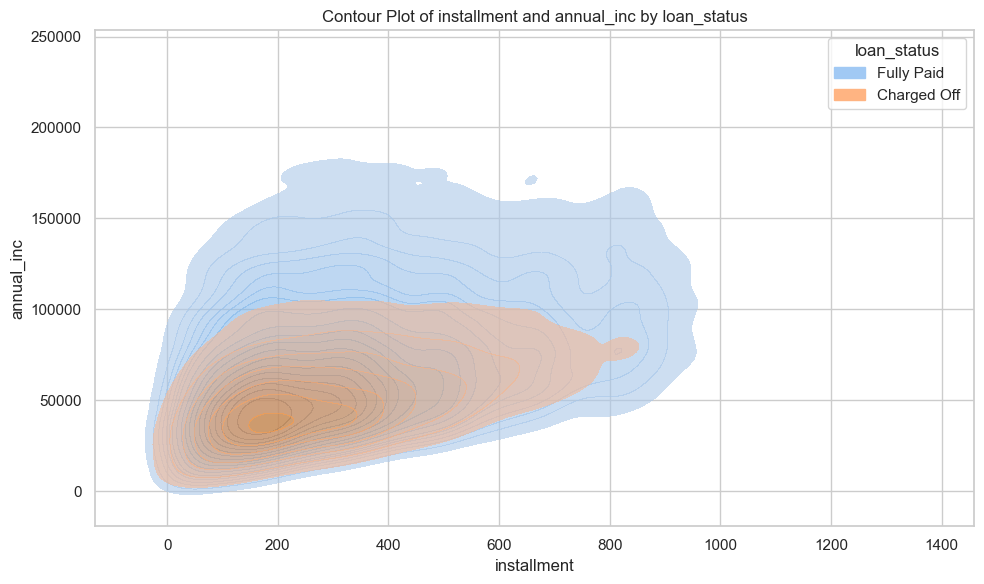

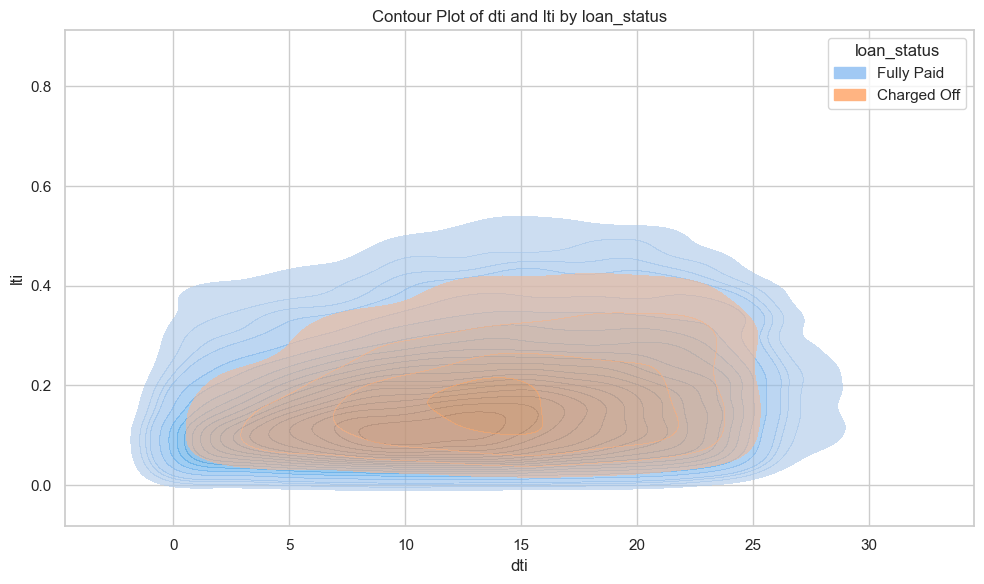

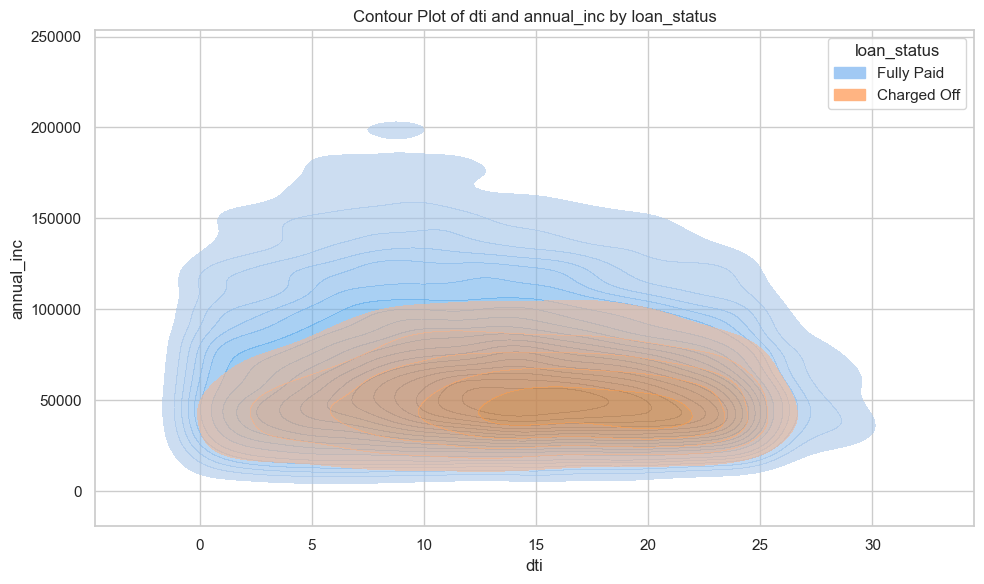

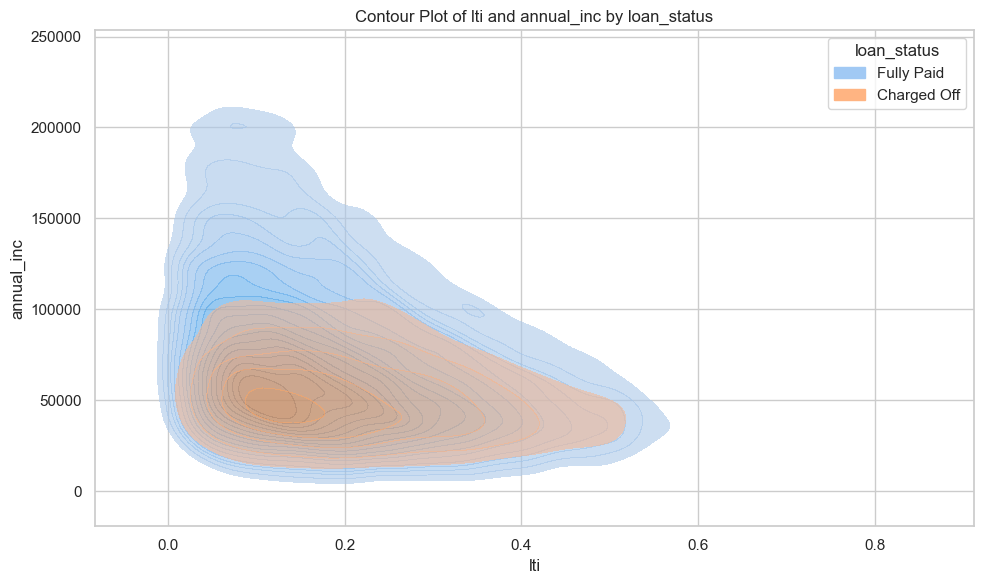

In [331]:
# Plot contour plots and analyze patterns
plot_contour_combinations(loan_df, numerical_columns, target_column)

In [332]:
# Inference

# annual_inc by loan_amnt
# Lower incomes (< $60,000)are more densely concentrated within the Charged Off group, 
# suggesting a higher likelihood of default in this segment.
# There are very few, if any, defaulted loans among borrowers with both high incomes and high loan amounts, 
# indicating that this group is at a significantly lower risk of default.


# annual_inc by int_rate
# Higher interest rates and lower incomes are strong indicators of default risk.
# Borrowers with high annual incomes are more likely to repay loans successfully, even at higher interest rates.
# The combination of low income and high interest rates is a critical risk factor for defaults.

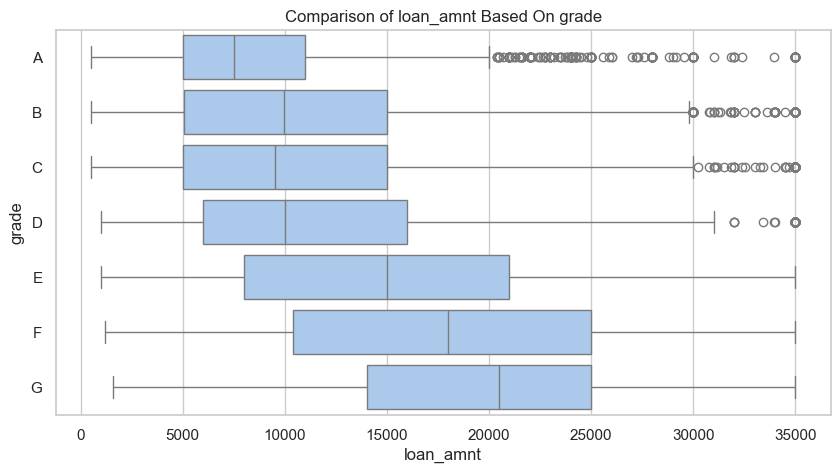

In [333]:
plot_boxplot(loan_df,'loan_amnt','grade')

In [334]:
# Inference
# Borrowers with higher grades (A, B, C) generally take smaller loans, with median loan amounts increasing as the grade decreases
# Borrowers with lower grades (E, F, G) tend to take larger loans, as indicated by the higher medians and wider interquartile ranges (IQR).
# But higher grades (e.g., A, B, C) have more outliers, typically representing borrowers who took unusually large loans for their grade.


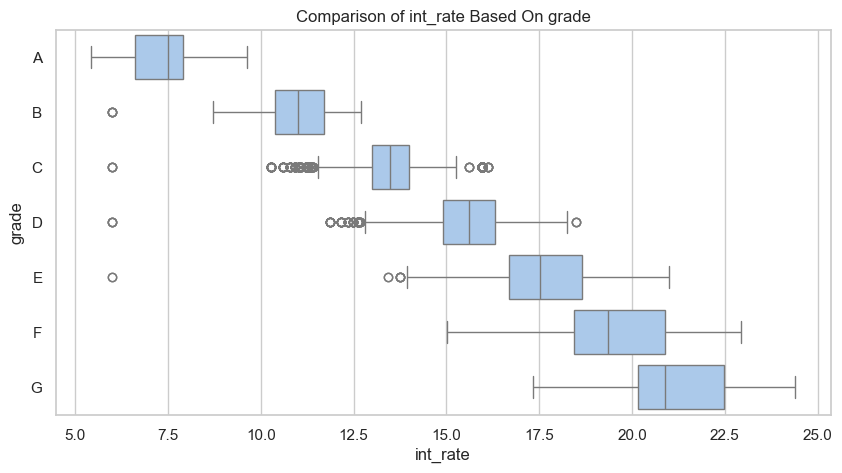

In [335]:
plot_boxplot(loan_df,'int_rate','grade')

In [336]:
# Inference
# As the grade decreases (moving from A to G), the median interest rate increases consistently, 
# indicating that lower grades are associated with higher interest rates due to increased credit risk.

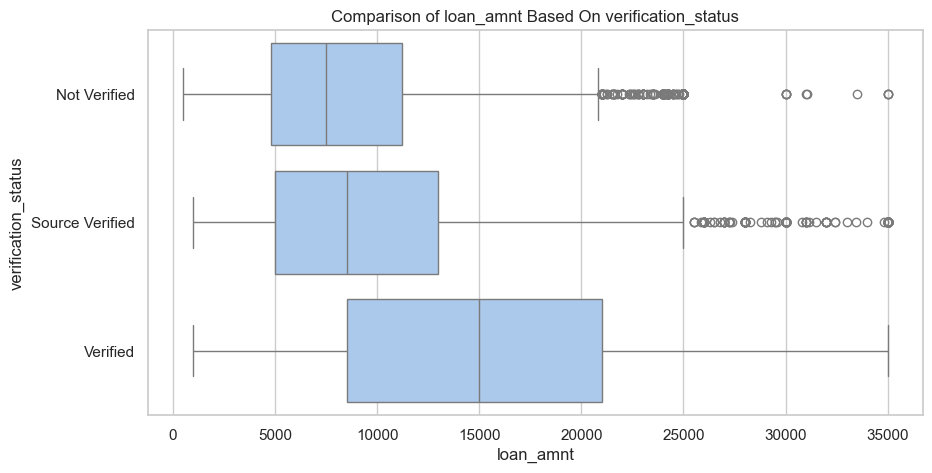

In [337]:
plot_boxplot(loan_df,'loan_amnt','verification_status')

In [338]:
# Inference
# Borrowers with a Verified status have the highest median loan amount.
# Verified borrowers show the widest range of loan amounts, indicating higher variability in the amounts approved for verified borrowers.
# Outliers are most frequent in the "Not Verified" and "Source Verified" categories, especially for larger loan amounts (above $30,000).


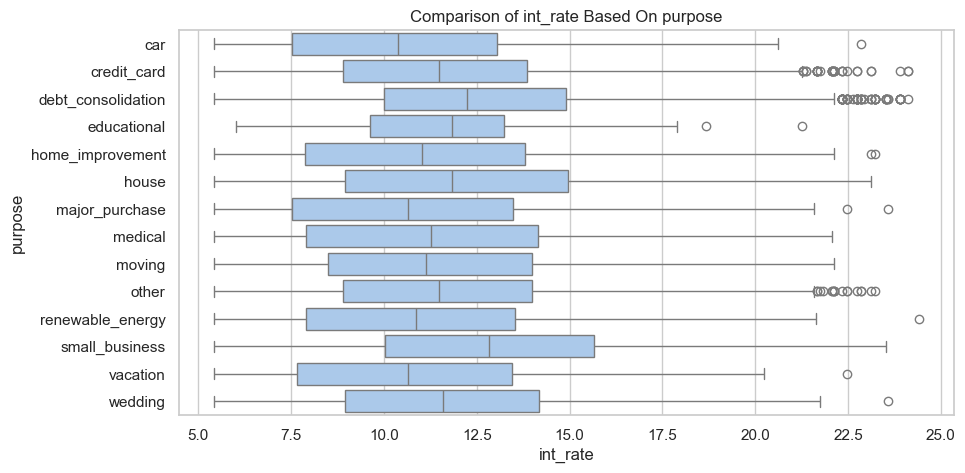

In [339]:
plot_boxplot(loan_df,'int_rate','purpose')

In [340]:
# Inference
# Interest rates vary significantly based on loan purpose
# Small Business loans tend to have the highest median interest rate, indicating they are perceived as higher risk.
# Outliers are present across many purposes, especially for categories like Credit Card, Debt Consolidation, and Home Improvement, 
# indicating some borrowers are assigned exceptionally high or low interest rates compared to others in the same purpose category.



In [341]:
# Pairwise plot of public bankruptcies reported vs annual income

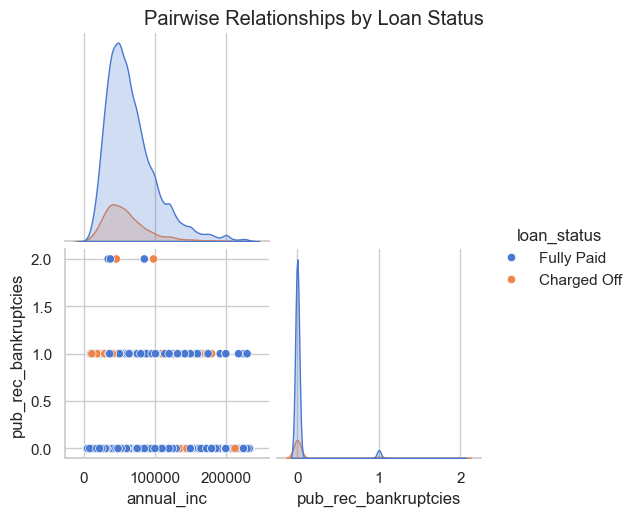

In [342]:
sns.pairplot(
    loan_df,
    vars=['annual_inc', 'pub_rec_bankruptcies'],
    hue='loan_status',
    palette='muted',
    diag_kind='kde',
    corner=True
)
plt.suptitle('Pairwise Relationships by Loan Status', y=1.02)
plt.show()

In [343]:
# Inference
# There are very few borrowers with more than 1 public record bankruptcy.
# Charged-off loans (orange points) are more common among borrowers with lower annual incomes and at least 1 public record bankruptcy.


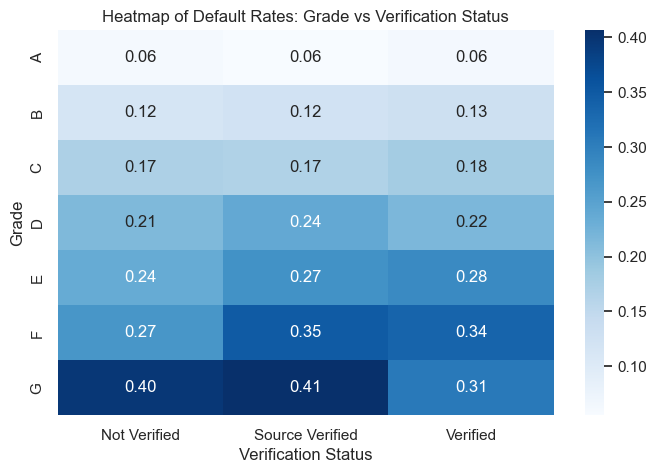

In [344]:
# pivot table for grade and verification status
plt.figure(figsize=(8, 5))
heatmap_data = loan_df.pivot_table(
    index="grade", 
    columns="verification_status", 
    values="default_status_binary", 
    aggfunc="mean"
)

sns.heatmap(
    heatmap_data, 
    annot=True, 
    cmap="Blues", 
    fmt=".2f"
)


plt.title("Heatmap of Default Rates: Grade vs Verification Status")
plt.xlabel("Verification Status")
plt.ylabel("Grade")
plt.show()

In [345]:
# Inference
# Default rates are uniformly low (~6%) across all verification statuses for Grade A, 
# indicating verification has little effect for high-creditworthy borrowers.

# For Grade F, the default rate is 27% for Not Verified but rises to 35% for Source Verified and 34% for verified, 
# indicating inconsistencies in risk management across verification levels.


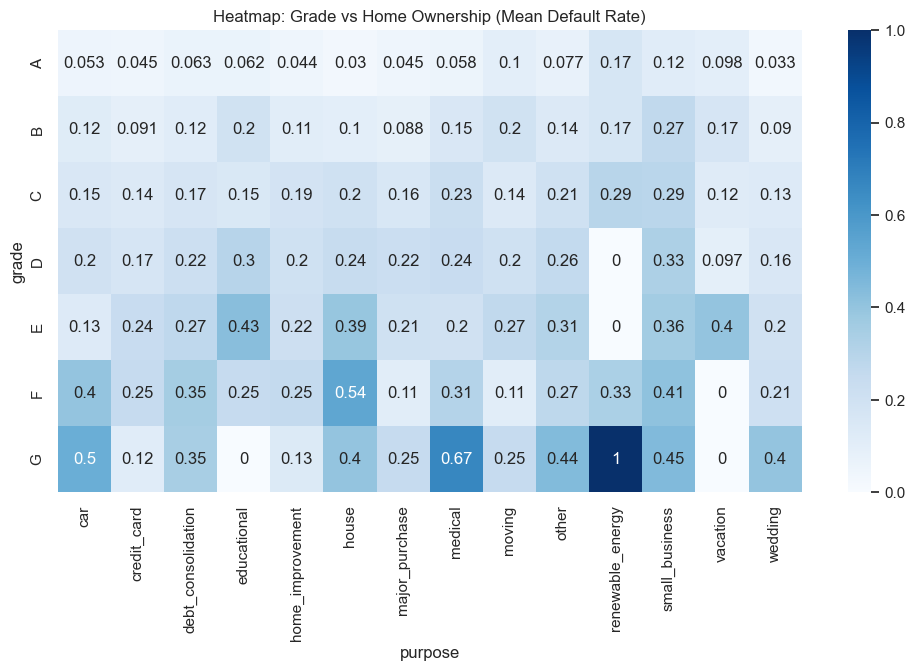

In [346]:
# Pivot table and heatmap - grade and home ownership
plt.figure(figsize=(12, 6))
heatmap_data = loan_df.pivot_table(
    values="default_status_binary", 
    index="grade", 
    columns="purpose", 
    aggfunc="mean"
)

# Plot heatmap
sns.heatmap(heatmap_data, annot=True, cmap="Blues", cbar=True)
plt.title("Heatmap: Grade vs Home Ownership (Mean Default Rate)")
plt.show()


In [347]:
# Renewable Energy loans have the highest default rates across multiple grades, with Grade G 
# reaching a default rate of 100% and Grade F at 54%. 
# This indicates an exceptionally high risk for loans in this category.
                                                                                             
# Medical,house and moving purposes also exhibit relatively high default rates, especially for Grades E and F


In [348]:
# Pivot table and heatmap - purpose and emp_length

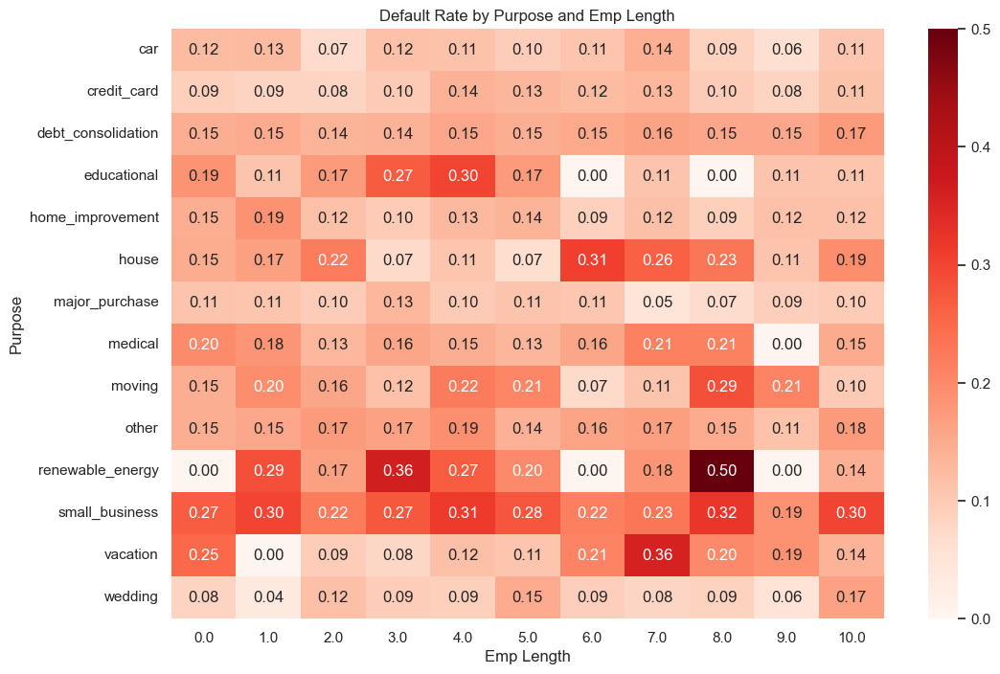

In [349]:
# Crosstab for default rates
default_rate_crosstab = loan_df.pivot_table(index='purpose', columns='emp_length', values='default_status_binary', aggfunc='mean')

# Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(default_rate_crosstab, annot=True, cmap='Reds', fmt='.2f')
plt.title('Default Rate by Purpose and Emp Length')
plt.ylabel('Purpose')
plt.xlabel('Emp Length')
plt.show()


In [350]:
# There is no strong or consistent pattern between employment length and default rate across all purposes. 
# However, Small Business and Renewable Energy loans remain high-risk categories


In [351]:
#Loan Size Category vs Verification Status

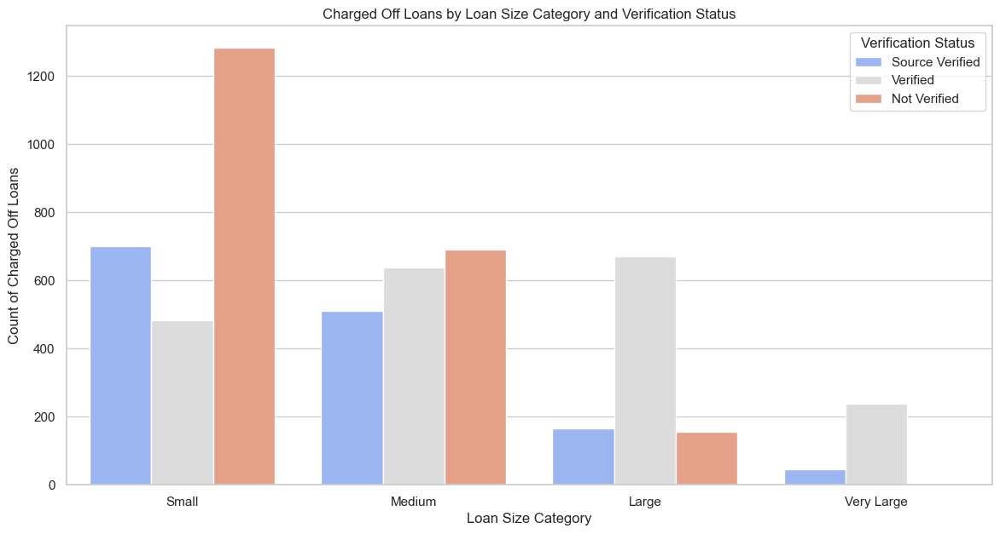

In [352]:
# Add verification status as a hue to the grouped bar plot
plt.figure(figsize=(14, 7))
sns.countplot(
    x='loan_size_category', 
    hue='verification_status', 
    data=loan_df[loan_df['loan_status'] == 'Charged Off'],  # Focus only on defaults
    palette='coolwarm'
)
plt.title('Charged Off Loans by Loan Size Category and Verification Status')
plt.xlabel('Loan Size Category')
plt.ylabel('Count of Charged Off Loans')
plt.legend(title='Verification Status')
plt.show()




In [353]:
# Inference
# Under small loans, the charge off count is high for non verified loans

In [354]:
#Loan Size Category vs Verification Status

In [355]:
# Other optional explorations

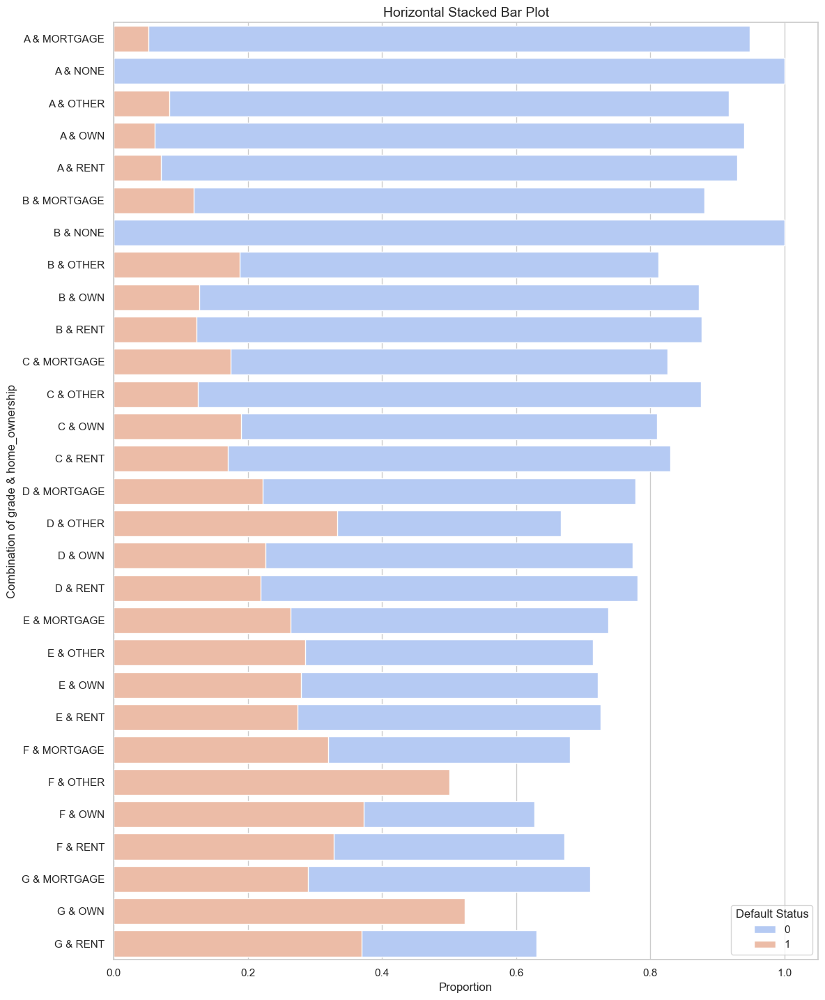

In [356]:
plot_cross_tab_stacked_bar(loan_df,['grade','home_ownership'],'default_status_binary')

## Multivariate Analysis

In [357]:
# Faceted Scatter Plots
def facet_scatterplot(df, col, hue, x_var, y_var, col_wrap=4, alpha=0.7, title=None):
    """
    Creates a FacetGrid scatter plot for visualizing relationships across multiple subsets.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        col (str): The column to create facets (subplots) based on unique values.
        hue (str): The column to color the points by (categorical variable).
        x_var (str): The x-axis variable.
        y_var (str): The y-axis variable.
        col_wrap (int): Number of columns to wrap the subplots. Default is 4.
        alpha (float): Transparency level for points. Default is 0.7.
        title (str): The overall title for the plot. Default is None.
    """
    g = sns.FacetGrid(df, col=col, hue=hue, col_wrap=col_wrap)
    g.map(sns.scatterplot, x_var, y_var, alpha=alpha)
    g.add_legend()
    
    if title:
        plt.subplots_adjust(top=0.9)  # Adjust title position
        g.fig.suptitle(title)
    
    plt.show()


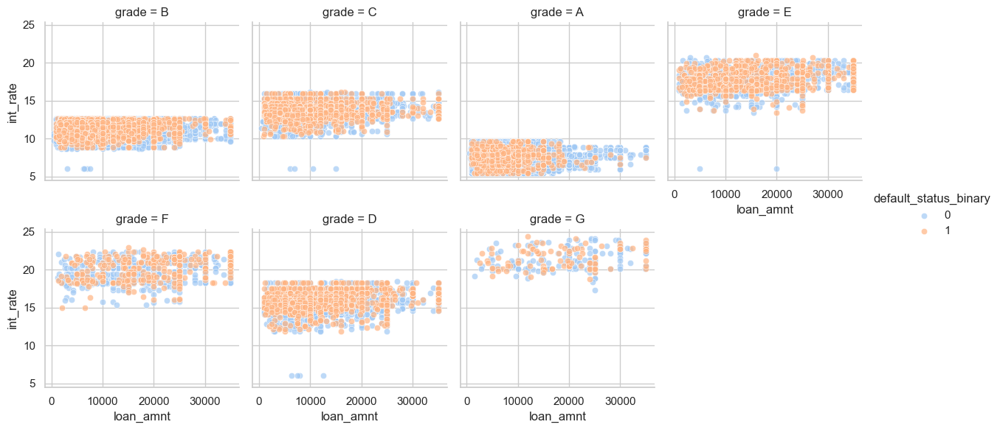

In [358]:
facet_scatterplot(loan_df,"grade","default_status_binary","loan_amnt", "int_rate")

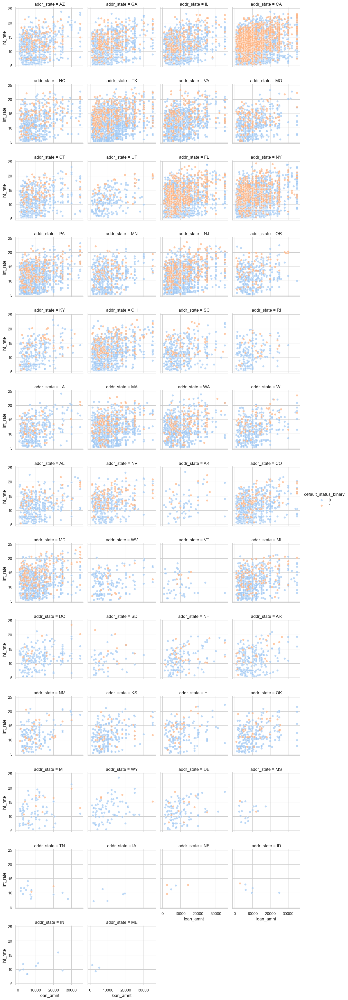

In [359]:
facet_scatterplot(loan_df,"addr_state","default_status_binary","loan_amnt", "int_rate")

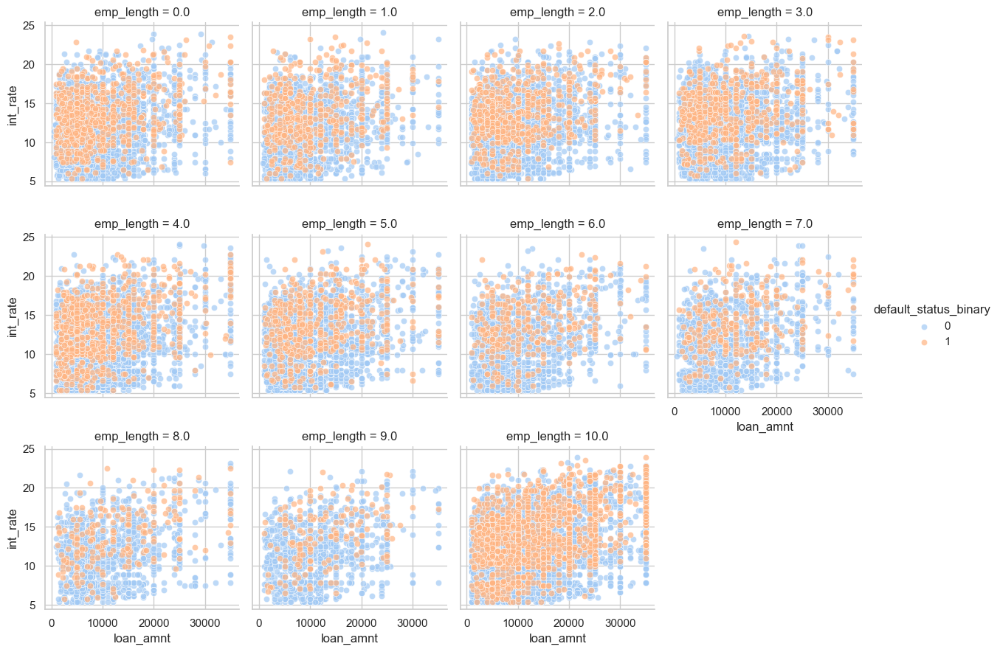

In [360]:
facet_scatterplot(loan_df,"emp_length","default_status_binary","loan_amnt", "int_rate")

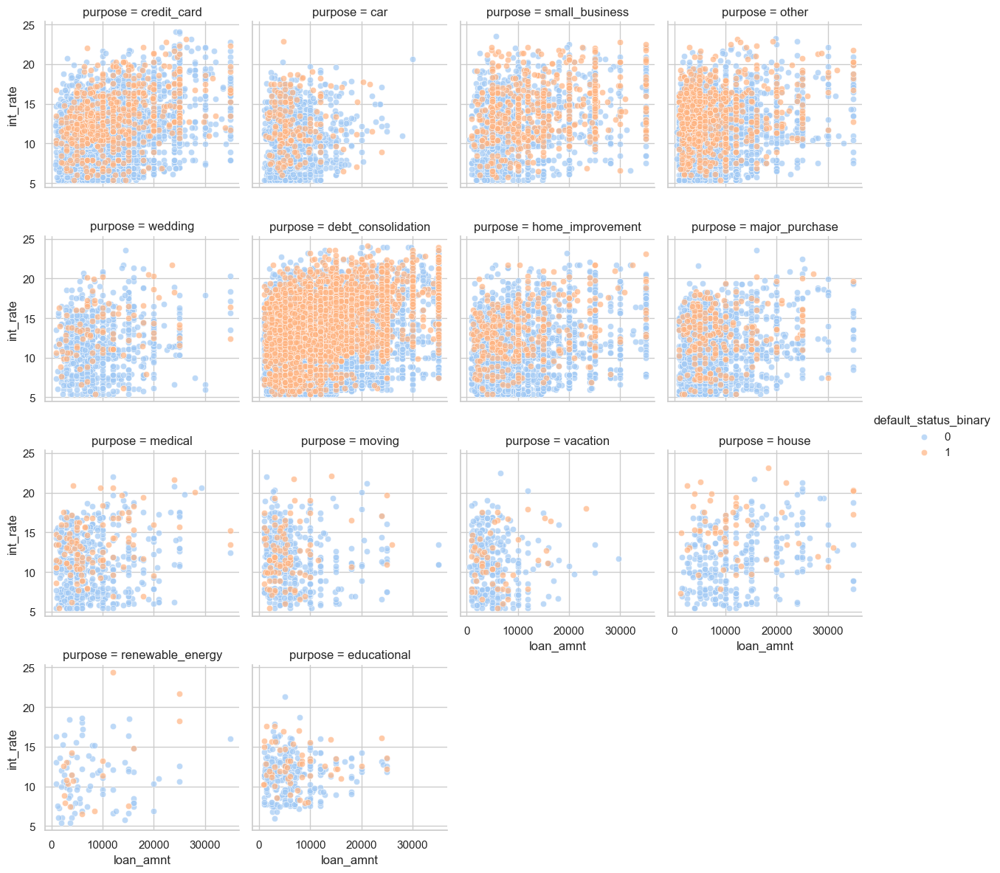

In [361]:
facet_scatterplot(loan_df,"purpose","default_status_binary","loan_amnt", "int_rate")